# Libraries, figure parameters and custom functions

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import anndata as ann
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from matplotlib import rcParams
#from gprofiler import gprofiler
import os
#import custom_functions as cf 
from sklearn.linear_model import LinearRegression

Add date.

In [2]:
from datetime import date

In [3]:
today = date.today().strftime("%y%m%d")

Add my color scheme.

In [4]:
colors2 = plt.cm.RdYlBu_r(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(0.7)
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [5]:
sc.settings.fig_dir='./../figures/'

Set parameters for plots in scanpy

In [6]:
sc.settings.set_figure_params(dpi=80)

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map='viridis', format='pdf', transparent=False,
                     ipython_format='png2x')

In [7]:
def cell_compo_table(adata, cluster, condition, xlabel='cell cluster',
                        ylabel='cell count', title=None, save=False):
    """
    """
    

    contingency_table = pd.crosstab(
        adata.obs[condition],
        adata.obs[cluster],
        margins = True
    )
    return(contingency_table)

def top_marker_as_xlsx(adata, 
                       gene_symbols = None,
                       key_rank_genes = 'rank_genes_groups', 
                       key_groups = 'leiden', 
                       #output_file = 'tmp.csv'
                      ):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    del dict_genes['params']
    clusters = sorted(list(set(adata.obs[key_groups])))*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters

    dataframe = pd.DataFrame(dict_genes)
    dataframe.set_index('names', inplace=True)
    if gene_symbols is not None:
        dataframe.insert(0, gene_symbols, adata.var[gene_symbols])
    
    #dataframe.to_csv(output_file)
    return(dataframe)

# Load data

In [8]:
project_dir = '/lustre/groups/ml01/workspace/maren.buettner/Martinez_Liver_HPC/'

In [9]:
data_dir = project_dir + 'data/'

In [10]:
table_dir = project_dir + 'tables/'

In [11]:
adata_wt_young = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_cells_filtered_TPM_mar21_annotated.h5ad')
adata_wt_old = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_cells_filtered_TPM_mar21_annotated.h5ad')

In [12]:
adata_young_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_HNF4-KO_filtered_TPM_mar21_annotated.h5ad')
adata_old_HNF4 = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_HNF4-KO_filtered_TPM_mar21_annotated.h5ad')
adata_young_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CTCF-KO_filtered_TPM_mar21_annotated.h5ad')
adata_old_CTCF = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CTCF-KO_filtered_TPM_mar21_annotated.h5ad' )
adata_young_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_young_CEBPA-KO_filtered_TPM_mar21_annotated.h5ad')
adata_old_CEBPA = sc.read(data_dir + 'snRNAseq_mouse_hepatocytes_old_CEBPA-KO_filtered_TPM_mar21_annotated.h5ad')

We merge `adata_young` and `adata_old` in order to use the separately created cell type annotation.

In [13]:
adata_all = ann.concat([adata_wt_young, adata_wt_old, 
                        adata_young_HNF4, adata_old_HNF4,
                        adata_young_CTCF, adata_old_CTCF,
                        adata_young_CEBPA, adata_old_CEBPA,
                       ], index_unique=None)

In [14]:
adata_all.uns = adata_wt_young.uns
adata_all.varm = adata_wt_young.varm
adata_all.var['gene_name'] = adata_wt_young.var['gene_name']

Add covariate combining age and ploidy.

In [15]:
age_ploidy = [adata_all.obs['age_grouped'][idx] + ' ' + adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [16]:
adata_all.obs['age_ploidy'] = pd.Categorical(age_ploidy, categories=['young 2n', 'young 4n', 'old 2n', 'old 4n'])

Add strain information to the age and ploidy covariate.

In [17]:
strain_age_ploidy = [adata_all.obs['strain'][idx] + ' ' + 
                     adata_all.obs['age_grouped'][idx] + ' ' + 
                     adata_all.obs['ploidy'][idx] for idx in range(adata_all.n_obs)]

In [18]:
adata_all.obs['strain_age_ploidy'] = pd.Categorical(strain_age_ploidy, 
                                categories=['C57Bl6/J young 2n', 'C57Bl6/J young 4n', 
                                            'C57Bl6/J old 2n', 'C57Bl6/J old 4n',
                                            'HNF4 KO young 2n', 'HNF4 KO young 4n', 
                                            'HNF4 KO old 2n', 'HNF4 KO old 4n',
                                            'CEBPA KO young 2n', 'CEBPA KO young 4n', 
                                            'CEBPA KO old 2n', 'CEBPA KO old 4n',
                                            'CTCF KO young 2n', 'CTCF KO young 4n', 
                                            'CTCF KO old 2n', 'CTCF KO old 4n'
                                           ])

Add strain and age info as covariate.

In [19]:
strain_age = [adata_all.obs['strain'][idx] + ' ' + 
              adata_all.obs['age_grouped'][idx] for idx in range(adata_all.n_obs)]

In [20]:
adata_all.obs['strain_age'] = pd.Categorical(strain_age, 
                                categories=['C57Bl6/J young', 
                                            'C57Bl6/J old', 
                                            'HNF4 KO young', 
                                            'HNF4 KO old',
                                            'CEBPA KO young',
                                            'CEBPA KO old',
                                            'CTCF KO young',
                                            'CTCF KO old', 
                                           ])

Edit the raw object to use the gene symbols for plotting (e.g. in `stacked_violin` plot).

In [21]:
adata_all.raw.var['gene_name'] = adata_wt_young.var['gene_name']

Read zonation marker gene list.

In [22]:
zonation_marker = pd.read_csv(table_dir + 'zonation_markers_new.txt')

In [23]:
zonation_marker.shape

(1239, 1)

Load list of fatty acid genes. 

In [24]:
fatty_acid = pd.read_table(table_dir + 'List_Pseudo_ordering_fatty acid.csv', sep=';', index_col=0)

In [25]:
fatty_acid[~np.in1d(fatty_acid.index, adata_all.var['gene_name'])]

,Annotation
Gene,
Rab51b,age
Lcnbate1,age
Mtln,lipid metab
Acss4,lipid metab
Cyp8a1,lipid metab
Apoa,lipid metab


In [26]:
fatty_acid_list = list(fatty_acid.index[np.in1d(fatty_acid.index, adata_all.var['gene_name'])].values)

In [27]:
fatty_acid_list = fatty_acid_list + ['Cyp8b1', 'Apoa1', 'Apoa4', 'Acss2', 'Parp1']

* 'Rab51b' does not exist. Clostest match "Rab5b"
* 'Lcnbate1' no match found
* 'Mtln' not expressed
* 'Acss4' not expressed, only 'Acss1/2/3' 
* 'Cyp8a1' not expressed, only 'Cyp8b1'
* 'Apoa' has the expressed genes 'Apoa1', 'Apoa2', 'Apoa4', 'Apoa5', which one should I use?

In [28]:
np.sort([gene for gene in adata_all.var['gene_name'] if gene.startswith("Parp")])

array(['Parp1', 'Parp10', 'Parp11', 'Parp12', 'Parp14', 'Parp16', 'Parp2',
       'Parp3', 'Parp4', 'Parp6', 'Parp8', 'Parp9', 'Parpbp'], dtype='<U6')

# Introduction

In this notebook, we perform a set of advanced analyses of the hepatocyte population. Due to the vast number of tasks that we perform on the hepatocyte data, we have distributed the analysis on several notebooks. Here, we look at the zonation patterns in the hepatocytes and potential changes upon ageing.

1. Zonation marker analysis (assign info based on the marker genes) using pseudotime

# Zonation analysis

In [29]:
adata_hep = adata_all[adata_all.obs['cell_type1']=='Hepatocytes'].copy()

In [30]:
adata_hep

AnnData object with n_obs × n_vars = 3951 × 30520
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Dendritic cell', 'score_Lymphocyte', 'score_Natural killer', 'score_Neutrophil', 'score_Kupffer and Macrophage', 'score_Cholangiocyte', 'score_Endothelial', 'score_Hepatocyte', 'score_Hepatoblast', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cell_t

Here, we use all hepatocytes and evaluate the marker genes for liver zonation.

Restrict to zonation markers.

In [31]:
zone_ID = np.in1d(adata_hep.var['gene_name'], zonation_marker['MouseGeneID'])

In [32]:
adata_hepz = adata_hep[:,zone_ID].copy()

In [33]:
adata_hepz

AnnData object with n_obs × n_vars = 3951 × 1036
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Dendritic cell', 'score_Lymphocyte', 'score_Natural killer', 'score_Neutrophil', 'score_Kupffer and Macrophage', 'score_Cholangiocyte', 'score_Endothelial', 'score_Hepatocyte', 'score_Hepatoblast', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age'
    var: 'gene_name'
    uns: 'ERCC.dilution_colors', 'age_colors', 'age_grouped_colors', 'cell_ty

Recompute visualisation.

In [34]:
sc.pp.pca(adata_hepz)
sc.pp.neighbors(adata_hepz)
sc.tl.tsne(adata_hepz, perplexity=30, n_pcs=15)

In [35]:
sc.tl.diffmap(adata_hepz)

Obtain top 10 liver zonation markers.

In [92]:
pericentral = ['Cyp2e1', 'Gsta3', 'Cyp27a1', 'Mup17']
periportal = ['Cyp2f2', 'Asl', 'Gls2'] #Alb not in zonation markers
non_zonated = ['Ces3a', 'Hamp', 'Cyp3a25'] #Hnf4a not in zonation markers

Create dictionary of zonated genes.

In [93]:
zonation_dict = {
    'pericentral' : pericentral,
    'non zonated' : non_zonated,
    'periportal' : periportal
}

... storing 'exp.' as categorical
... storing 'strain' as categorical
... storing 'age' as categorical
... storing 'sex' as categorical
... storing 'row' as categorical
... storing 'age_grouped' as categorical
... storing 'cyclone_phases' as categorical
... storing 'leiden_r1' as categorical
... storing 'leidenr02_02' as categorical


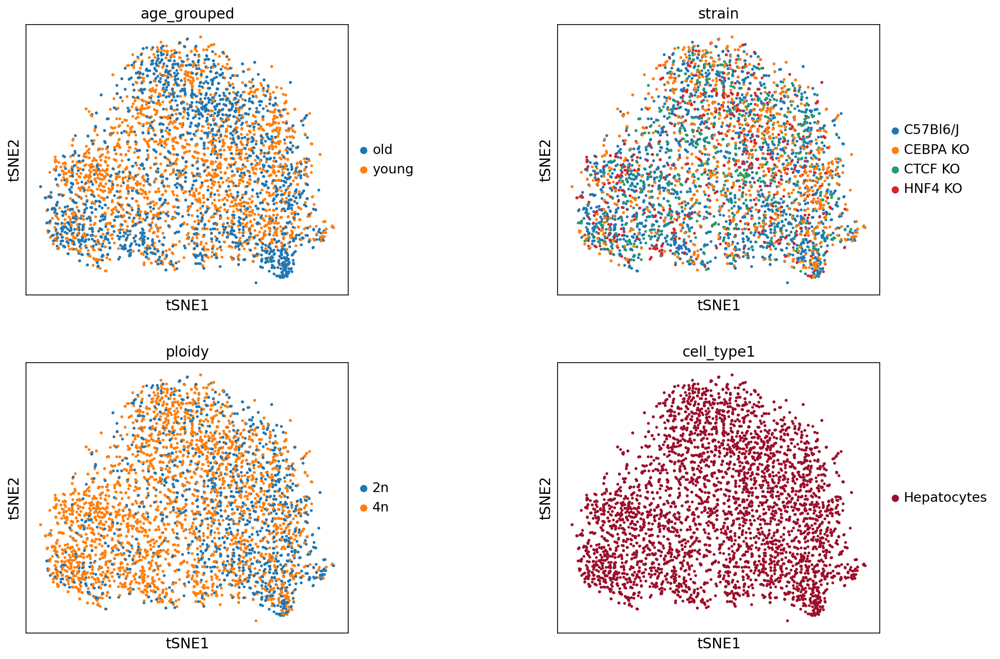

In [38]:
rcParams['figure.figsize']=(5,5)
sc.pl.tsne(adata_hepz, color=['age_grouped', 'strain','ploidy', 'cell_type1'], ncols=2, wspace=0.5)

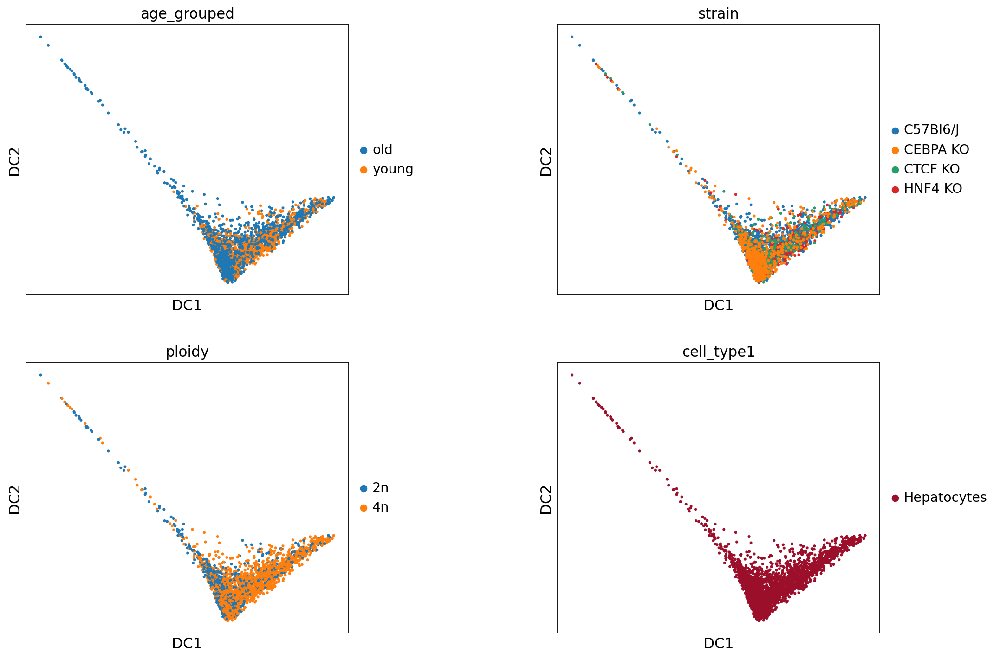

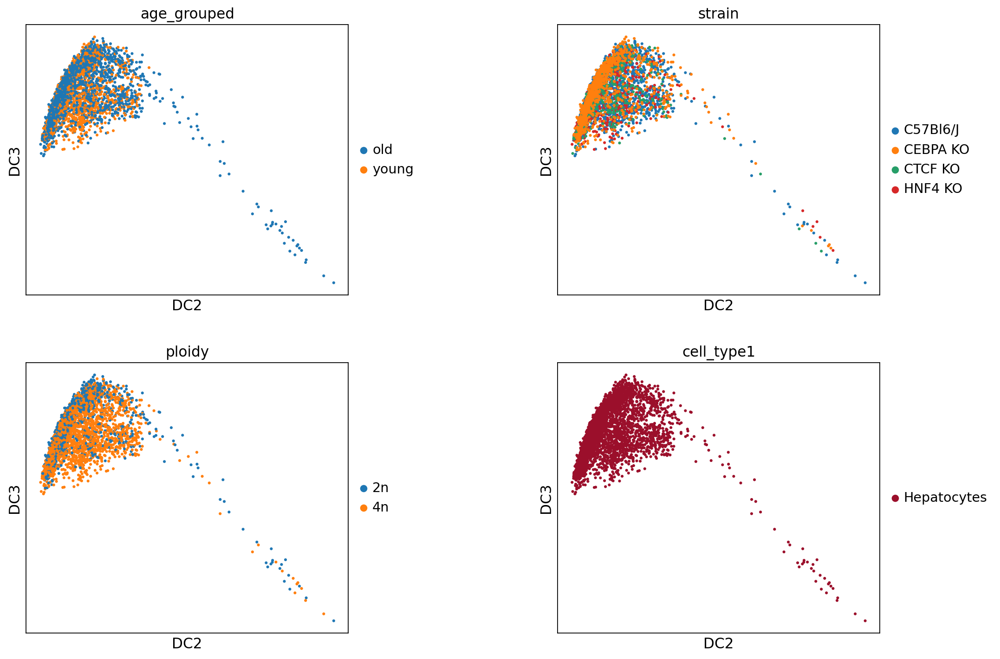

In [39]:
sc.pl.diffmap(adata_hepz, color=['age_grouped', 'strain','ploidy', 'cell_type1'], ncols=2, wspace=0.5, 
             # save='_'+today+'_zonation_hepatocytes_overview_DC12.pdf'
             )
sc.pl.diffmap(adata_hepz, color=['age_grouped', 'strain','ploidy', 'cell_type1'], 
              ncols=2, wspace=0.5, components=[2,3],
             # save='_'+today+'_zonation_hepatocytes_overview_DC23.pdf'
             )

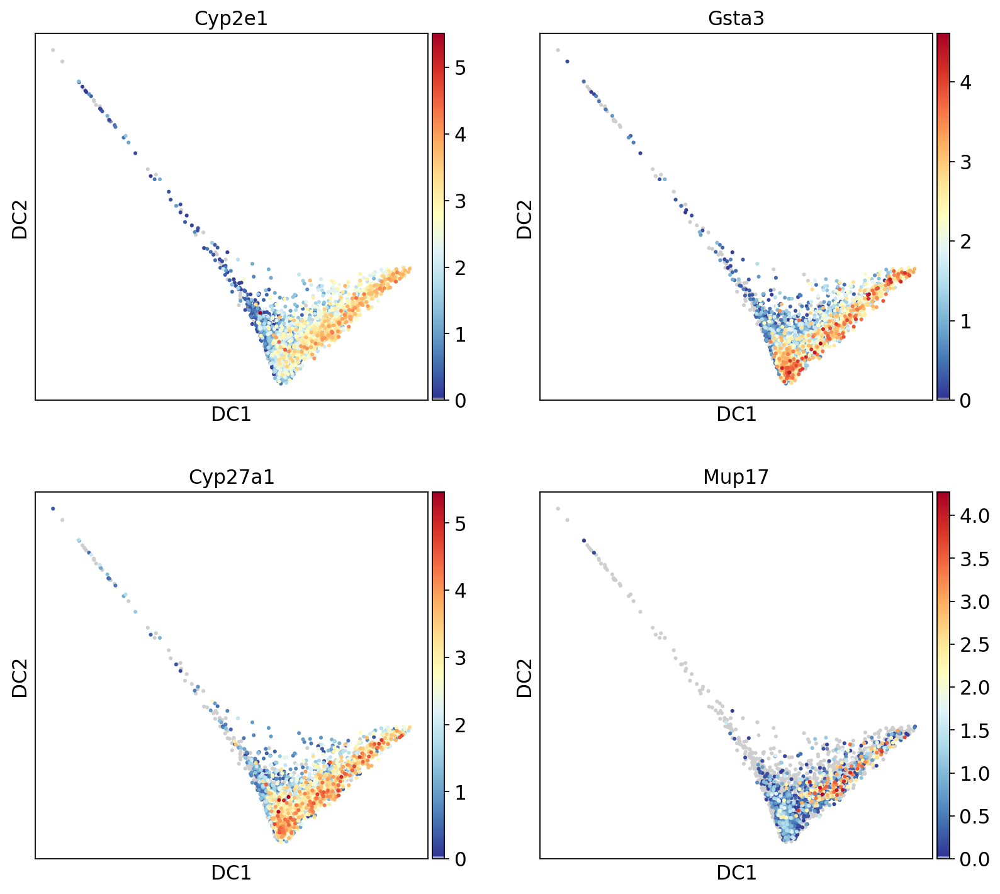

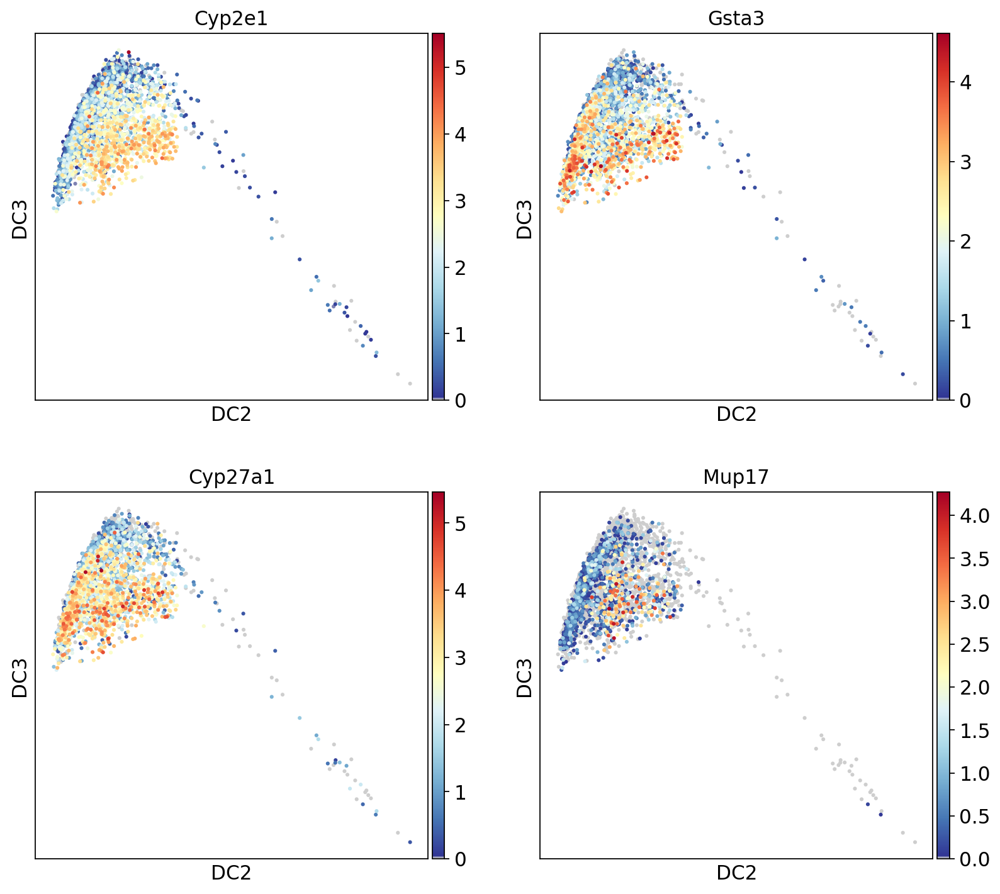

In [40]:
sc.pl.diffmap(adata_hepz, gene_symbols='gene_name', use_raw=True, 
              color=pericentral, ncols=2, color_map=mymap, 
              #save='_'+today+'_zonation_hepatocytes_pericentral_genes_DC12.pdf'
             )
sc.pl.diffmap(adata_hepz, gene_symbols='gene_name', use_raw=True, 
              color=pericentral, ncols=2, color_map=mymap, components=[2,3], 
             # save='_'+today+'_zonation_hepatocytes_pericentral_genes_DC23.pdf'
             )

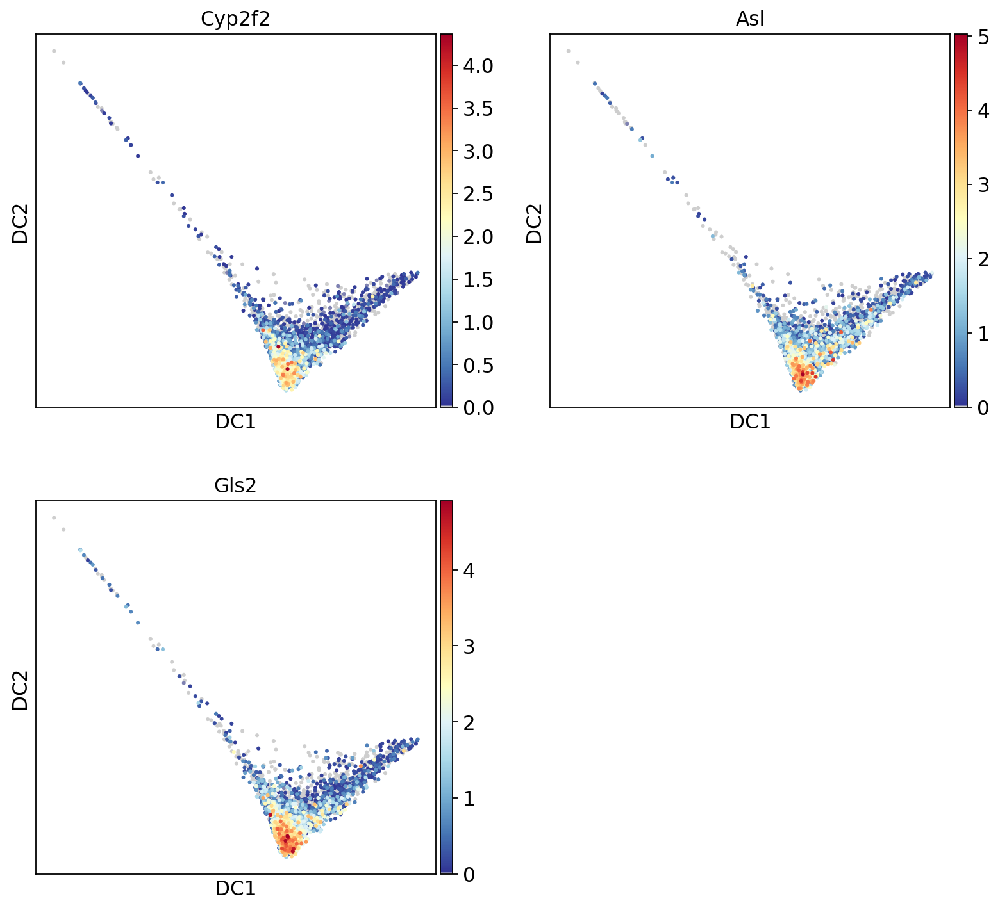

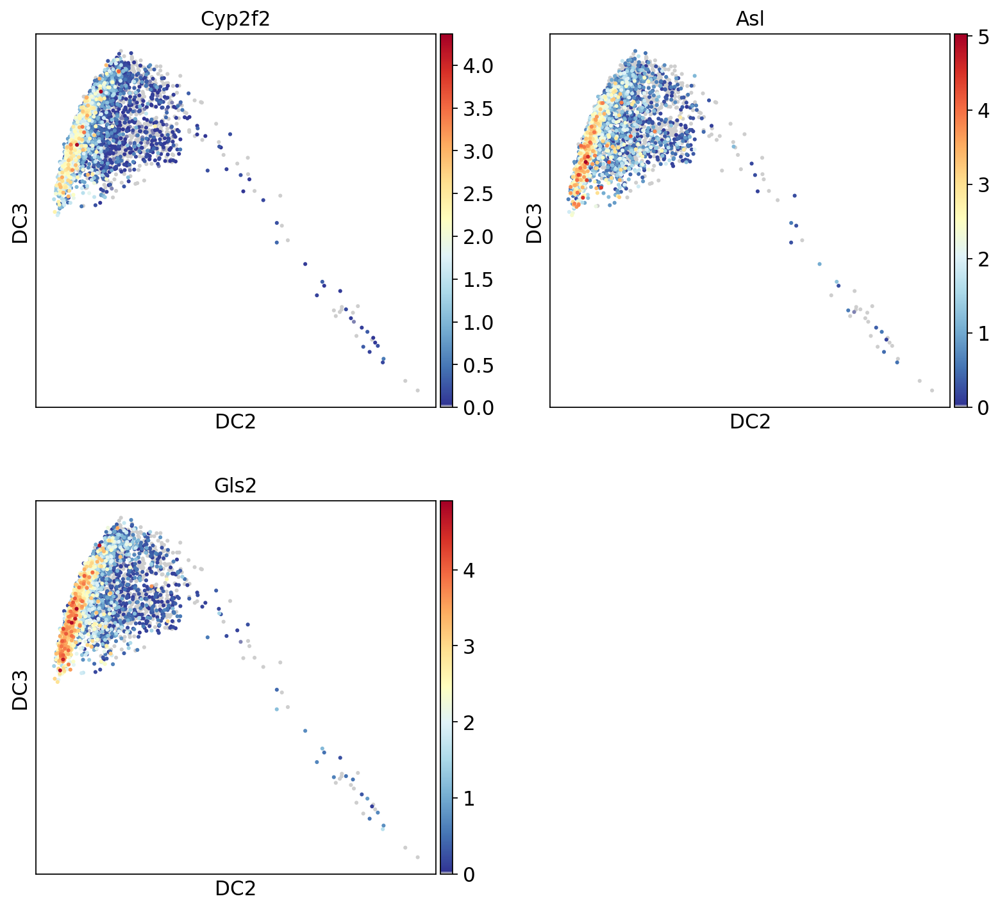

In [41]:
sc.pl.diffmap(adata_hepz, gene_symbols='gene_name',
              color=periportal, ncols=2, color_map=mymap, 
             # save='_'+today+'_zonation_hepatocytes_periportal_genes_DC12.pdf'
             )
sc.pl.diffmap(adata_hepz, gene_symbols='gene_name',
              color=periportal, ncols=2, color_map=mymap, components=[2,3], 
             # save='_'+today+'_zonation_hepatocytes_periportal_genes_DC23.pdf'
             )

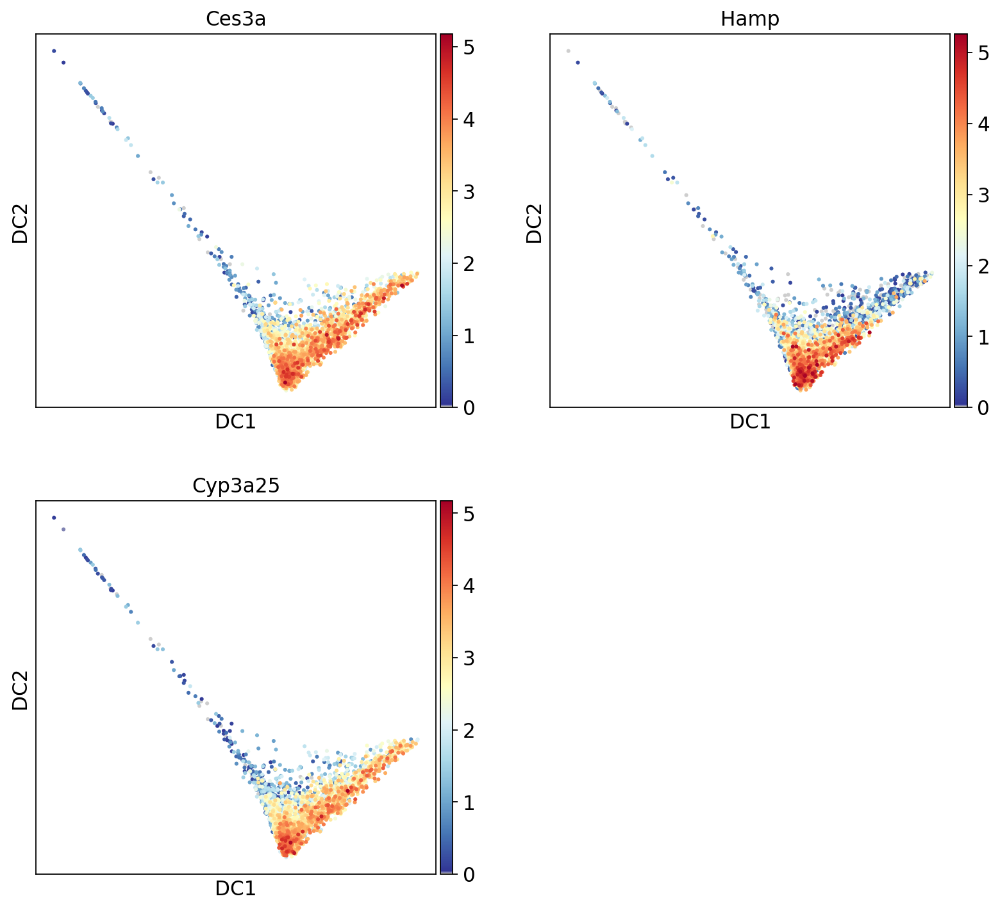

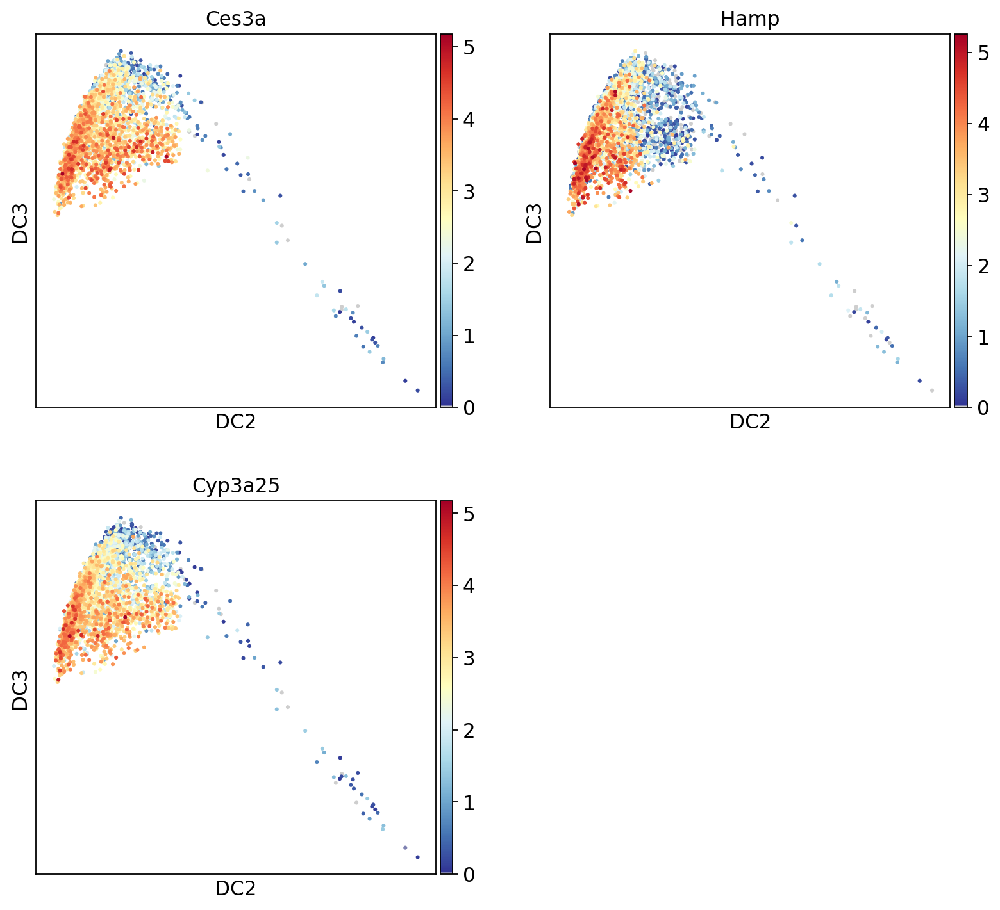

In [42]:
sc.pl.diffmap(adata_hepz, gene_symbols='gene_name',
              color=non_zonated, ncols=2, color_map=mymap, 
             # save='_'+today+'_zonation_hepatocytes_nonzonated_genes_DC12.pdf'
             )
sc.pl.diffmap(adata_hepz, gene_symbols='gene_name',use_raw=True, 
              color=non_zonated, ncols=2, color_map=mymap, components=[2,3], 
             # save='_'+today+'_zonation_hepatocytes_nonzonated_genes_DC23.pdf'
             )

Compute clustering.

In [43]:
sc.tl.leiden(adata_hepz, resolution=0.5)

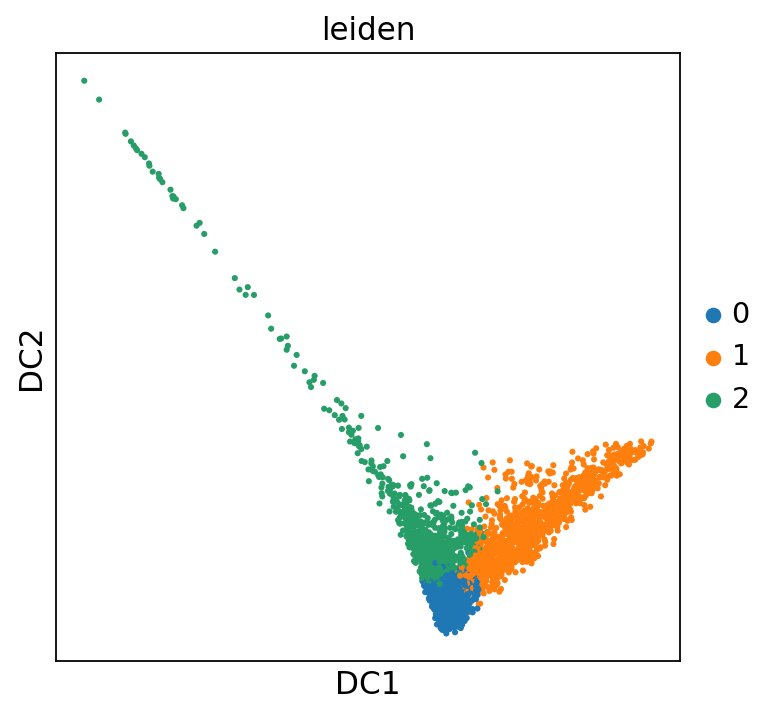

In [44]:
rcParams['figure.figsize']=(5,5)
sc.pl.diffmap(adata_hepz, 
              color=['leiden'], 
             # save='_'+today+'_zonation_hepatocytes_leiden.pdf'
             )

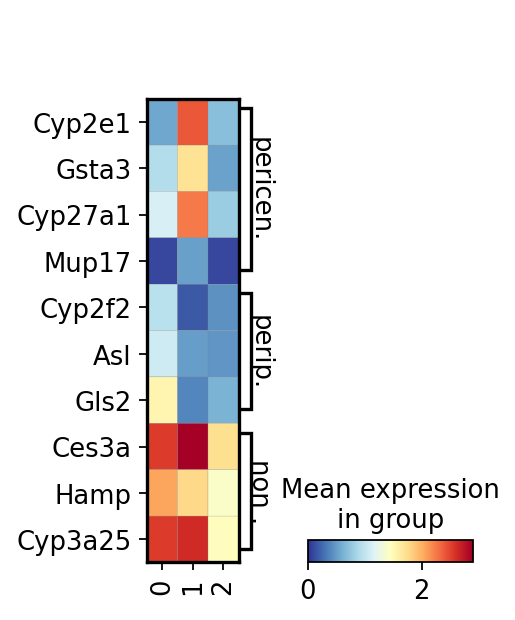

In [45]:
sc.pl.matrixplot(adata_hepz, groupby='leiden', gene_symbols='gene_name', 
                 cmap=mymap, vmin=0, swap_axes=True,
                 var_names=zonation_dict)

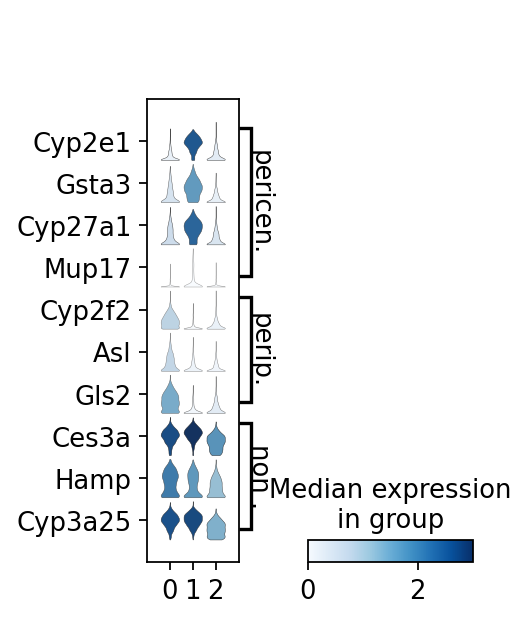

In [46]:
sc.pl.stacked_violin(adata_hepz, groupby='leiden', gene_symbols='gene_name', 
                  vmin=0, swap_axes=True,
                 var_names=zonation_dict)

From the matrixplot, the clusters 0 and 2 seem to be pericentral region and cluster 1 represents the periportal region.

Next, let us compute the fraction of 2n and 4n hepatocytes in each cluster.

In [47]:
adata_hepz.obs['leiden_pcpp'] = adata_hepz.obs['leiden']
adata_hepz.obs['leiden_pcpp'][adata_hepz.obs['leiden']=='2'] = '0'
adata_hepz.obs['leiden_pcpp'] = adata_hepz.obs['leiden_pcpp'].cat.remove_unused_categories()

In [48]:
zonation_df = adata_hepz.obs[['age_grouped', 'strain', 'ploidy', 'leiden_pcpp']]

In [49]:
zonation_df['count'] = 1

<ipython-input-49-45f90e9ede86>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  zonation_df['count'] = 1


In [47]:
tmp = zonation_df.groupby(['age_grouped', 'strain', 'ploidy', 'leiden_pcpp']).sum()

In [48]:
tmp = tmp.reset_index()

In [49]:
tmp.to_csv(data_dir +today + '_zonation_counts.csv')

In [50]:
tmp

,age_grouped,strain,ploidy,leiden_pcpp,count
0,old,C57Bl6/J,2n,0,141
1,old,C57Bl6/J,2n,1,32
2,old,C57Bl6/J,4n,0,339
3,old,C57Bl6/J,4n,1,172
4,old,CEBPA KO,2n,0,172
5,old,CEBPA KO,2n,1,10
6,old,CEBPA KO,4n,0,221
7,old,CEBPA KO,4n,1,73
8,old,CTCF KO,2n,0,80
9,old,CTCF KO,2n,1,20


/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/axisgrid.py:645: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)
/home/icb/maren.buettner/anaconda3/envs/scanpy1-6/lib/python3.8/site-packages/seaborn/axisgrid.py:650: UserWarning: Using the barplot function without specifying `hue_order` is likely to produce an incorrect plot.
  warnings.warn(warning)


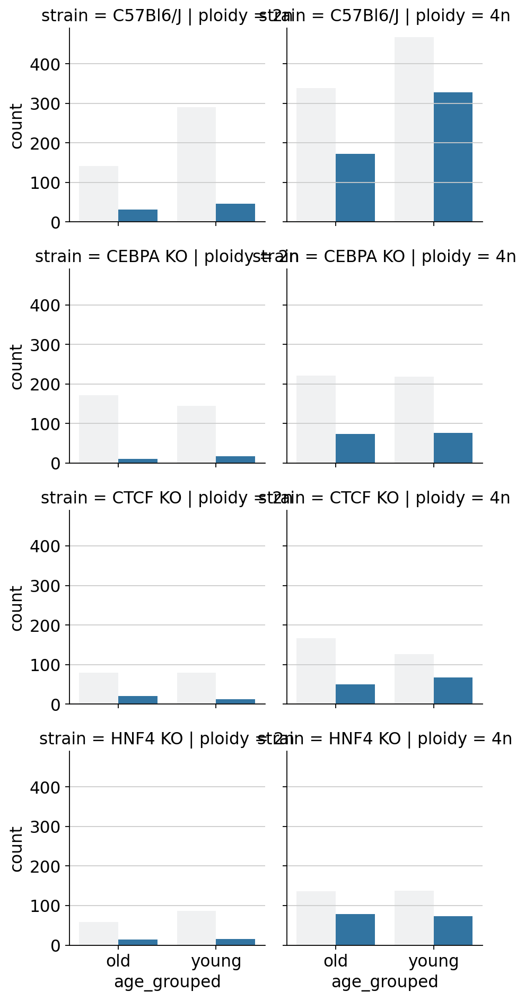

In [51]:
g = sns.FacetGrid(data=tmp, row='strain', col='ploidy')
g.map(sns.barplot, 'age_grouped', 'count', 'leiden_pcpp')
#plt.savefig('./../figures/'+today+'_zonation_counts.pdf', bbox_inches='tight')
plt.show()

Compute a diffusion pseudotime for the zonation pattern.

In [50]:
DC1 = adata_hepz.obsm['X_diffmap'][:, 1]

In [51]:
adata_hepz.uns['iroot'] = np.argmax(DC1)

In [52]:
split_split = [adata_hepz.obs['age_grouped'][idx] + '_'  + 
               adata_hepz.obs['ploidy'][idx] +  '_'+ adata_hepz.obs['strain'][idx] + '_' + 
               adata_hepz.obs['leiden_pcpp'][idx] for idx in range(adata_hepz.n_obs)]

In [53]:
adata_hepz.obs['zonation_age_strain_ploidy'] = split_split

In [54]:
sc.tl.dpt(adata_hepz)
sc.tl.paga(adata_hepz, groups='zonation_age_strain_ploidy')

... storing 'zonation_age_strain_ploidy' as categorical


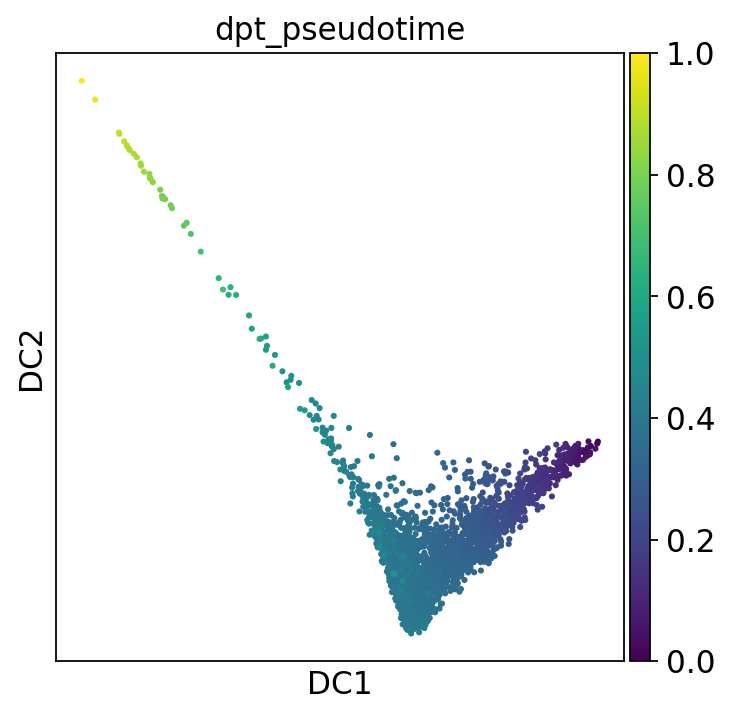

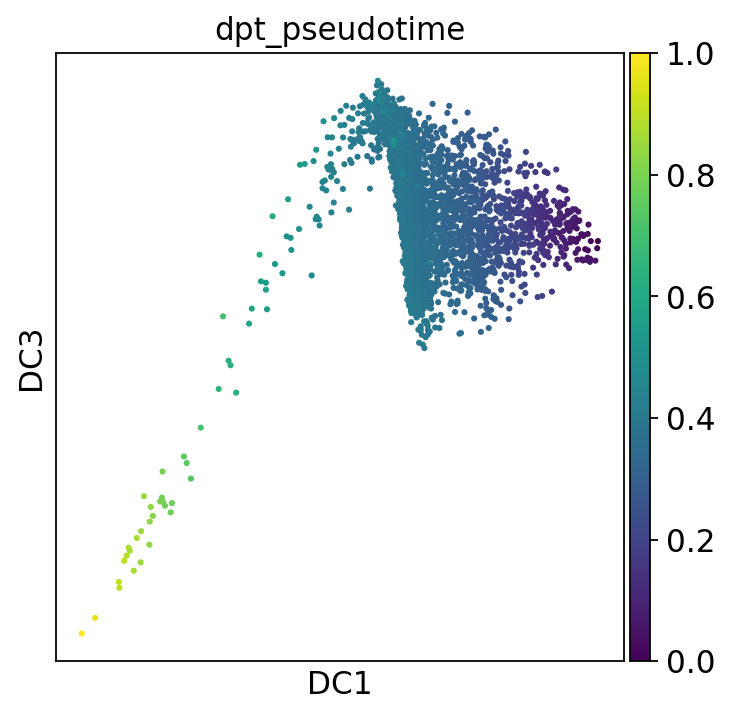

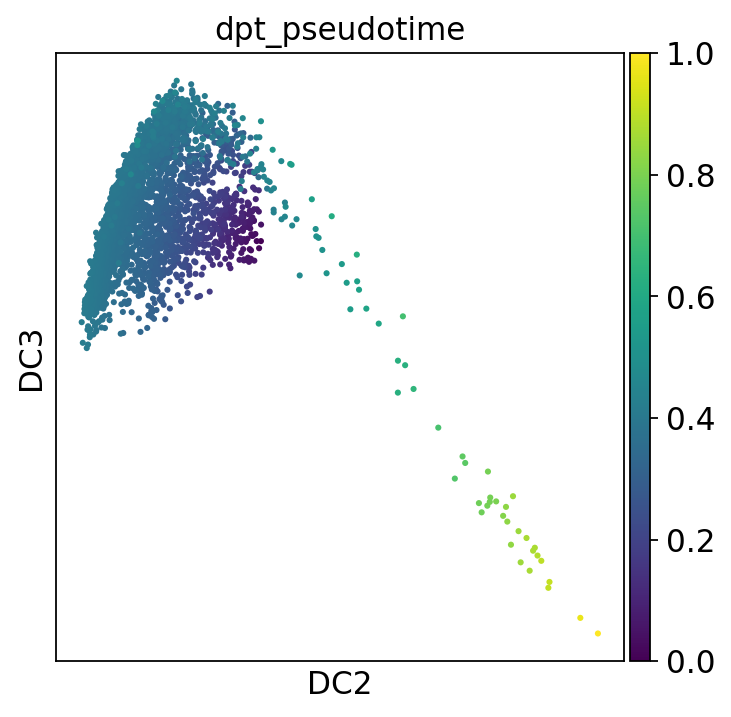

In [55]:
sc.pl.diffmap(adata_hepz, color='dpt_pseudotime', components=[1,2])
sc.pl.diffmap(adata_hepz, color='dpt_pseudotime', components=[1,3])
sc.pl.diffmap(adata_hepz, color='dpt_pseudotime', components=[2,3])

## Plot gene expression of spatial genes 

In [56]:
keys = np.concatenate([adata_hepz.var_names[np.in1d(adata_hepz.var['gene_name'],periportal)], 
                       adata_hepz.var_names[np.in1d(adata_hepz.var['gene_name'],pericentral)],
                       adata_hepz.var_names[np.in1d(adata_hepz.var['gene_name'],non_zonated)]
                      ])

In [57]:
adata_hepz.obs['zonation_age_strain_ploidy'].cat.categories

Index(['old_2n_C57Bl6/J_0', 'old_2n_C57Bl6/J_1', 'old_2n_CEBPA KO_0',
       'old_2n_CEBPA KO_1', 'old_2n_CTCF KO_0', 'old_2n_CTCF KO_1',
       'old_2n_HNF4 KO_0', 'old_2n_HNF4 KO_1', 'old_4n_C57Bl6/J_0',
       'old_4n_C57Bl6/J_1', 'old_4n_CEBPA KO_0', 'old_4n_CEBPA KO_1',
       'old_4n_CTCF KO_0', 'old_4n_CTCF KO_1', 'old_4n_HNF4 KO_0',
       'old_4n_HNF4 KO_1', 'young_2n_C57Bl6/J_0', 'young_2n_C57Bl6/J_1',
       'young_2n_CEBPA KO_0', 'young_2n_CEBPA KO_1', 'young_2n_CTCF KO_0',
       'young_2n_CTCF KO_1', 'young_2n_HNF4 KO_0', 'young_2n_HNF4 KO_1',
       'young_4n_C57Bl6/J_0', 'young_4n_C57Bl6/J_1', 'young_4n_CEBPA KO_0',
       'young_4n_CEBPA KO_1', 'young_4n_CTCF KO_0', 'young_4n_CTCF KO_1',
       'young_4n_HNF4 KO_0', 'young_4n_HNF4 KO_1'],
      dtype='object')

Plot for each strain separately.

### Find DE genes across zonation

In [62]:
sc.tl.rank_genes_groups(adata_hepz, groupby='leiden_pcpp', 
                        groups=['0'], reference='1', n_genes=200, rankby_abs=True)

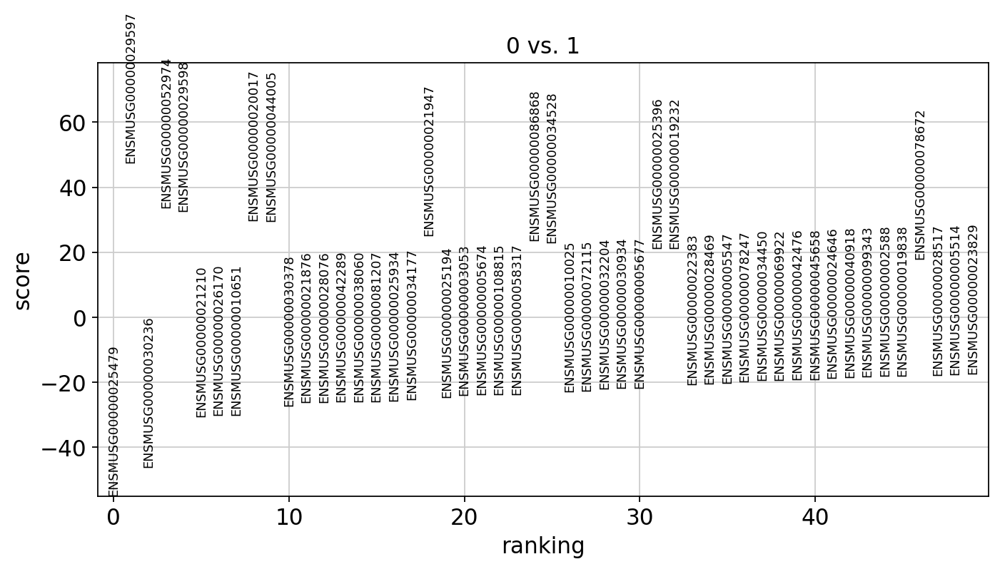

In [63]:
rcParams['figure.figsize']=(10,5)
sc.pl.rank_genes_groups(adata_hepz, n_genes=50)

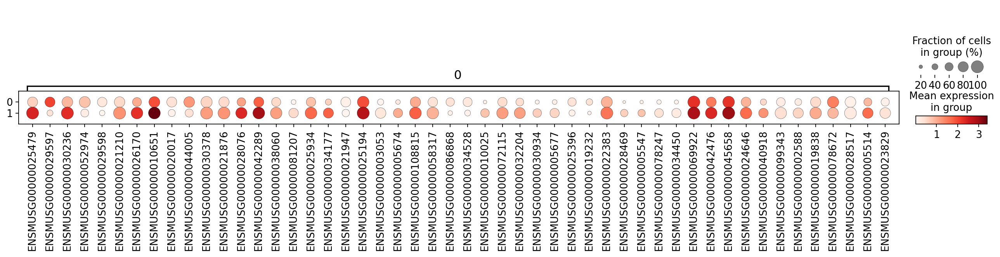

In [64]:
sc.pl.rank_genes_groups_dotplot(adata_hepz, n_genes=50)

Plot gene expression along pseudotime.

In [146]:
names = pd.DataFrame(adata_hepz.uns['rank_genes_groups']['names'])
scores = pd.DataFrame(adata_hepz.uns['rank_genes_groups']['scores'])

In [147]:
names['scores'] = scores

In [155]:
top_pp = names.sort_values('scores')['0'][:30]
top_pc = names.sort_values('scores', ascending=False)['0'][:30]

Create bins over pseudotime and plot gene expression patterns. Split by strain and by age.

In [66]:
genes = []
for gene in ["Hnf4a","Cyp2e1","Alb","Ces3a","Gsta3","Cyp2f2","Hamp",
             "Cyp27a1","Asl","Cyp3a25","Mup17","Gls2"]:
    if gene in adata_hepz.var["gene_name"].tolist():
        genes.append(gene)

Let us check how the pseudotime values are distributed.

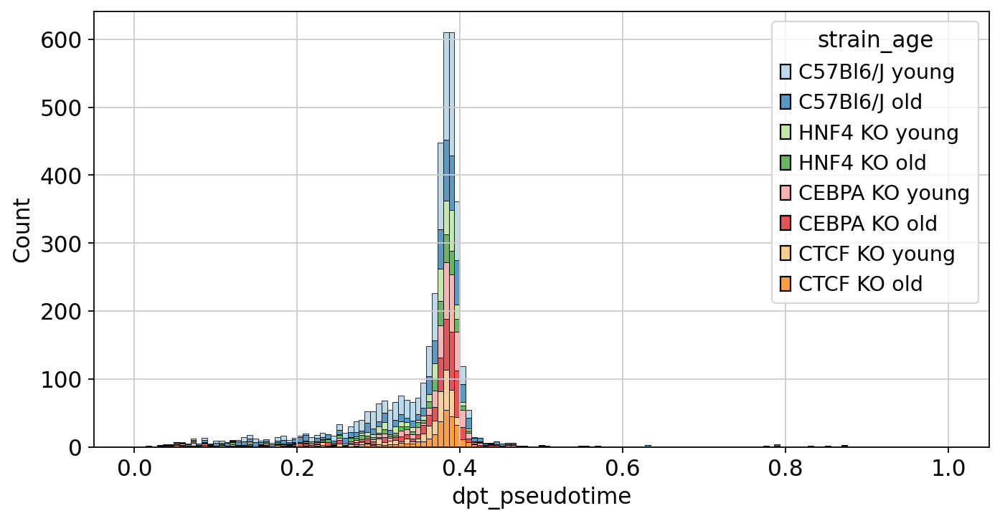

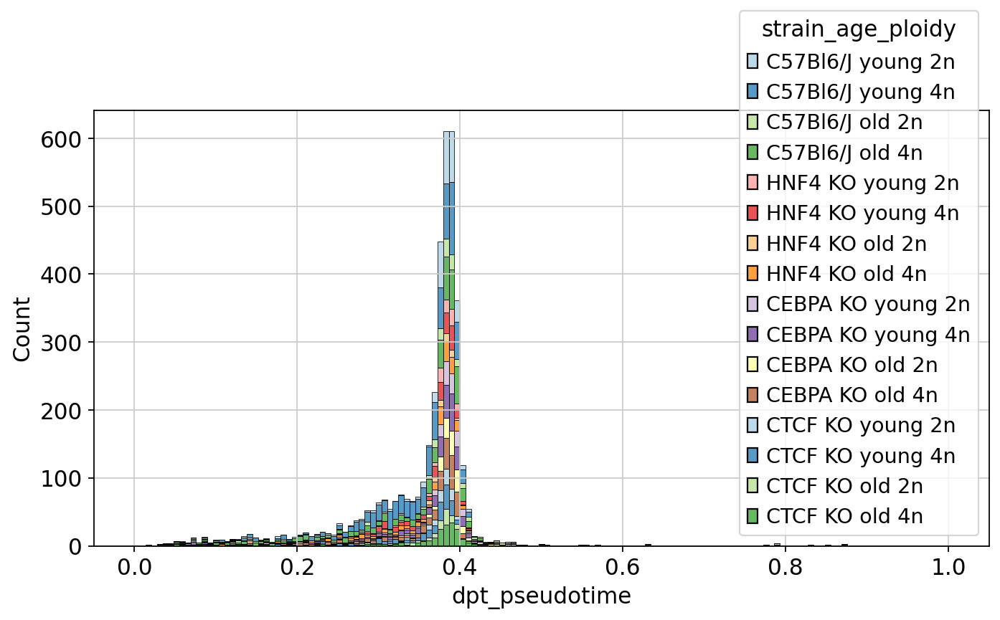

In [84]:
rcParams['figure.figsize']=(10,5)
ax = sns.histplot(x=adata_hepz.obs["dpt_pseudotime"], hue=adata_hepz.obs['strain_age'], palette='Paired', multiple="stack")
plt.savefig('./figures/histogram_' + today + 'strain_age_dpt.pdf')
plt.show()
ax1 = sns.histplot(x=adata_hepz.obs["dpt_pseudotime"], hue=adata_hepz.obs['strain_age_ploidy'], palette='Paired', multiple="stack")
plt.savefig('./figures/histogram_' + today + 'strain_age_ploidy_dpt.pdf')
plt.show()

**Conclusion:** We observe that the majority of values is 0.4 or smaller, therefore, we observe "gaps" in the binned pseudotime at 0.5 or later. The cells in the later pseudotime are almost exclusively old cells, which cannot be assigned to the "pericentral" or "periportal" regime.
We will use two larger bins between 0.6 and 1.0 to counteract. 

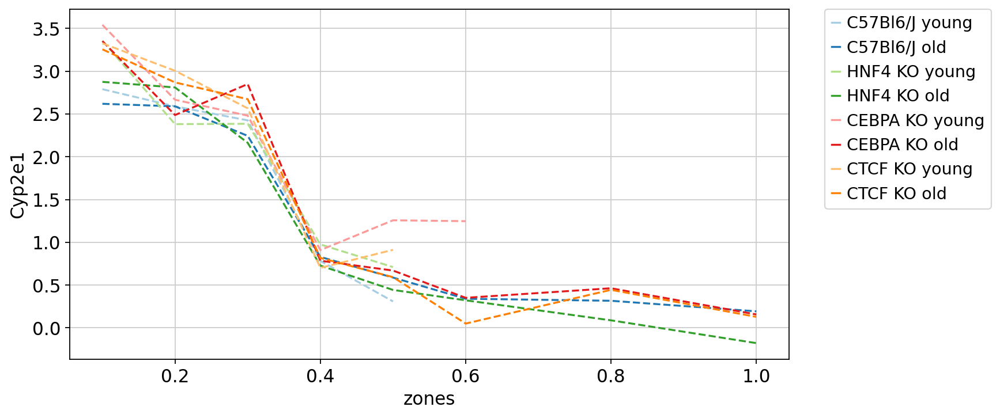

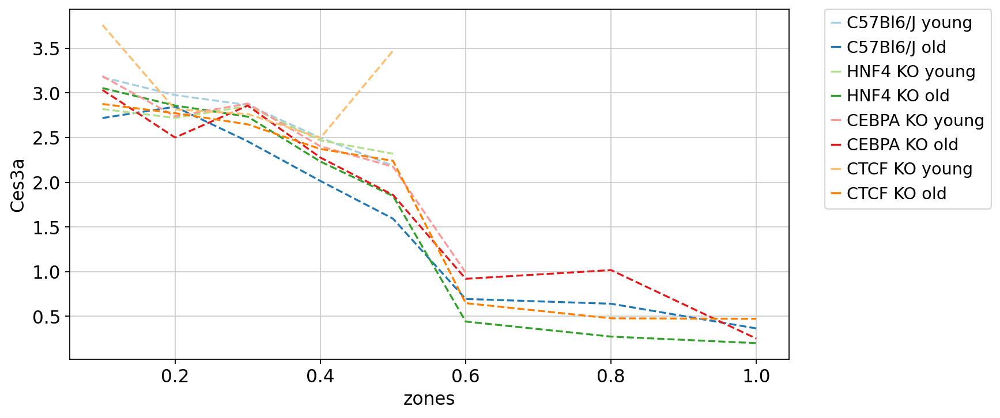

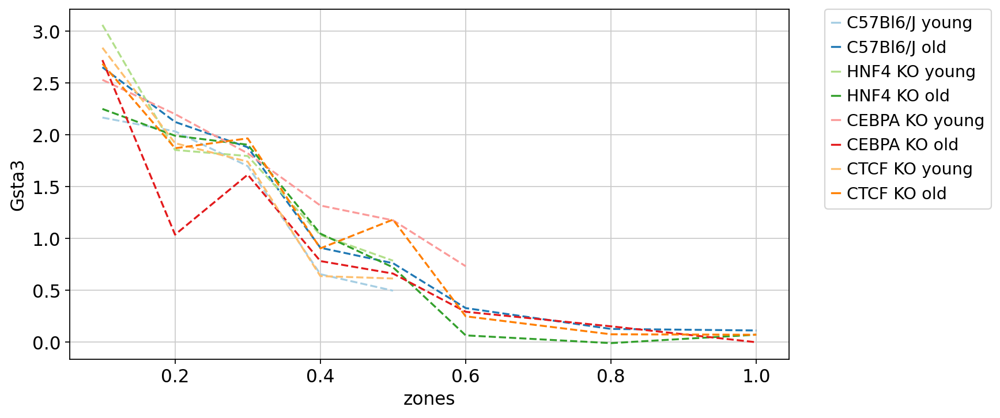

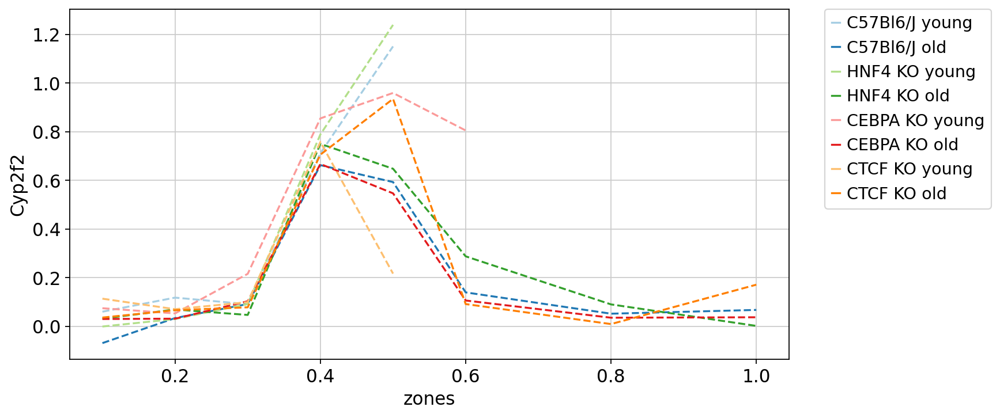

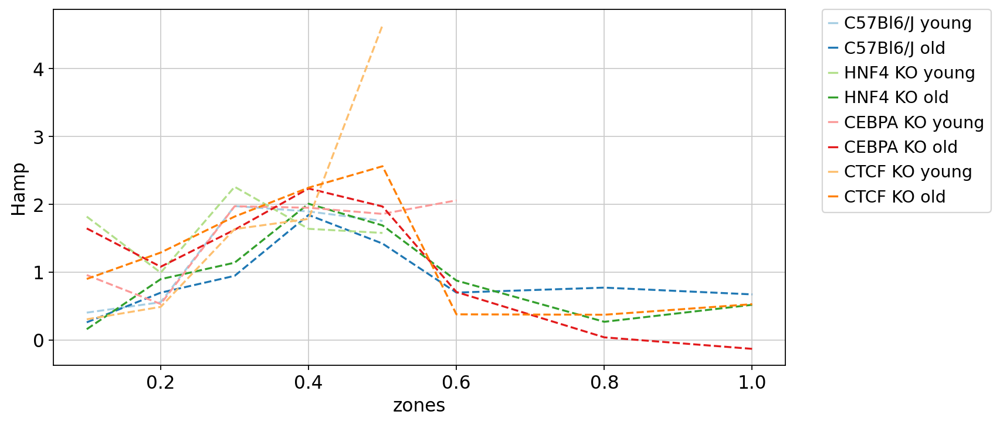

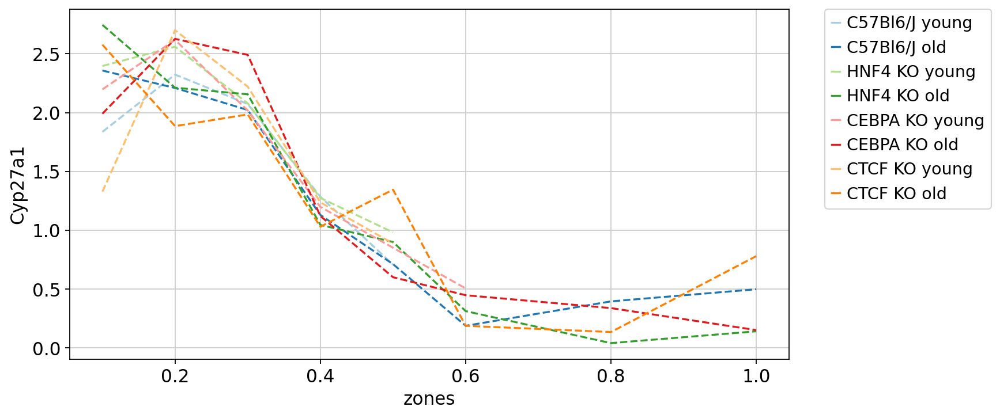

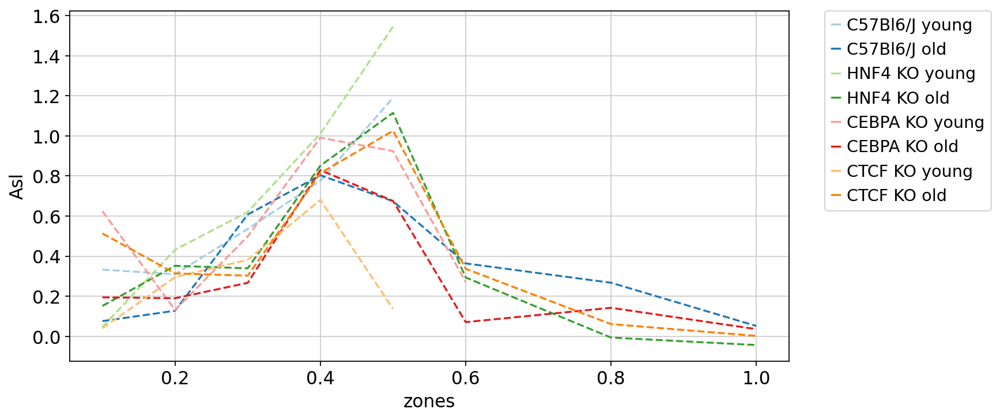

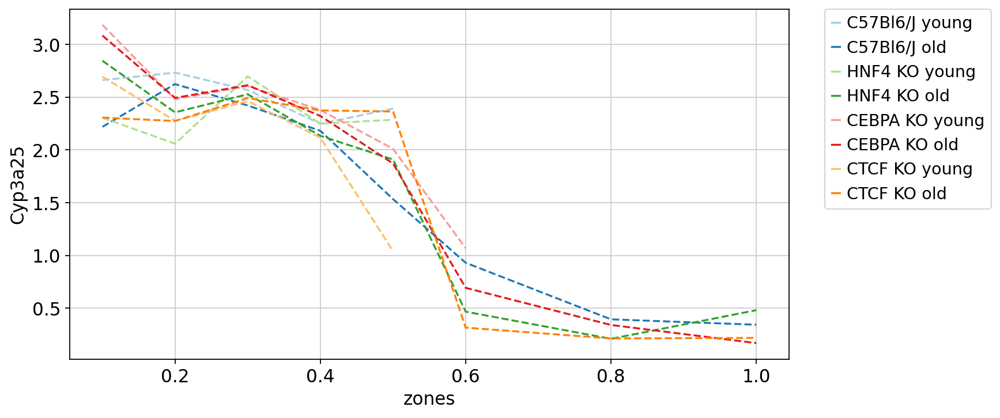

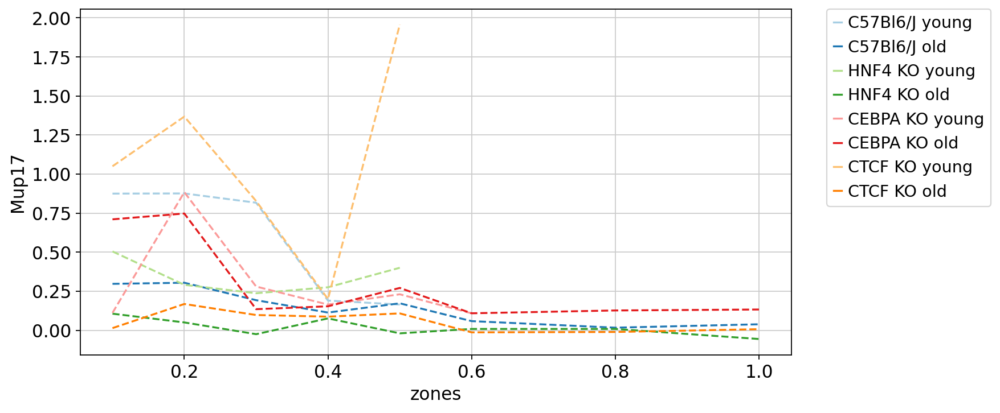

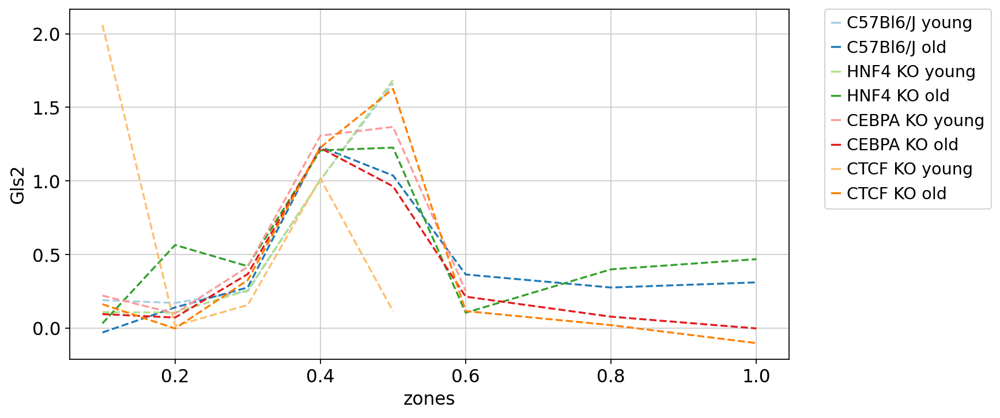

In [63]:
for gene in genes:
   # df = pd.DataFrame()
    df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age': []})
    for level in adata_hepz.obs["strain_age"].cat.categories:
        df_tmp = pd.DataFrame()
        adata_sub = adata_hepz[adata_hepz.obs['strain_age']==level].copy()
        df_tmp["dpt"] = adata_sub.obs["dpt_pseudotime"]
        df_tmp["strain_age"] = adata_sub.obs["strain_age"]

        df_tmp[gene] = np.array(adata_sub[:,adata_sub.var['gene_name']==gene].X)
        bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.8, 1]
        labels = [0.1,0.2,0.3,0.4,0.5,0.6,0.8,1]
        df_tmp['zones'] = pd.cut(df_tmp['dpt'], bins=bins, labels=labels)
        df2_tmp = df_tmp.groupby(df_tmp["zones"]).mean() 
        df2_tmp['zones'] = labels
        df2_tmp['strain_age'] = level
        df2 = df2.append(df2_tmp, ignore_index=True)
   
    sns.lineplot(data=df2, x='zones', y=gene, hue='strain_age', palette='Paired', linestyle='--')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.savefig('./figures/' + today + '_zonation_all_' + gene + '.pdf', bbox_inches='tight')
    plt.show()

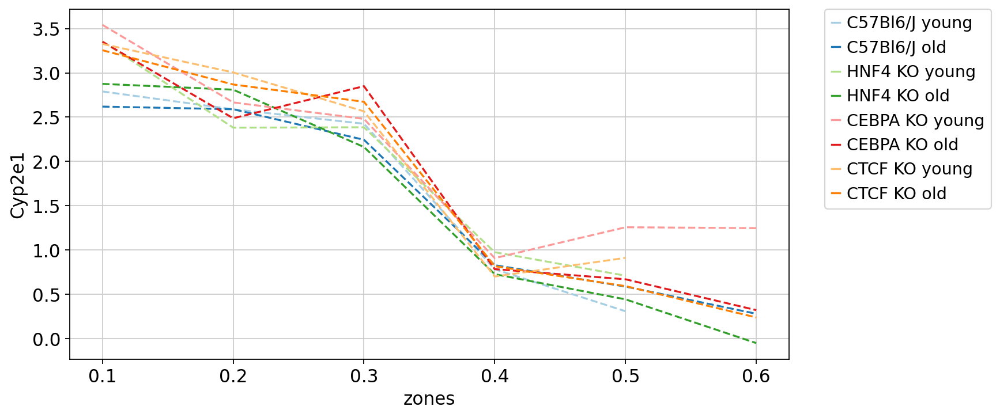

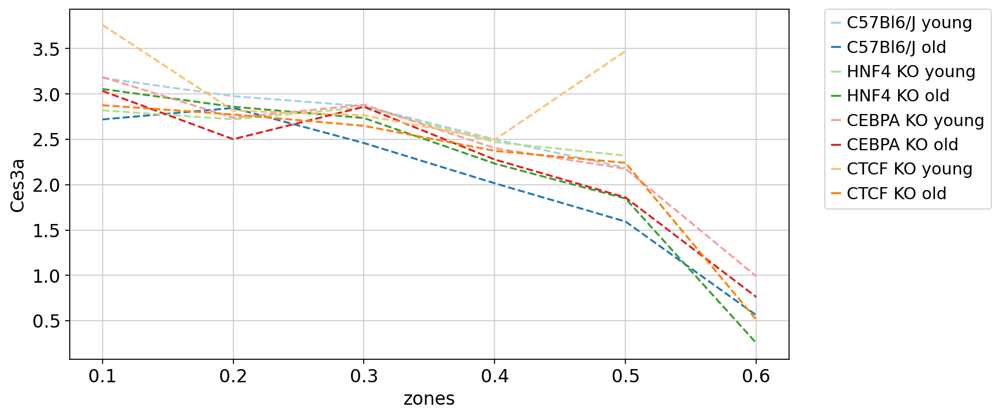

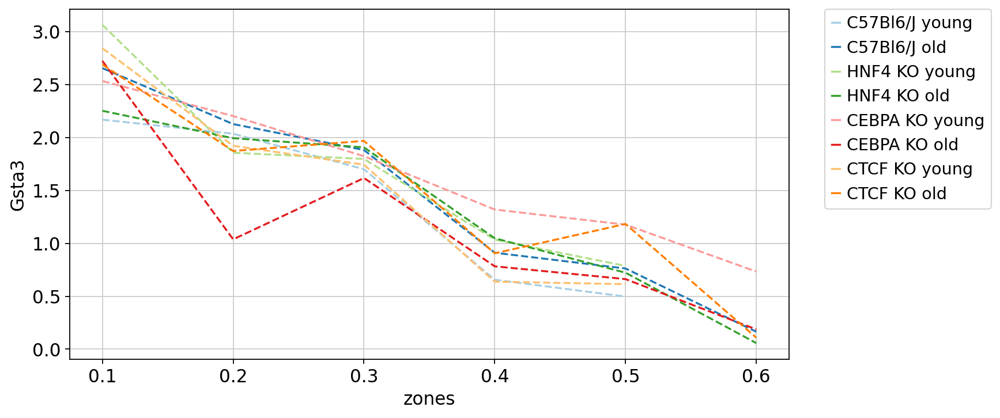

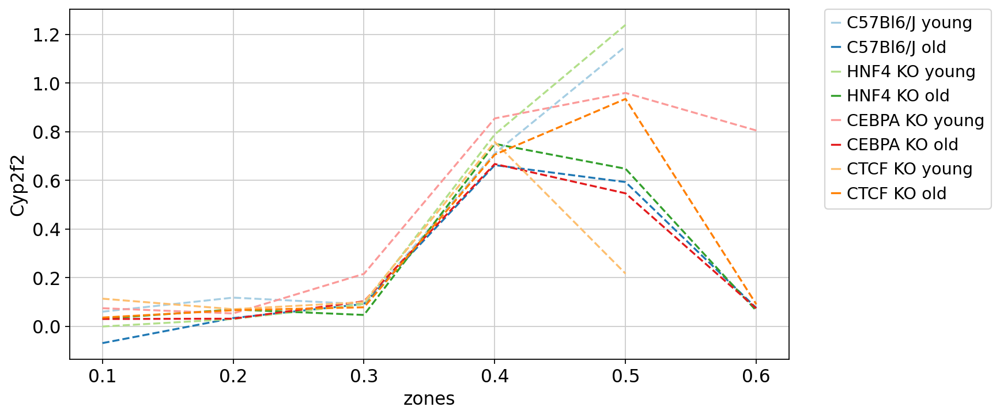

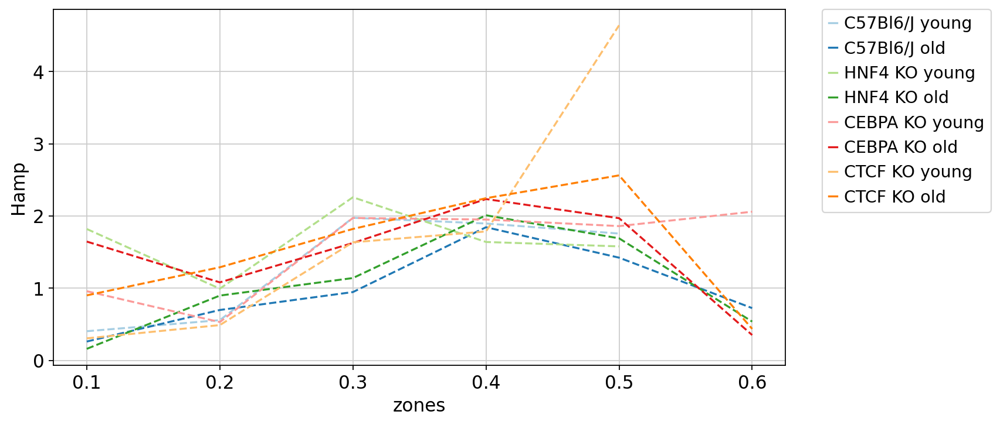

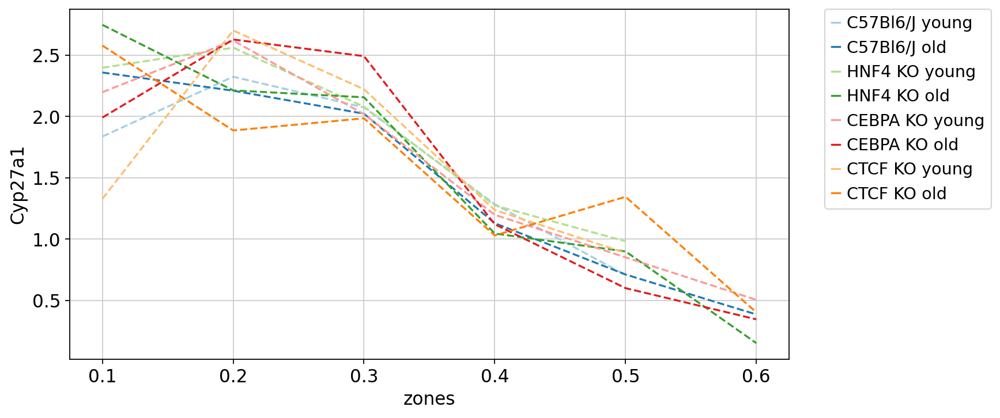

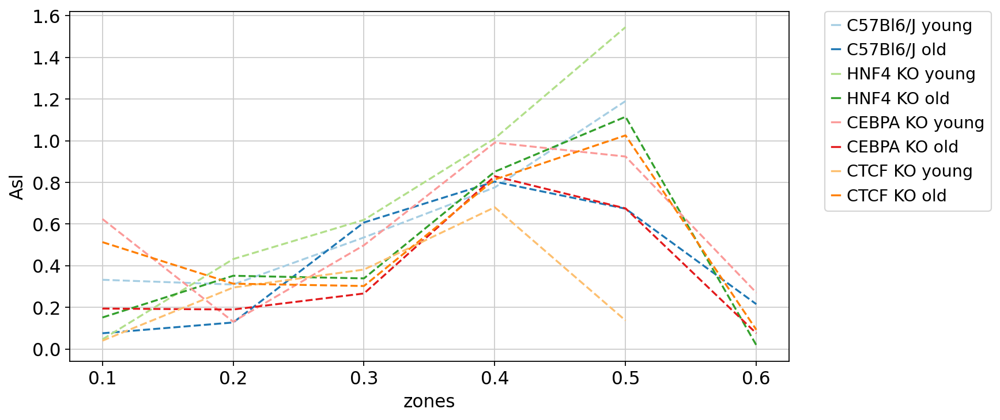

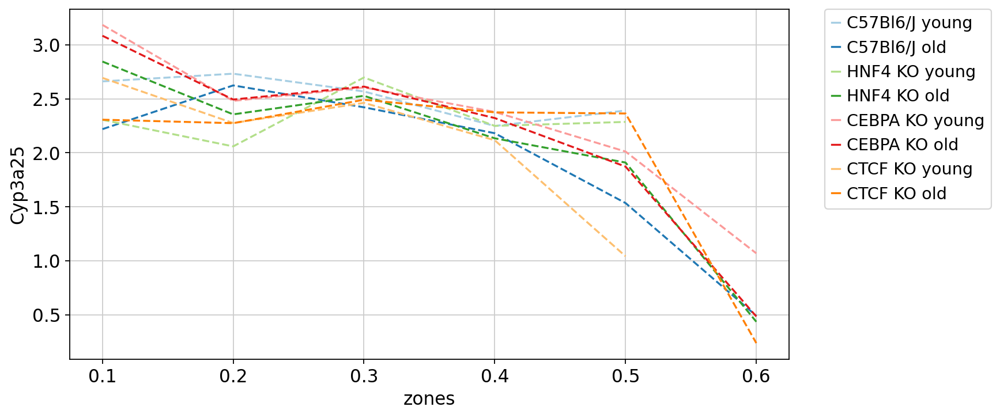

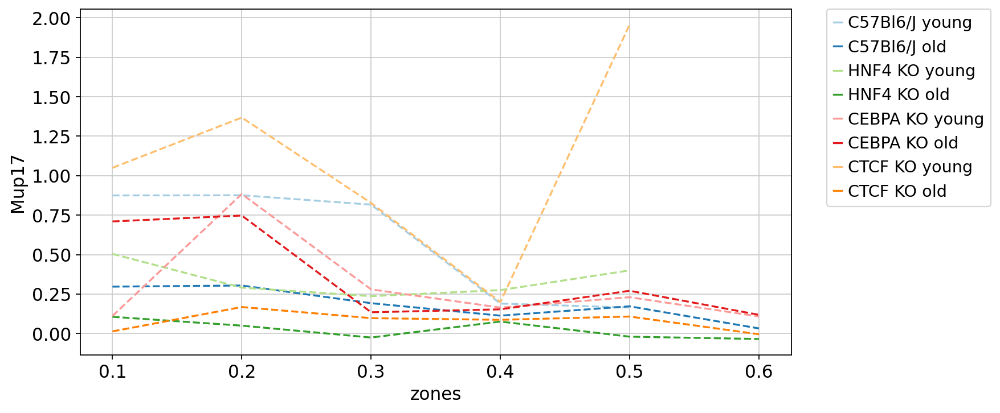

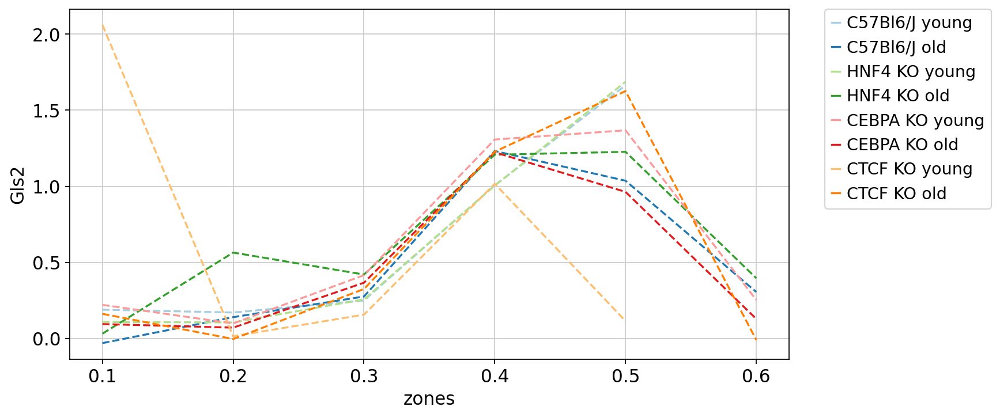

In [64]:
for gene in genes:
   # df = pd.DataFrame()
    df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age': []})
    for level in adata_hepz.obs["strain_age"].cat.categories:
        df_tmp = pd.DataFrame()
        adata_sub = adata_hepz[adata_hepz.obs['strain_age']==level].copy()
        df_tmp["dpt"] = adata_sub.obs["dpt_pseudotime"]
        df_tmp["strain_age"] = adata_sub.obs["strain_age"]

        df_tmp[gene] = np.array(adata_sub[:,adata_sub.var['gene_name']==gene].X)
        bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 1]
        labels = [0.1,0.2,0.3,0.4,0.5,0.6]
        df_tmp['zones'] = pd.cut(df_tmp['dpt'], bins=bins, labels=labels)
        df2_tmp = df_tmp.groupby(df_tmp["zones"]).mean() 
        df2_tmp['zones'] = labels
        df2_tmp['strain_age'] = level
        df2 = df2.append(df2_tmp, ignore_index=True)
   
    sns.lineplot(data=df2, x='zones', y=gene, hue='strain_age', palette='Paired', linestyle='--')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.show()

## Remove outlier cells

Next, let us remove all cells with a DPT larger than 0.42.

In [59]:
adata_hepzDPT = adata_hepz[adata_hepz.obs['dpt_pseudotime']<=0.42].copy()

Recompute embedding and pseudotime.

In [60]:
sc.pp.pca(adata_hepzDPT)
sc.pp.neighbors(adata_hepzDPT)
sc.tl.diffmap(adata_hepzDPT)

In [61]:
sc.tl.leiden(adata_hepzDPT, resolution=0.5)

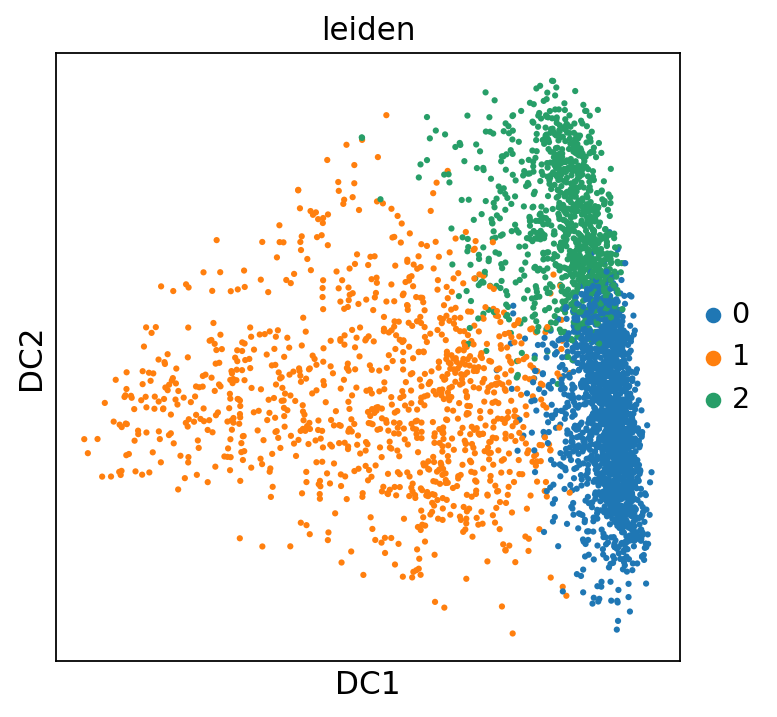

In [62]:
rcParams['figure.figsize']=(5,5)
sc.pl.diffmap(adata_hepzDPT, color='leiden',
             # save = today + '_leiden_DPT_thresholded'
             )

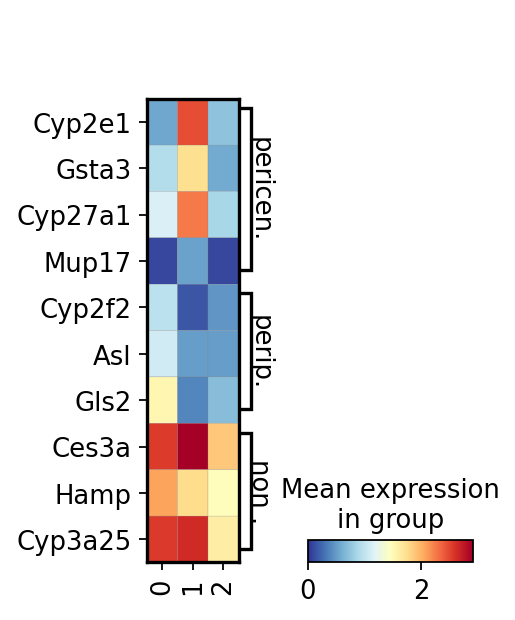

In [63]:
sc.pl.matrixplot(adata_hepzDPT, groupby='leiden', gene_symbols='gene_name', 
                 cmap=mymap, vmin=0, swap_axes=True,
                 var_names=zonation_dict,
                # save = today + '_leiden_zonation_marker_DPT_thresholded'
                )

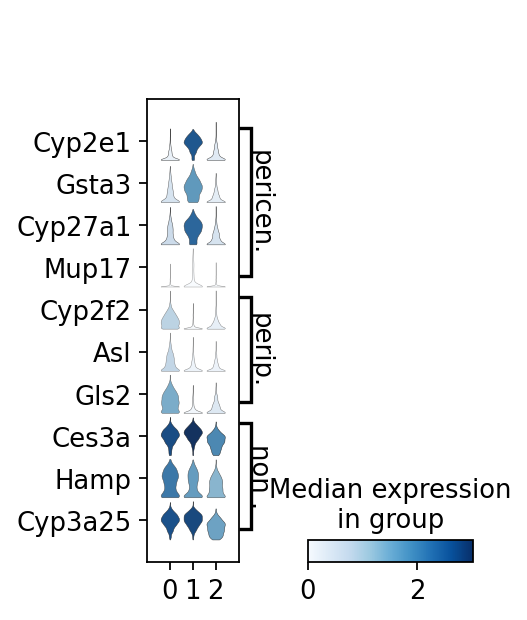

In [64]:
sc.pl.stacked_violin(adata_hepzDPT, groupby='leiden', gene_symbols='gene_name', 
                  vmin=0, swap_axes=True,
                 var_names=zonation_dict,
                 #save = today + '_leiden_zonation_marker_DPT_thresholded'
                    )

Plot genes per strain.

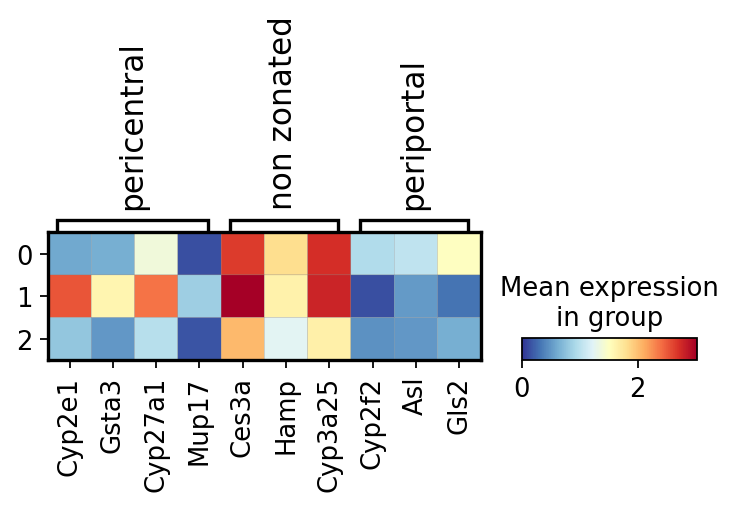

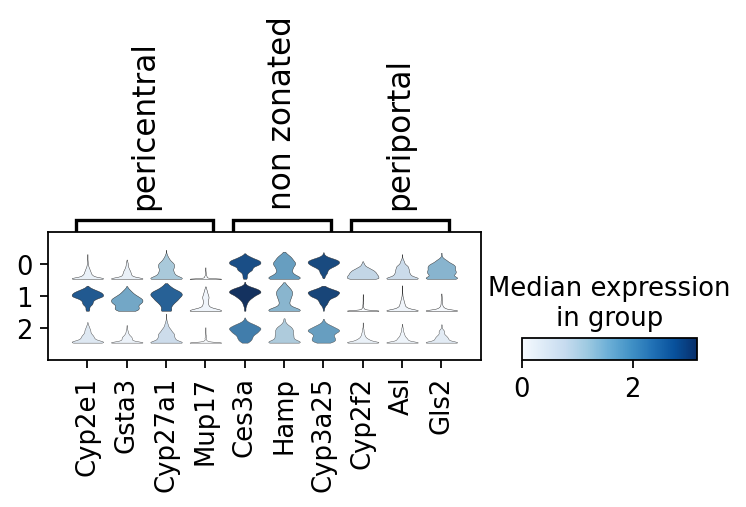

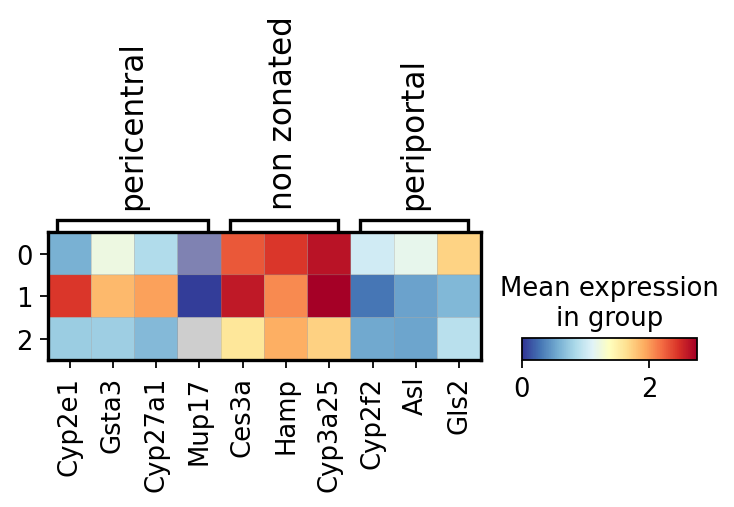

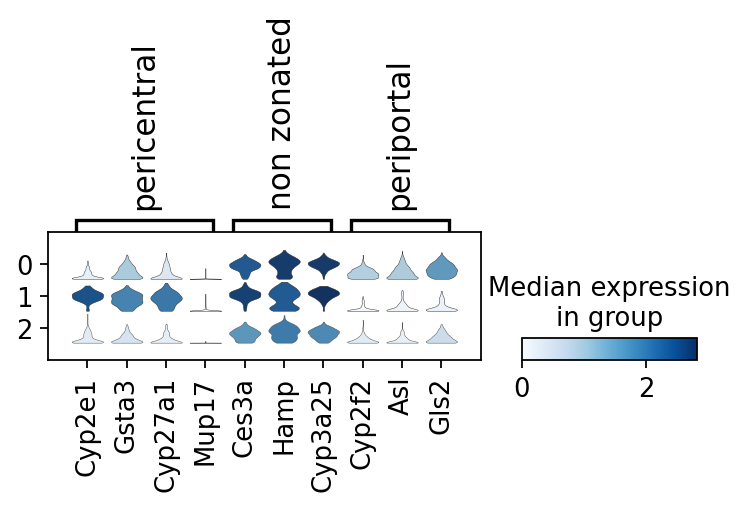

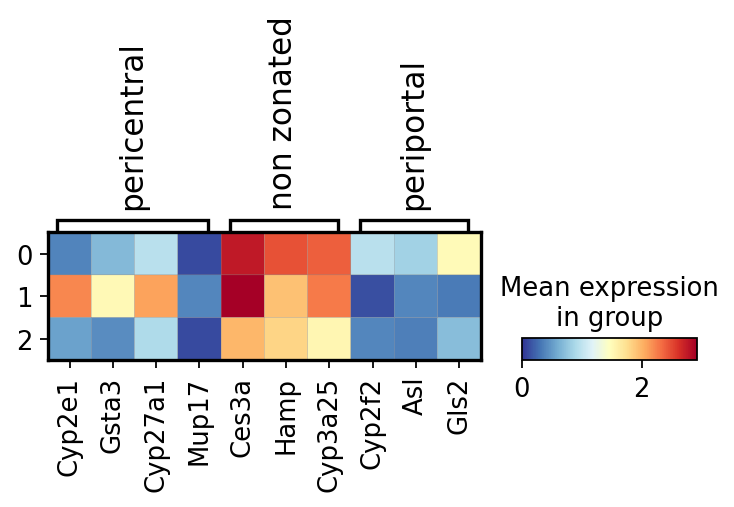

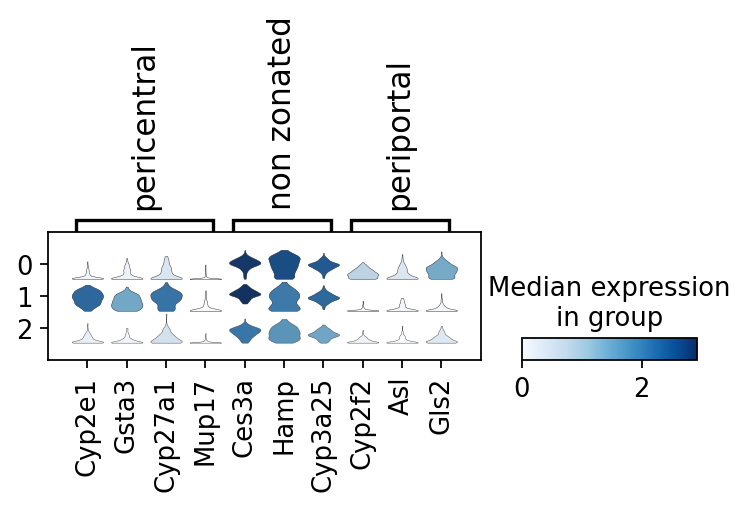

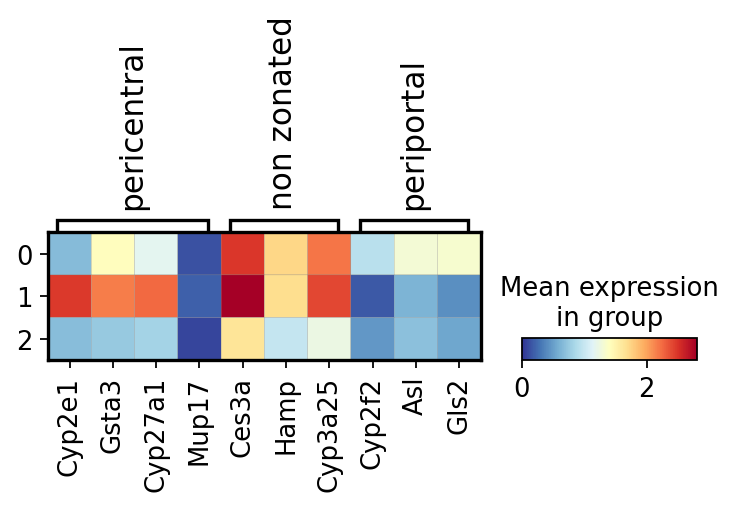

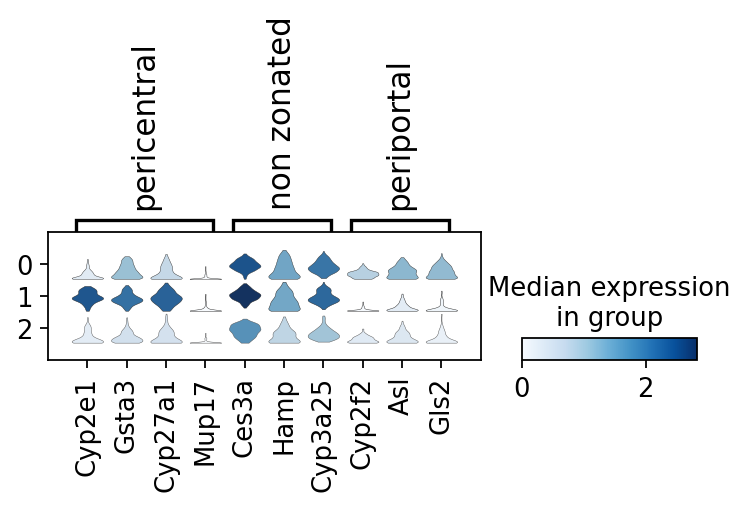

In [94]:
for strain in adata_hepzDPT.obs['strain'].cat.categories:
    adata_tmp = adata_hepzDPT[adata_hepzDPT.obs['strain']==strain].copy()
    sc.pl.matrixplot(adata_tmp, groupby='leiden', gene_symbols='gene_name', 
                 cmap=mymap, vmin=0, #swap_axes=True,
                 var_names=zonation_dict,
                 save = f"{today}_leiden_zonation_marker_{strain.replace('/','')}_DPT_thresholded.pdf"
                )
    sc.pl.stacked_violin(adata_tmp, groupby='leiden', gene_symbols='gene_name', 
                  vmin=0, #swap_axes=True,
                 var_names=zonation_dict,
                 save = f"{today}_leiden_zonation_marker_{strain.replace('/','')}_DPT_thresholded.pdf"
                    )

Merge clusters 0 and 2 as the periportal cells.

In [71]:
adata_hepzDPT.obs['leiden_pcpp'] = adata_hepzDPT.obs['leiden']
adata_hepzDPT.obs['leiden_pcpp'][adata_hepzDPT.obs['leiden']=='2'] = '0'
adata_hepzDPT.obs['leiden_pcpp'] = adata_hepzDPT.obs['leiden_pcpp'].cat.remove_unused_categories()

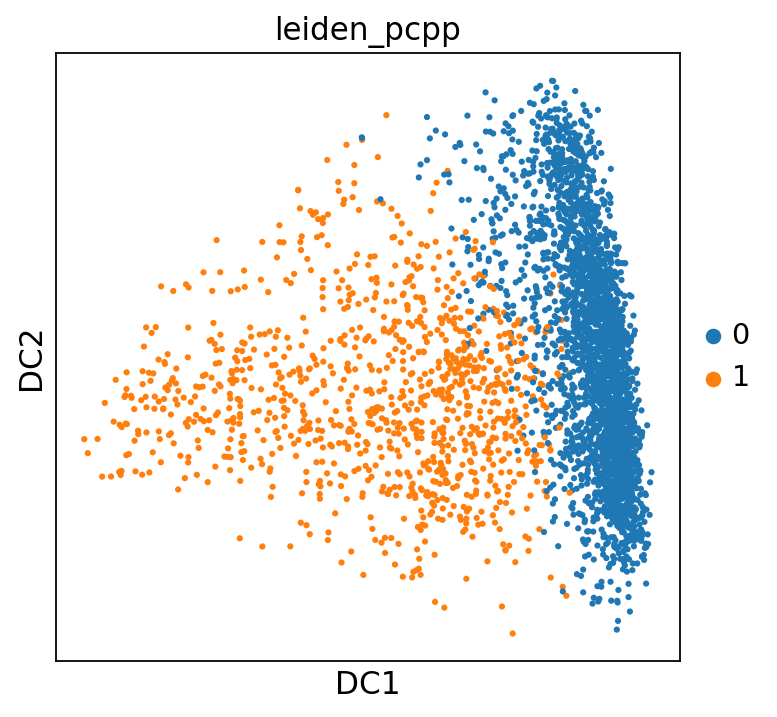

In [73]:
rcParams['figure.figsize']=(5,5)
sc.pl.diffmap(adata_hepzDPT, color='leiden_pcpp',
             save = today + '_leiden_pcpp_DPT_thresholded.pdf'             
             )

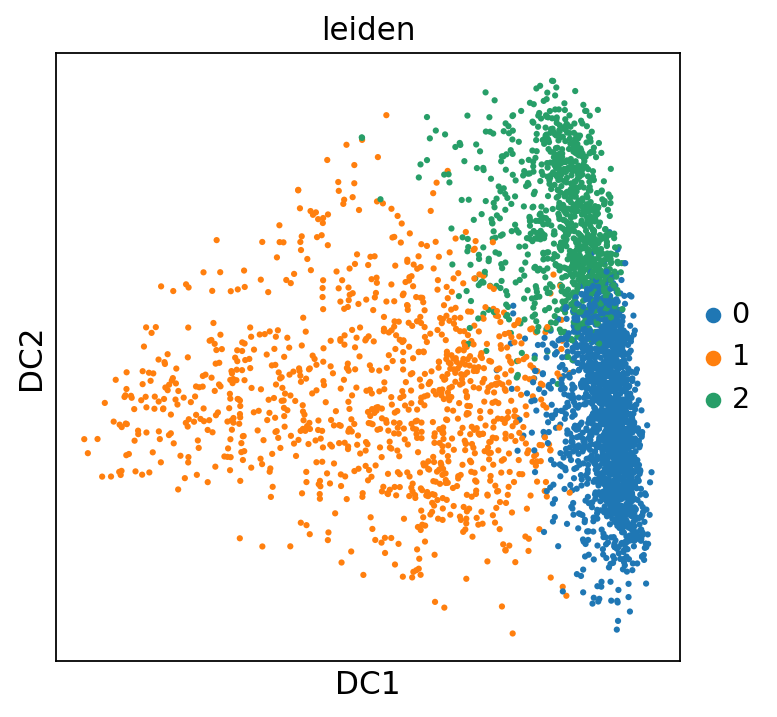

In [74]:
rcParams['figure.figsize']=(5,5)
sc.pl.diffmap(adata_hepzDPT, color='leiden',
             save = today + '_leiden_DPT_thresholded.pdf'             
             )

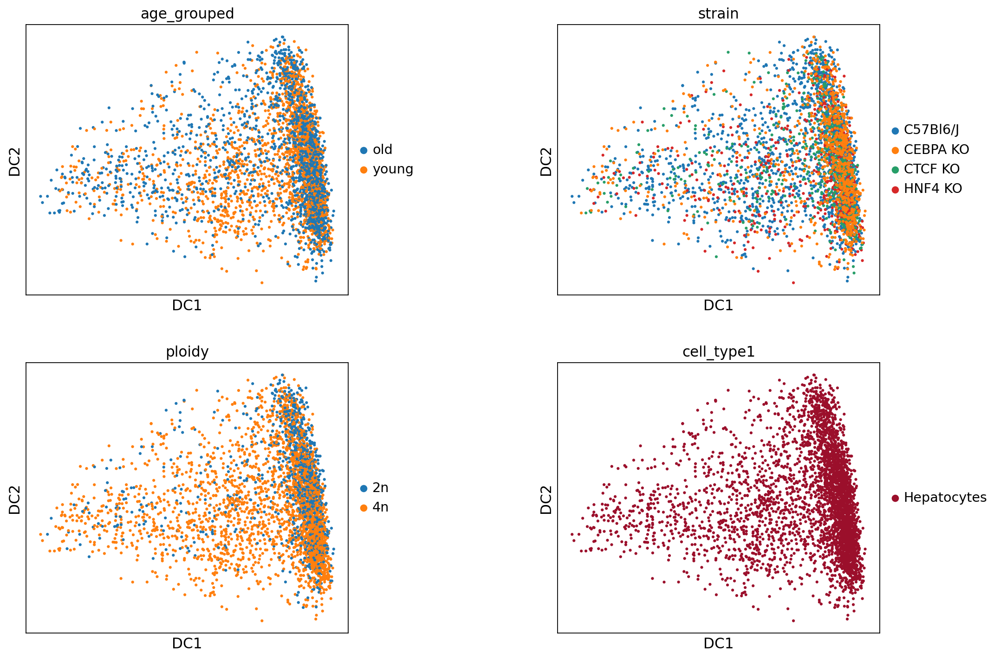

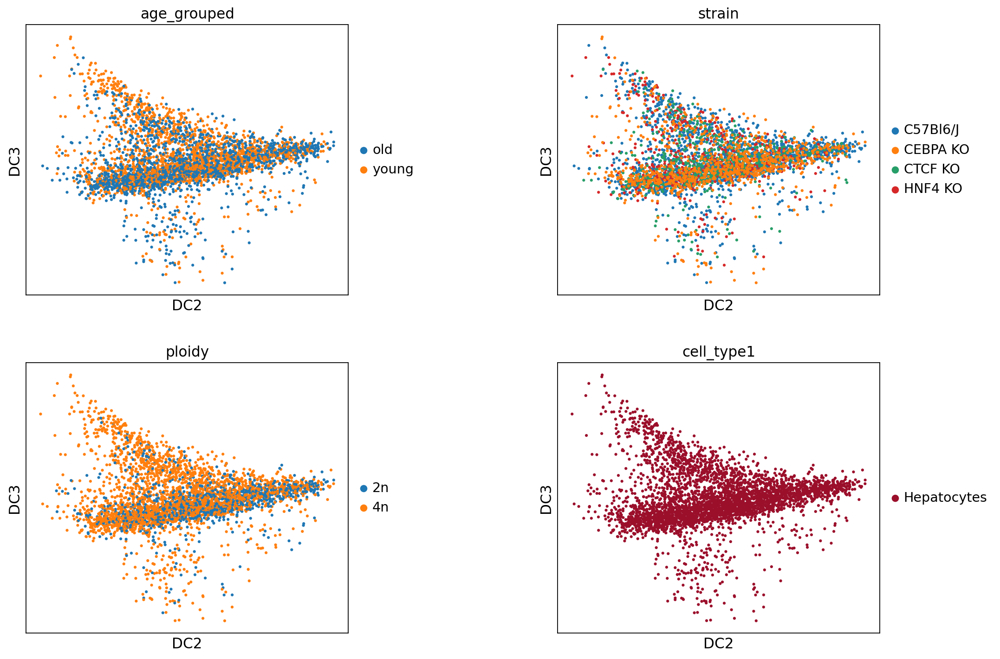

In [68]:
rcParams['figure.figsize']= (5,5)
sc.pl.diffmap(adata_hepzDPT, color=['age_grouped', 'strain','ploidy', 'cell_type1'],
              ncols=2, wspace=0.5, 
             # save='_'+today+'_zonation_hepatocytes_overview_DC12_DPT_thresholded.pdf'
             )
sc.pl.diffmap(adata_hepzDPT, color=['age_grouped', 'strain','ploidy', 'cell_type1'], 
              ncols=2, wspace=0.5, components=[2,3],
             # save='_'+today+'_zonation_hepatocytes_overview_DC23_DPT_thresholded.pdf'
             )

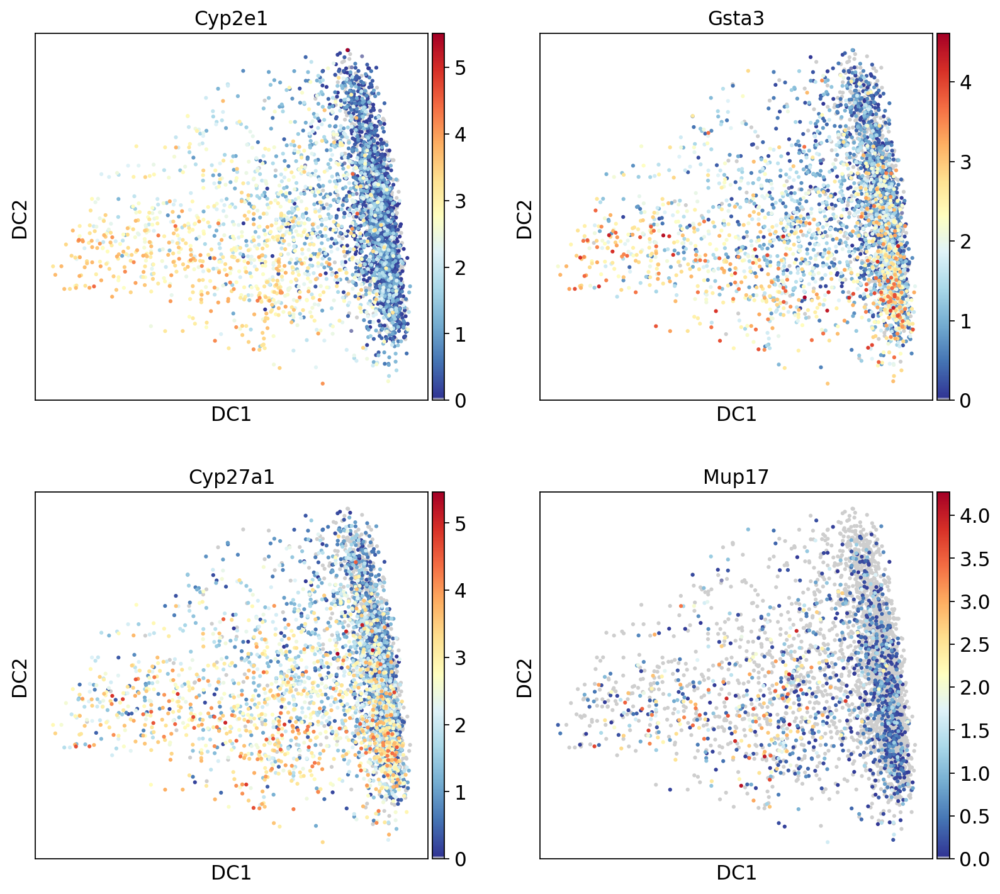

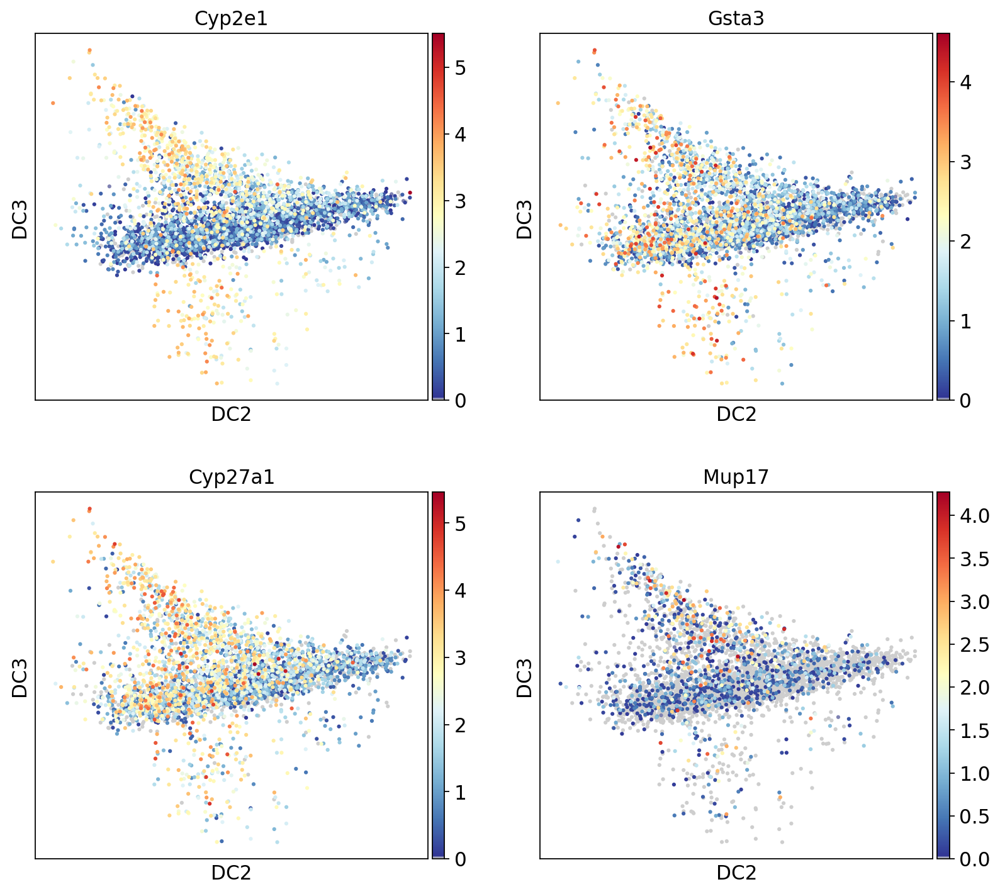

In [69]:
sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name', use_raw=True, 
              color=pericentral, ncols=2, color_map=mymap, 
              #save='_'+today+'_zonation_hepatocytes_pericentral_genes_DC12_DPT_thresholded.pdf'
             )
sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name', use_raw=True, 
              color=pericentral, ncols=2, color_map=mymap, components=[2,3], 
             # save='_'+today+'_zonation_hepatocytes_pericentral_genes_DC23_DPT_thresholded.pdf'
             )

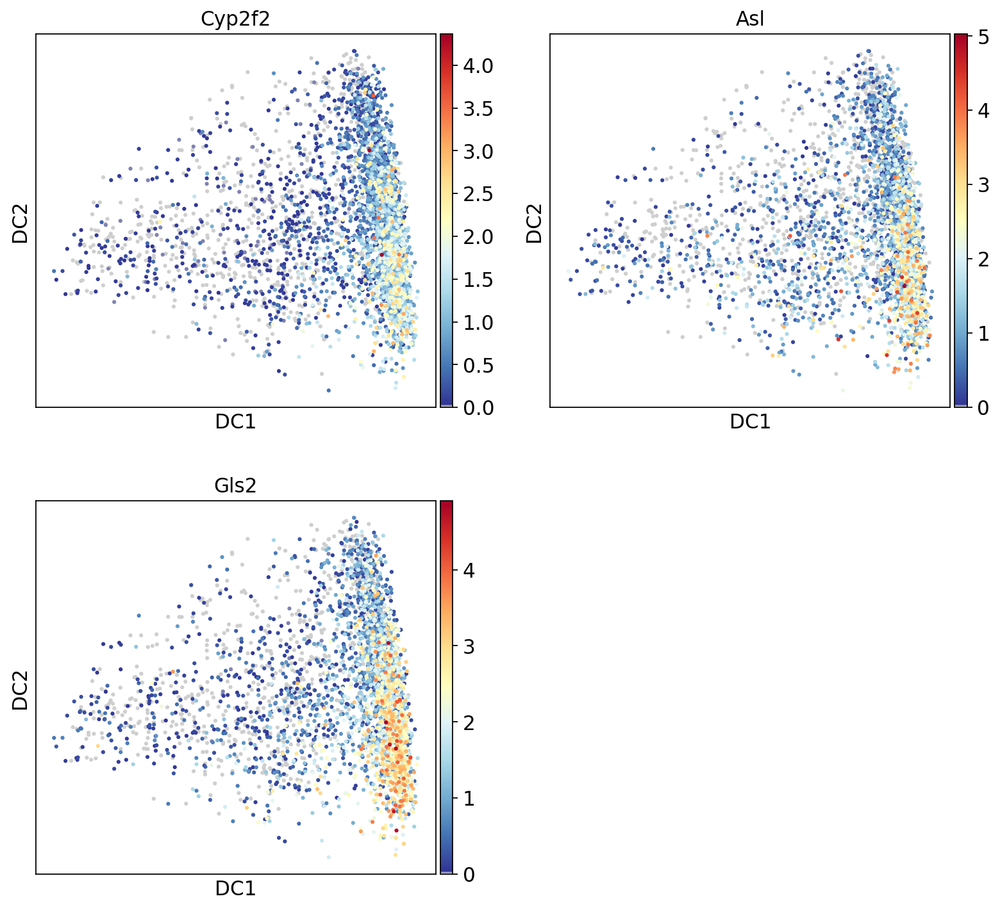

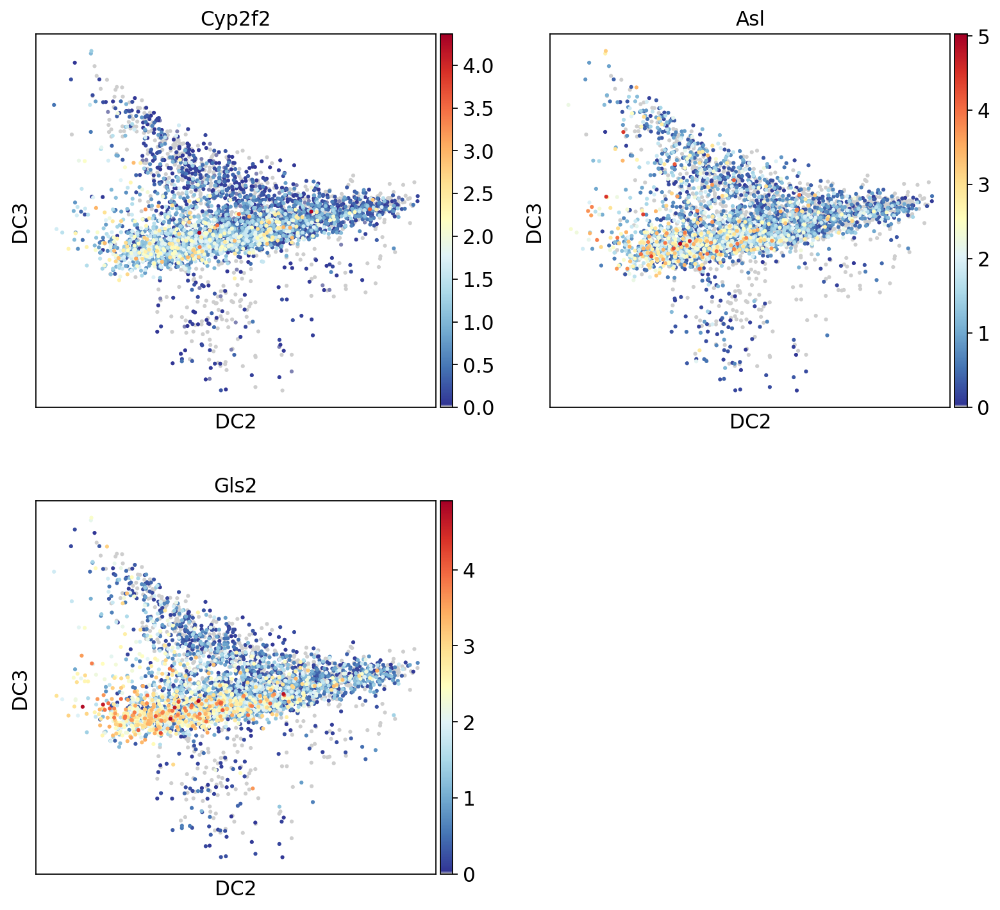

In [70]:
sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name',
              color=periportal, ncols=2, color_map=mymap, 
             # save='_'+today+'_zonation_hepatocytes_periportal_genes_DC12_DPT_thresholded.pdf'
             )
sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name',
              color=periportal, ncols=2, color_map=mymap, components=[2,3], 
             # save='_'+today+'_zonation_hepatocytes_periportal_genes_DC23_DPT_thresholded.pdf'
             )

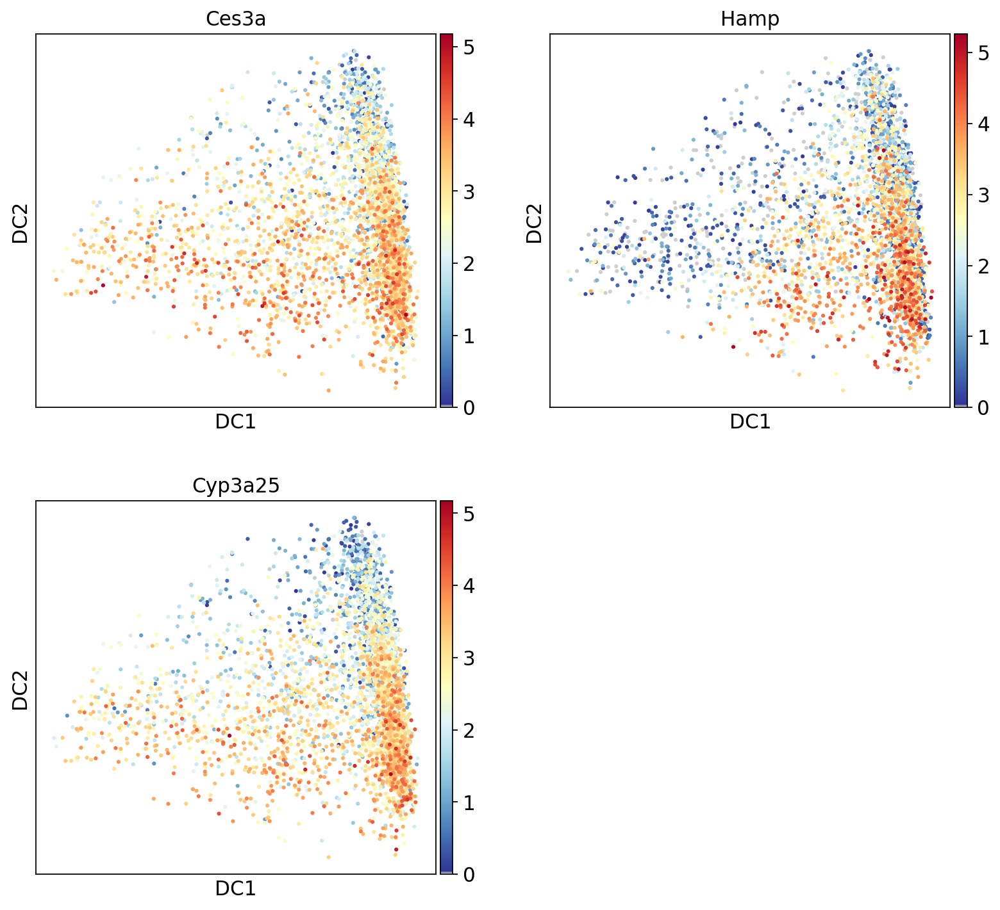

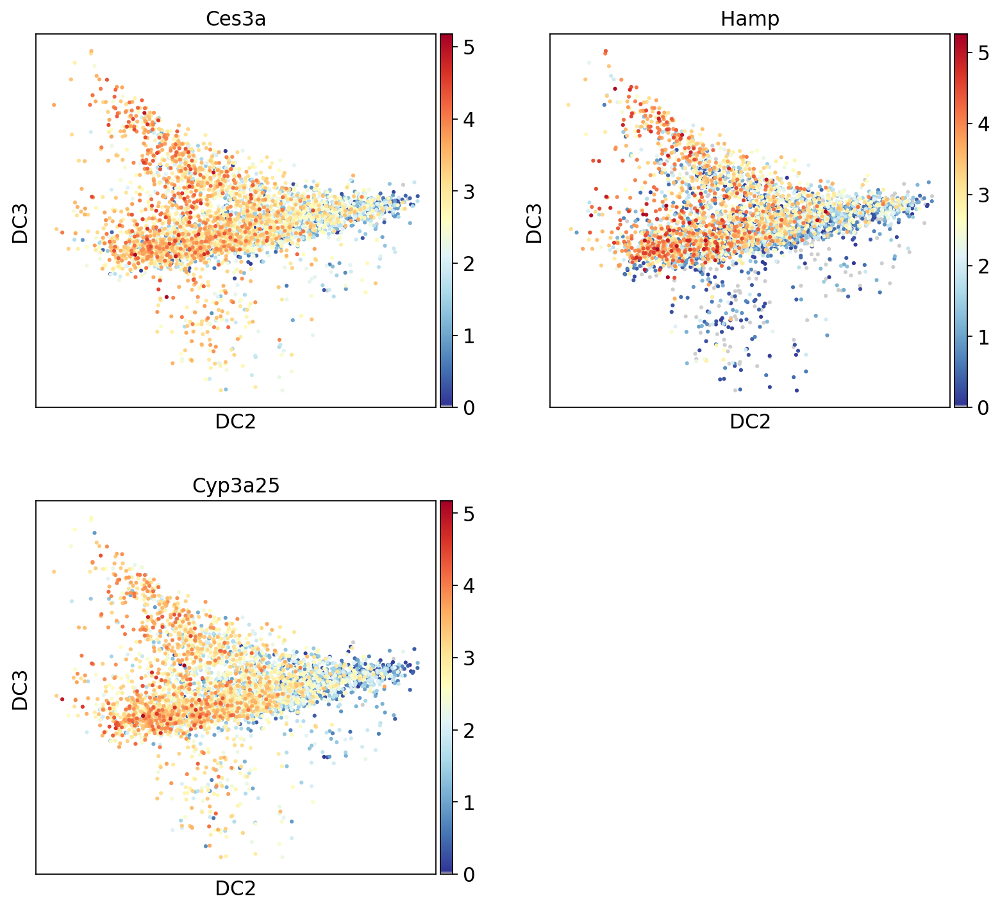

In [71]:
sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name',
              color=non_zonated, ncols=2, color_map=mymap, 
             # save='_'+today+'_zonation_hepatocytes_nonzonated_genes_DC12_DPT_thresholded.pdf'
             )
sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name',use_raw=True, 
              color=non_zonated, ncols=2, color_map=mymap, components=[2,3], 
             # save='_'+today+'_zonation_hepatocytes_nonzonated_genes_DC23_DPT_thresholded.pdf'
             )

Plot fatty acid metabolism genes.

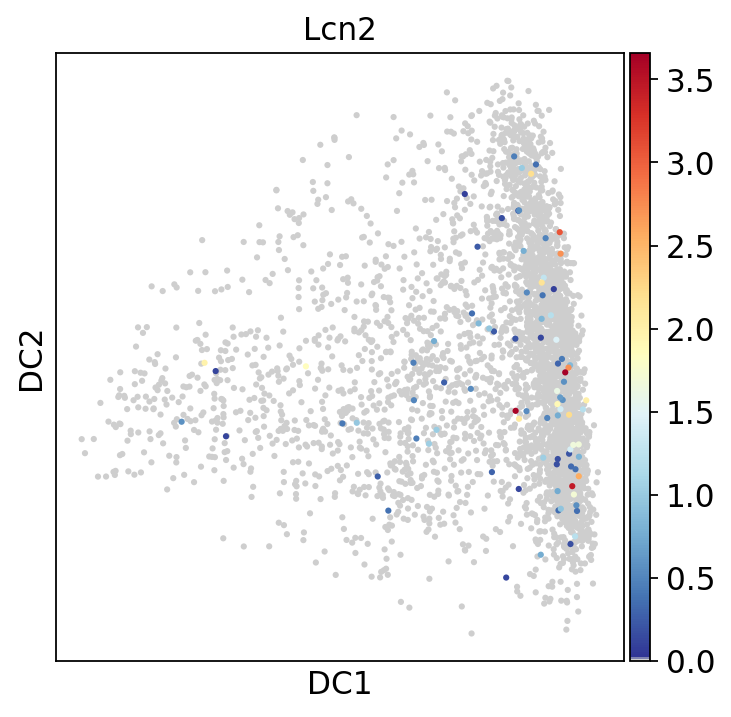

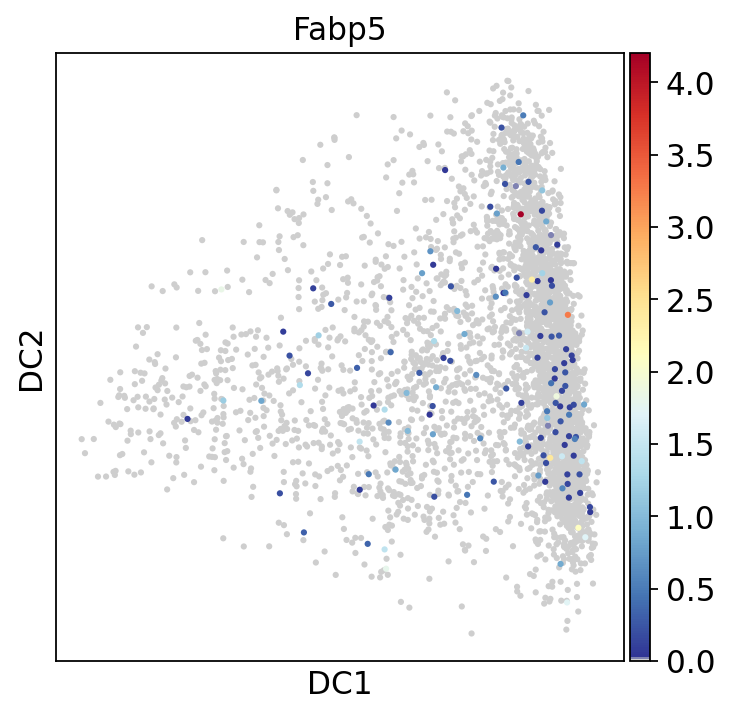

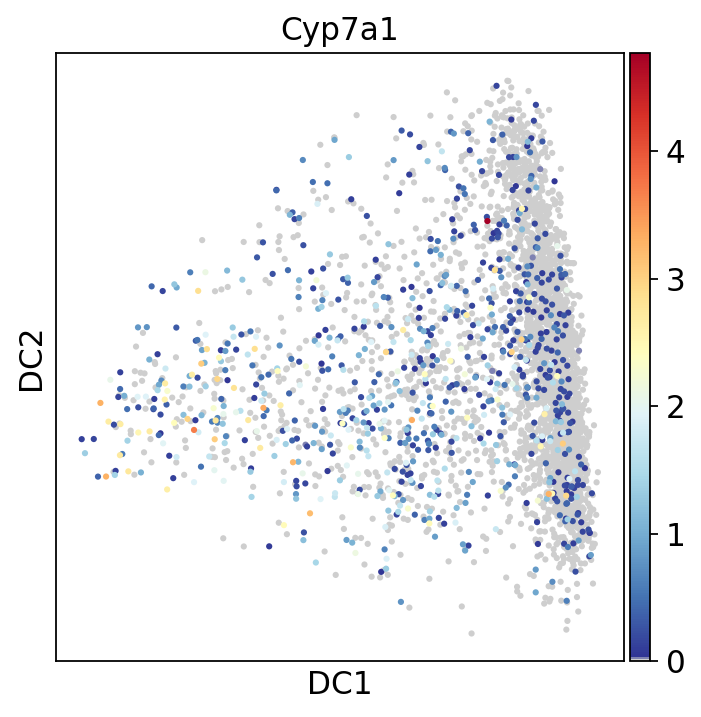

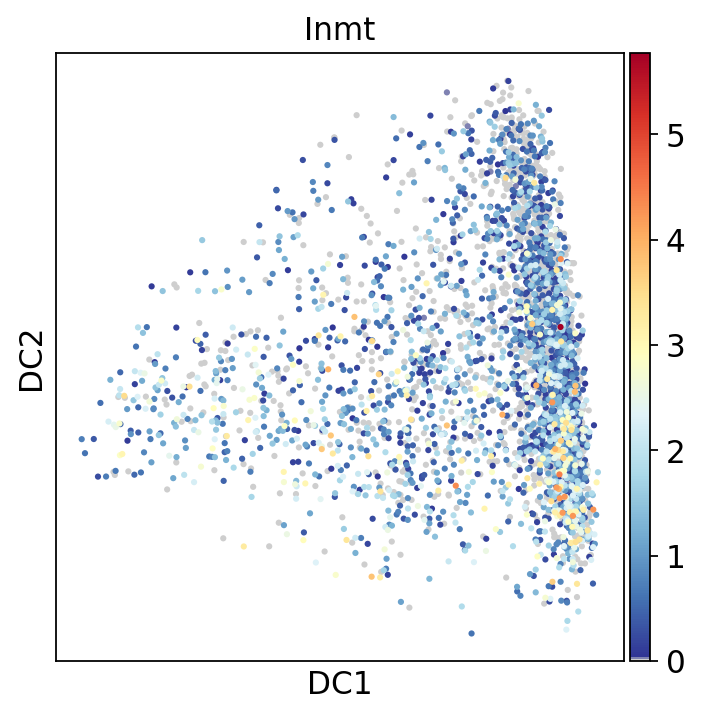

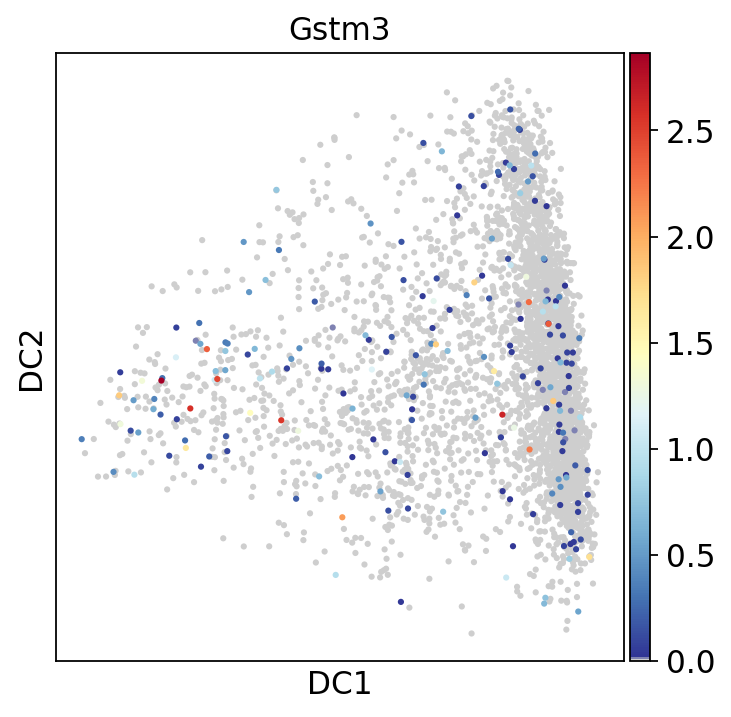

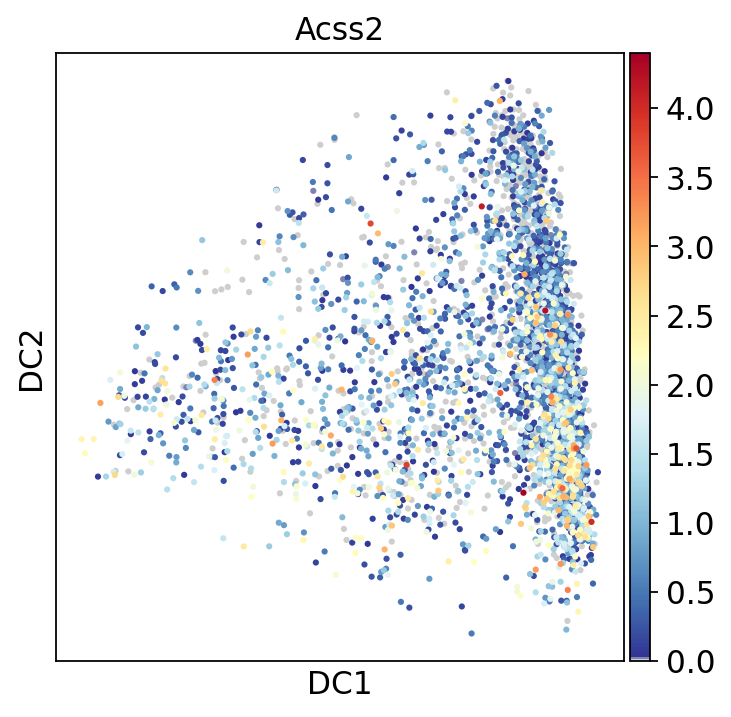

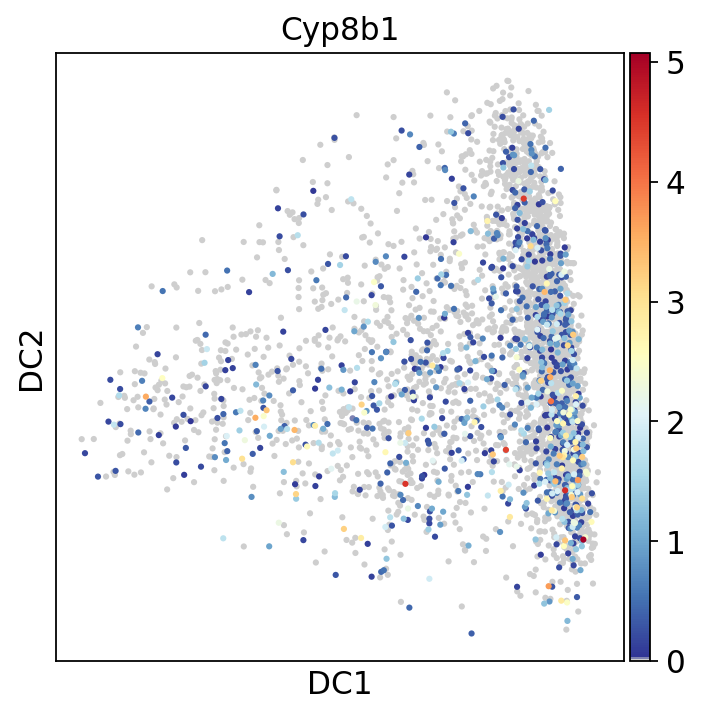

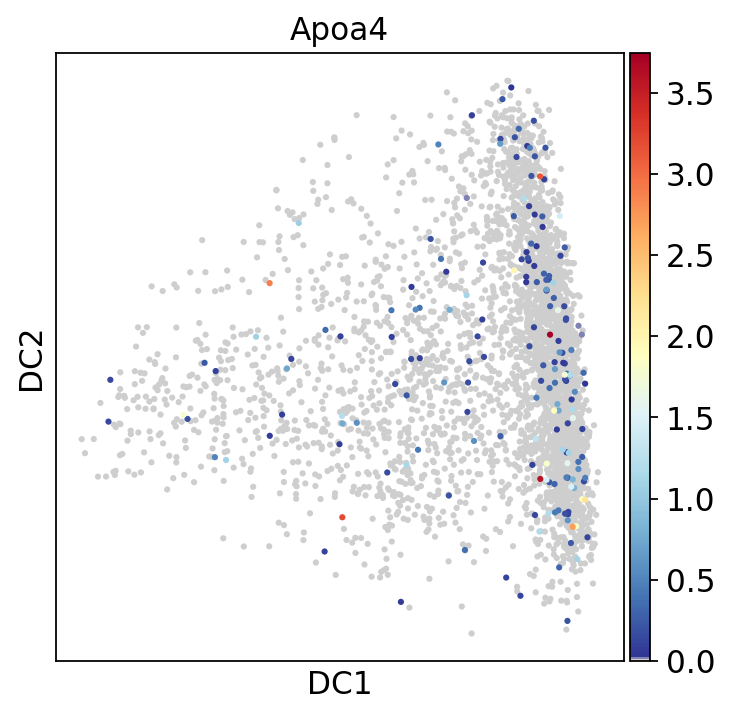

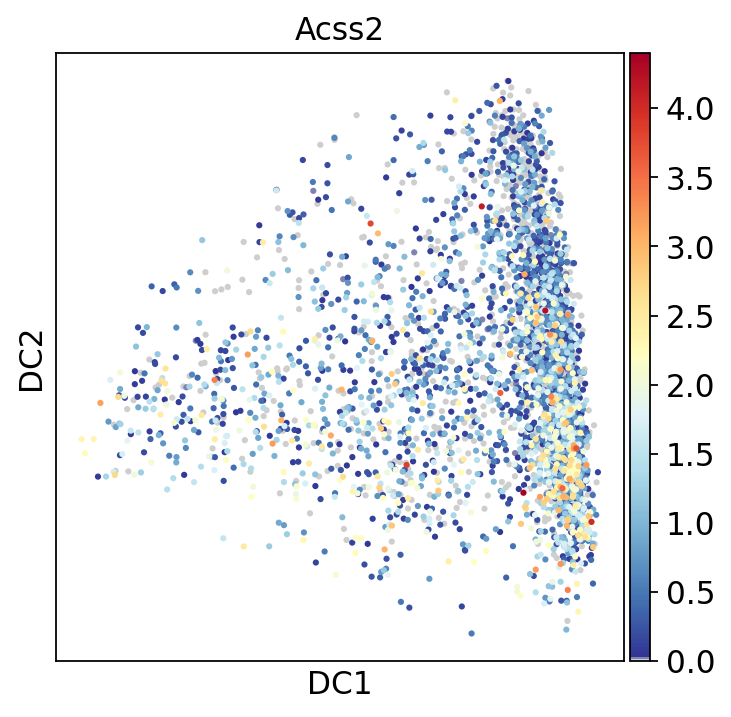

In [105]:
rcParams['figure.figsize']=(5,5)
for gene in fatty_acid_list:
    if gene in adata_hepzDPT.var['gene_name'].values:
        sc.pl.diffmap(adata_hepzDPT, gene_symbols='gene_name',use_raw=True, 
              color=gene, ncols=2, color_map=mymap, components=[1,2], 
              save=f'_{today}_zonation_hepatocytes_fatty-acid-list_{gene}_DC12_DPT_thresholded.pdf'
             )

Determine root cell in the periportal region.

In [83]:
DC1 = adata_hepzDPT.obsm['X_diffmap'][:, 1]

In [84]:
adata_hepzDPT.uns['iroot'] = np.argmin(DC1)

In [85]:
sc.tl.dpt(adata_hepzDPT)

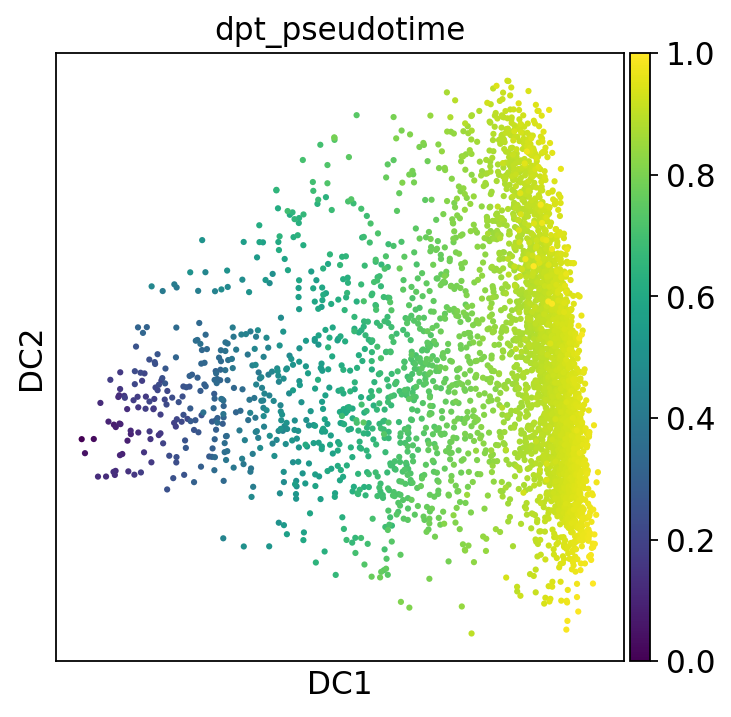

In [86]:
rcParams['figure.figsize']=(5,5)
sc.pl.diffmap(adata_hepzDPT, color='dpt_pseudotime',
             # save = today + '_dpt_DPT_thresholded'
             )

Let us check how the pseudotime values are distributed.

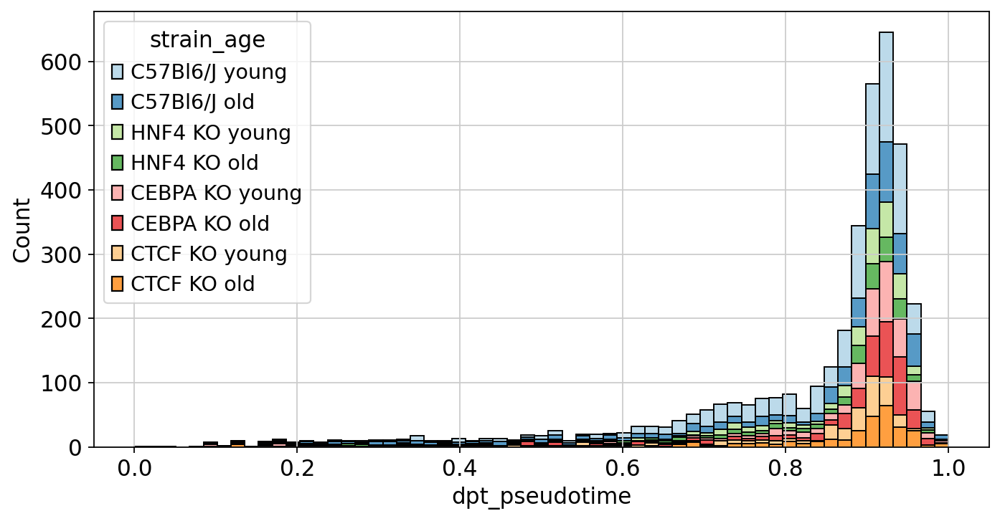

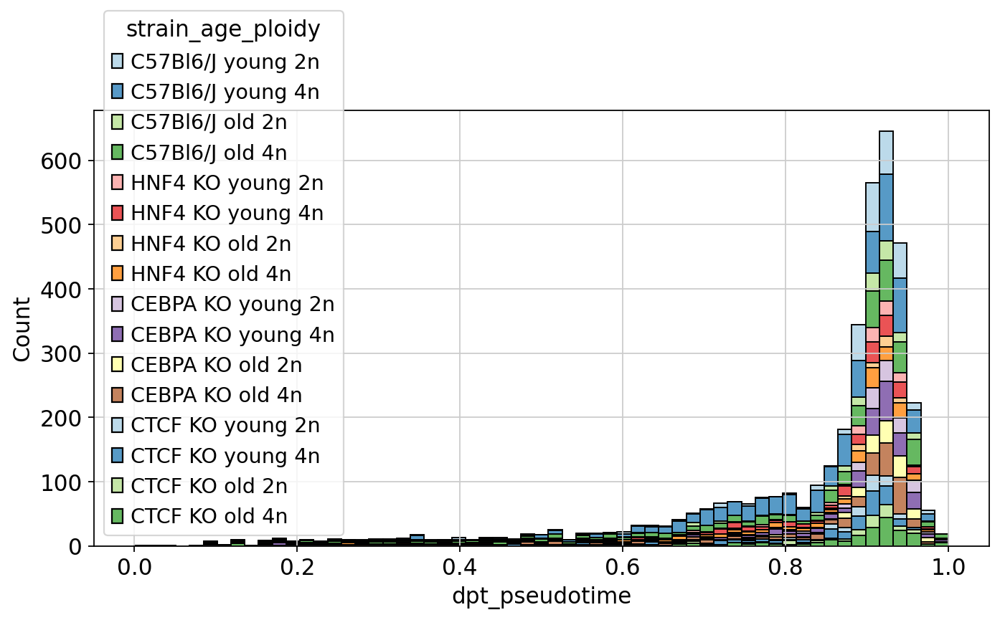

In [76]:
rcParams['figure.figsize']=(10,5)
ax = sns.histplot(x=adata_hepzDPT.obs["dpt_pseudotime"], hue=adata_hepzDPT.obs['strain_age'], palette='Paired', multiple="stack")
#plt.savefig('./figures/histogram_' + today + '_strain_age_DPT_thresholded.pdf')
plt.show()
ax1 = sns.histplot(x=adata_hepzDPT.obs["dpt_pseudotime"], hue=adata_hepzDPT.obs['strain_age_ploidy'], palette='Paired',multiple="stack")
#plt.savefig('./figures/histogram_' + today + '_strain_age_ploidy_DPT_thresholded.pdf')
plt.show()

Aggregate for the binned pseudotime visualisation.

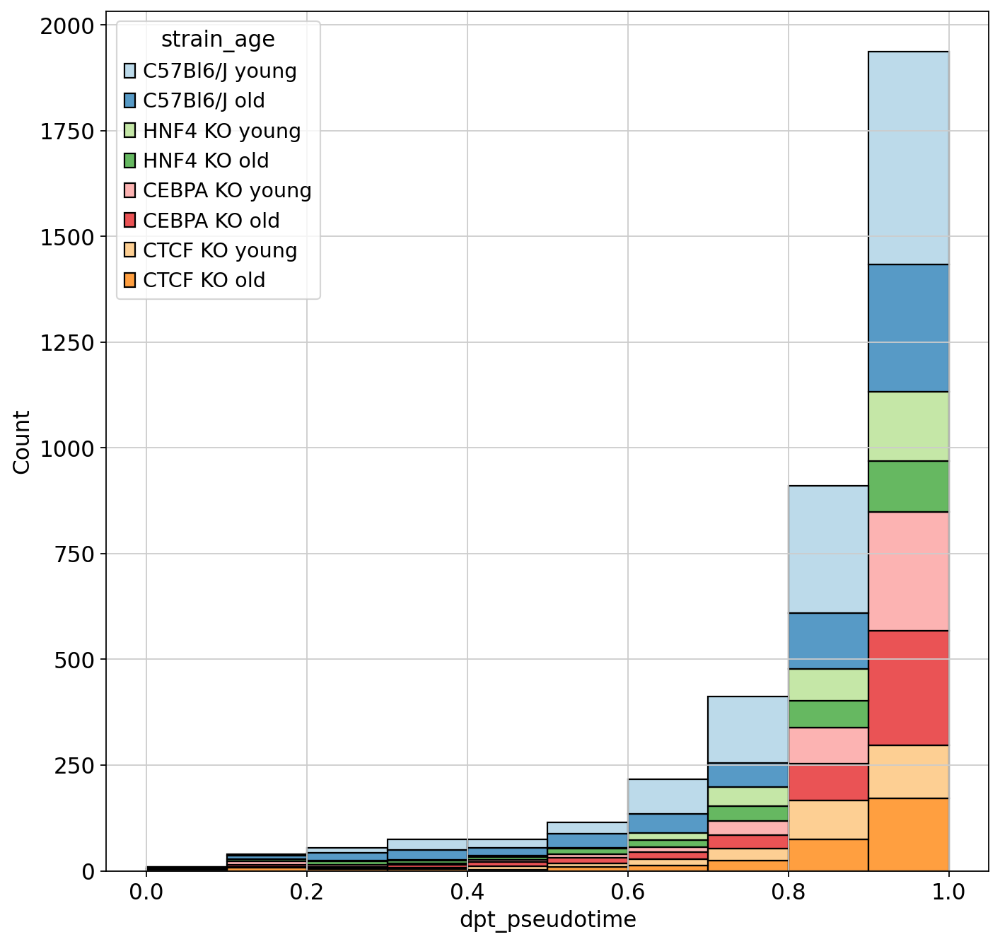

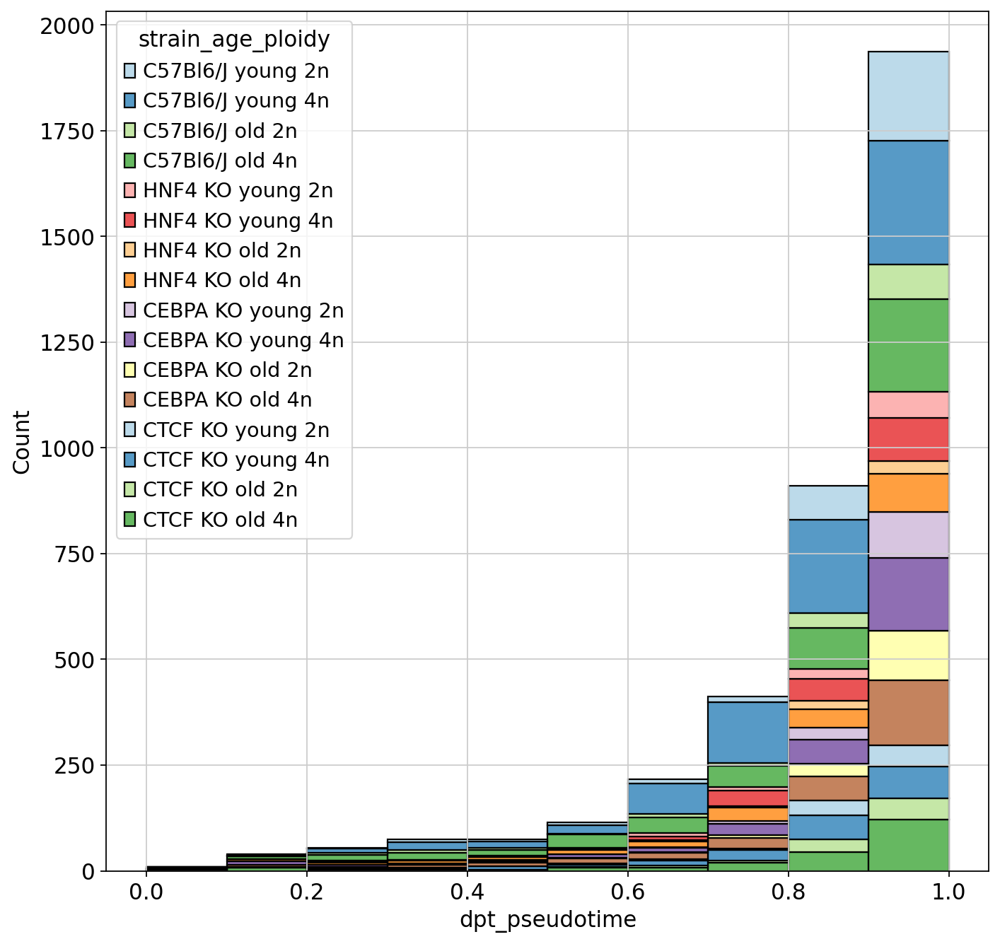

In [77]:
rcParams['figure.figsize']=(10,10)
ax = sns.histplot(x=adata_hepzDPT.obs["dpt_pseudotime"], hue=adata_hepzDPT.obs['strain_age'],
                  palette='Paired', multiple="stack",
                 bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6,0.7, 0.8,0.9, 1]
                 )
#plt.savefig('./figures/histogram_' + today + '_binned_strain_age_DPT_thresholded.pdf')
plt.show()
ax1 = sns.histplot(x=adata_hepzDPT.obs["dpt_pseudotime"], hue=adata_hepzDPT.obs['strain_age_ploidy'], 
                   palette='Paired',multiple="stack",
                   bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6,0.7, 0.8,0.9, 1]
                  )
#plt.savefig('./figures/histogram_' + today + '_binned_strain_age_ploidy_DPT_thresholded.pdf')
plt.show()

**Conclusion:** We observe a skewed distribution of cells along pseudotime, with many cells from the periportal region, coming from all strains and ages.

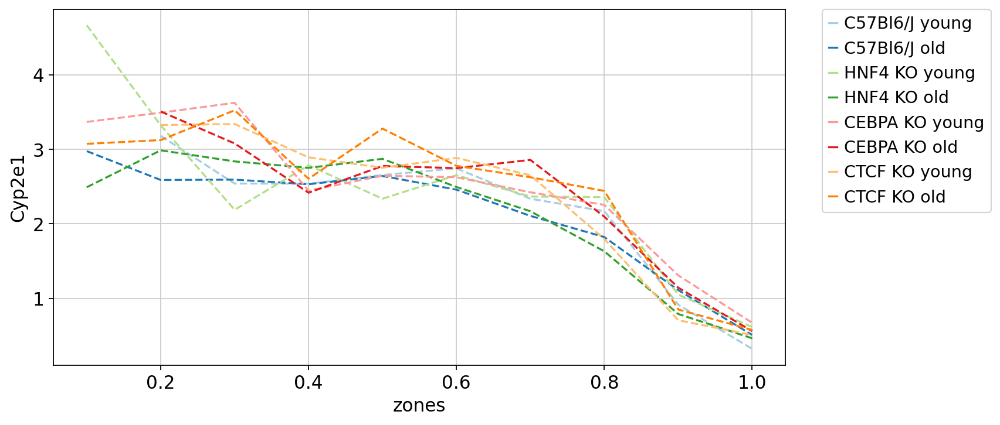

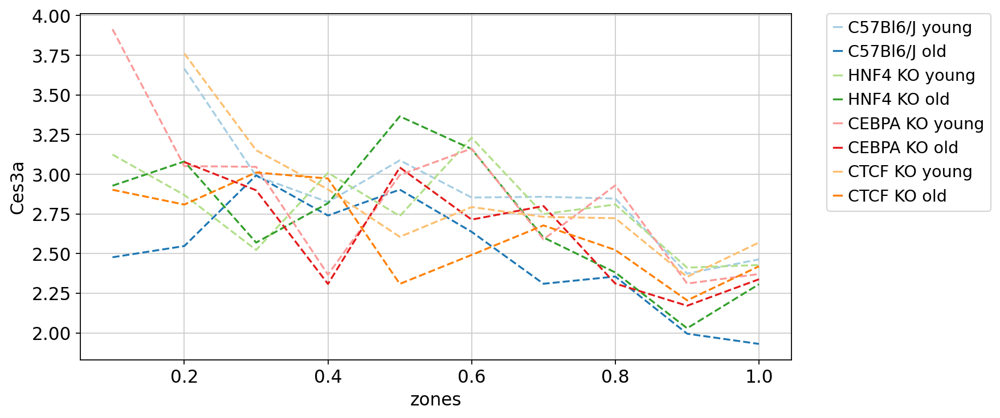

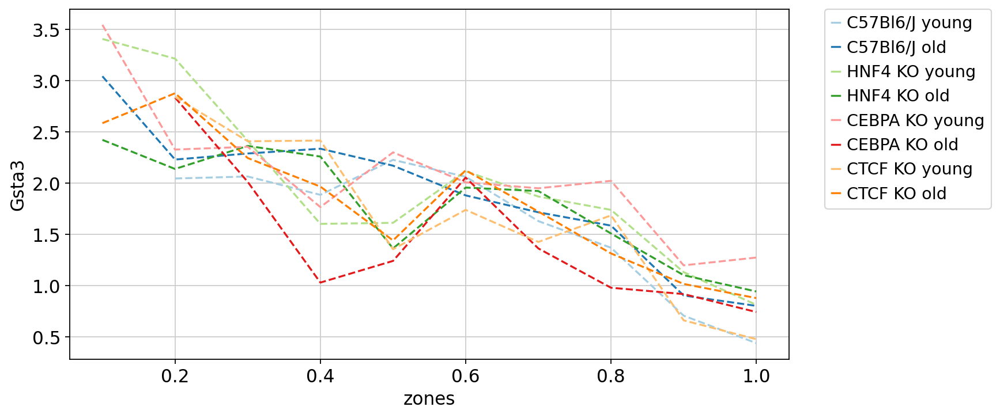

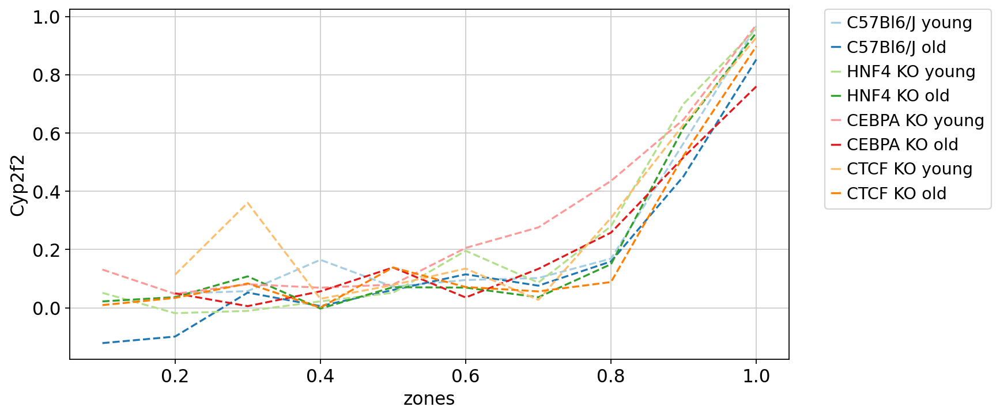

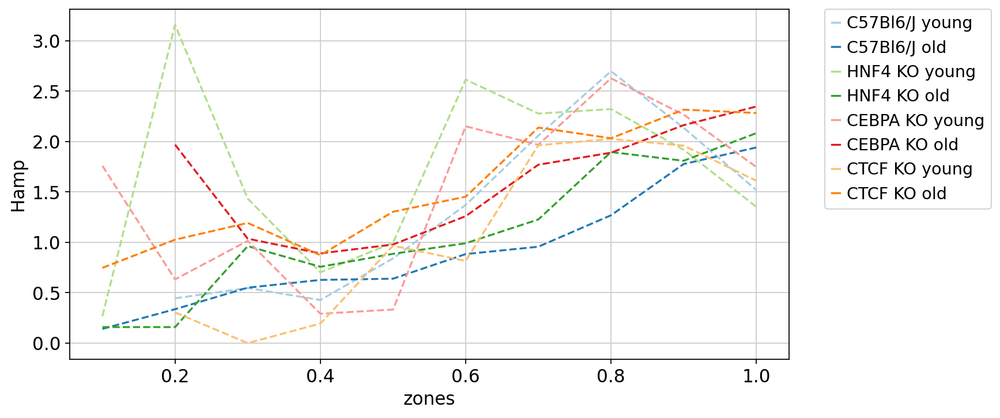

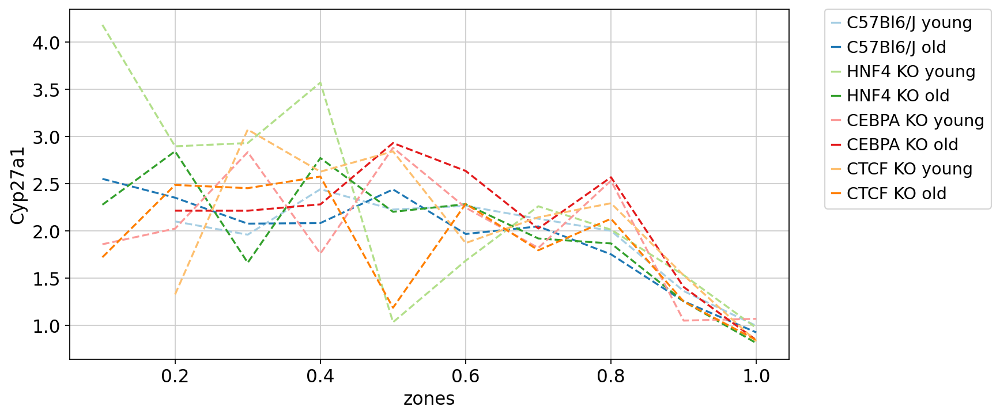

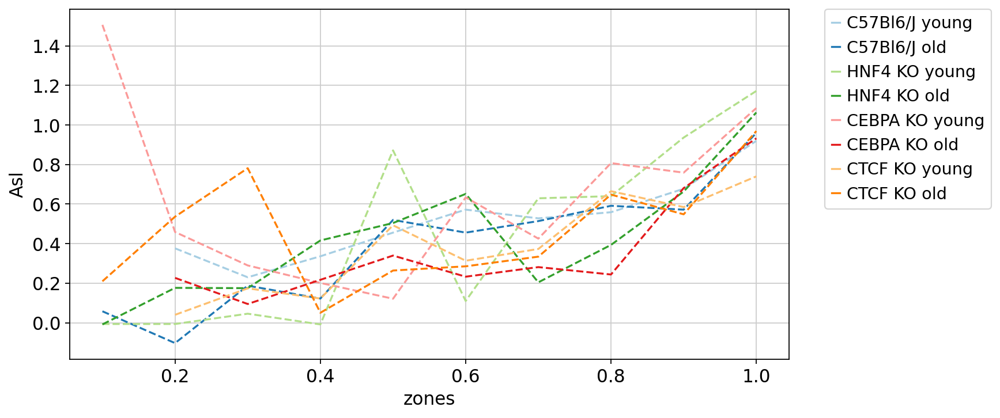

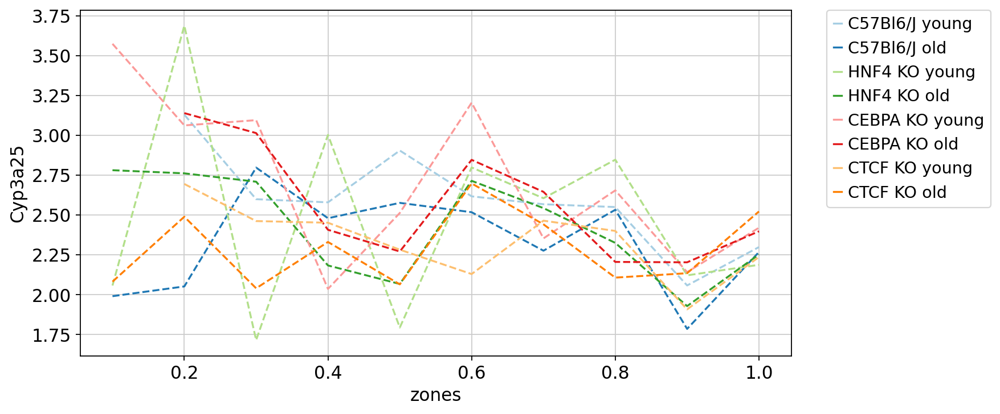

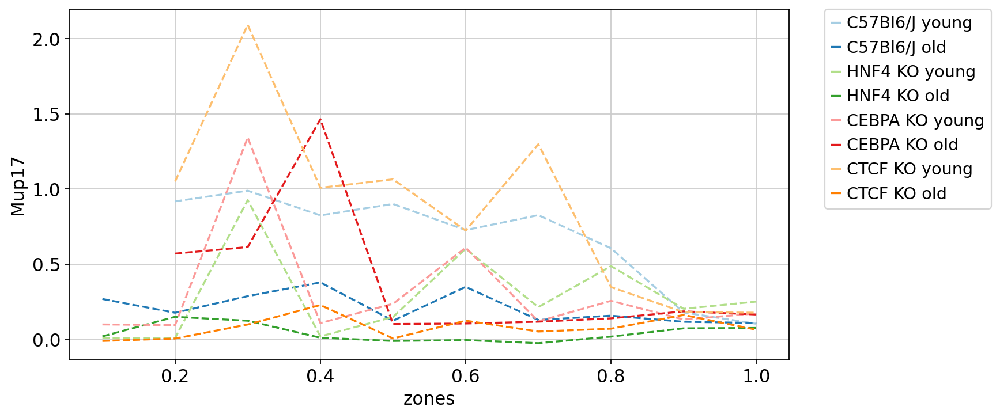

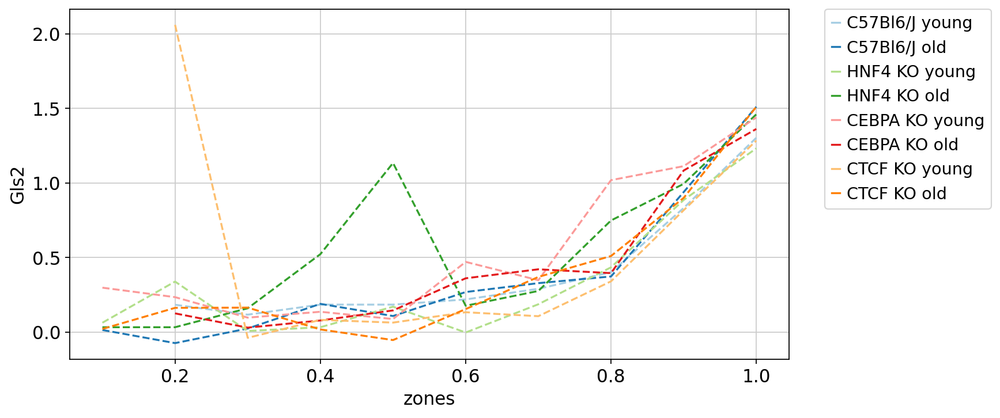

In [90]:
for gene in genes:
   # df = pd.DataFrame()
    df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age': []})
    for level in adata_hepzDPT.obs["strain_age"].cat.categories:
        df_tmp = pd.DataFrame()
        adata_sub = adata_hepzDPT[adata_hepzDPT.obs['strain_age']==level].copy()
        df_tmp["dpt"] = adata_sub.obs["dpt_pseudotime"]
        df_tmp["strain_age"] = adata_sub.obs["strain_age"]

        df_tmp[gene] = np.array(adata_sub[:,adata_sub.var['gene_name']==gene].X)
        bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6,0.7, 0.8,0.9, 1]
        labels = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
        df_tmp['zones'] = pd.cut(df_tmp['dpt'], bins=bins, labels=labels)
        df2_tmp = df_tmp.groupby(df_tmp["zones"]).mean() 
        df2_tmp['zones'] = labels
        df2_tmp['strain_age'] = level
        df2 = df2.append(df2_tmp, ignore_index=True)
   
    sns.lineplot(data=df2, x='zones', y=gene, hue='strain_age', palette='Paired', linestyle='--')
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.savefig('./figures/'+ today + '_zonation_DPT_thresholded_'  + 
                '_' +gene +'.pdf', bbox_inches='tight')
    plt.show()

Plot the same gene expression pattern by ploidy.

In [108]:
color_list = sns.color_palette('Paired',8)

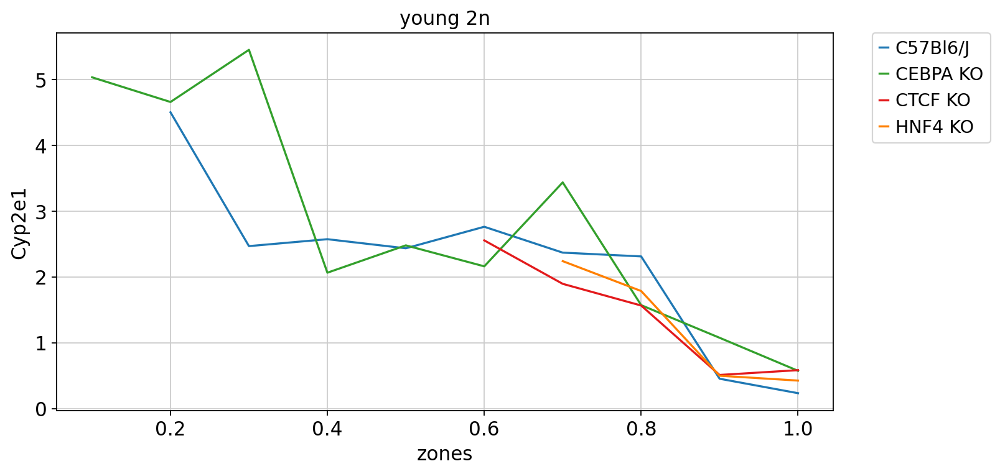

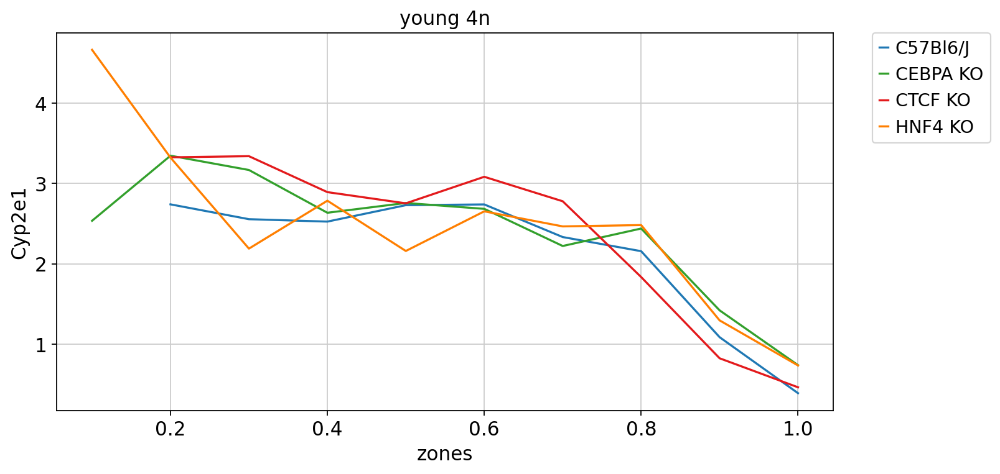

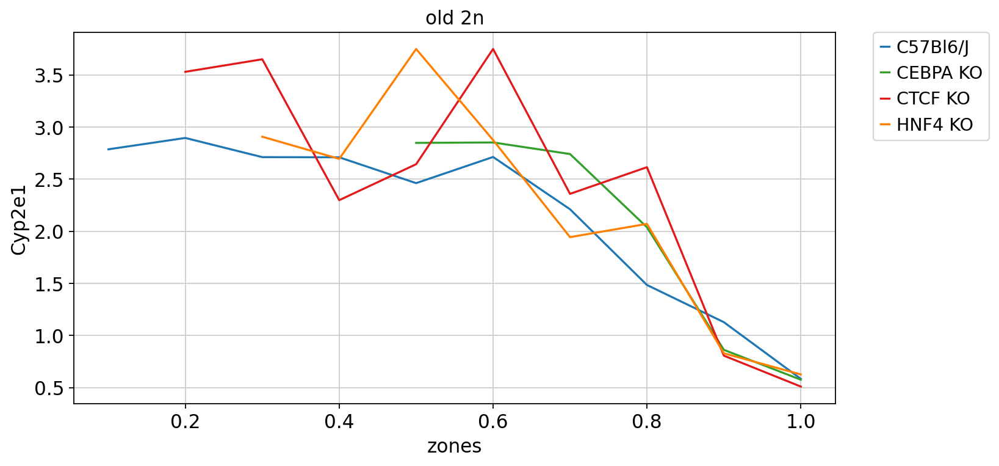

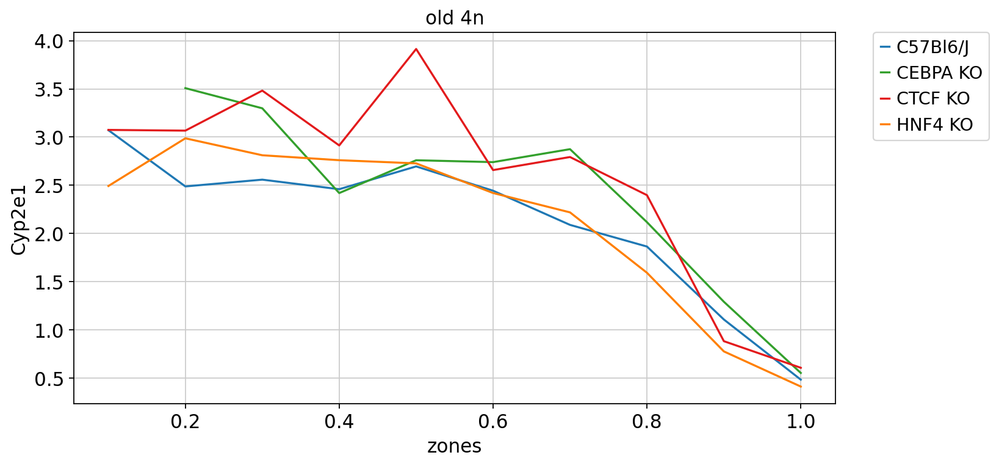

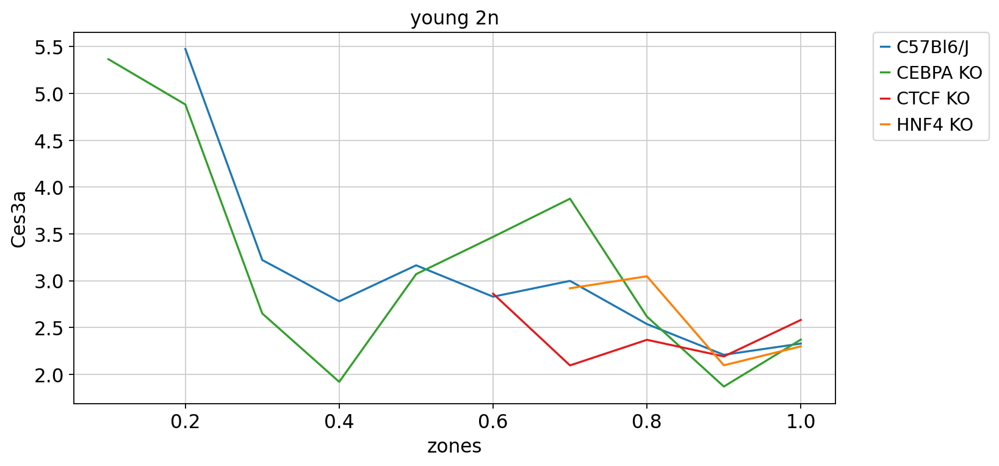

...

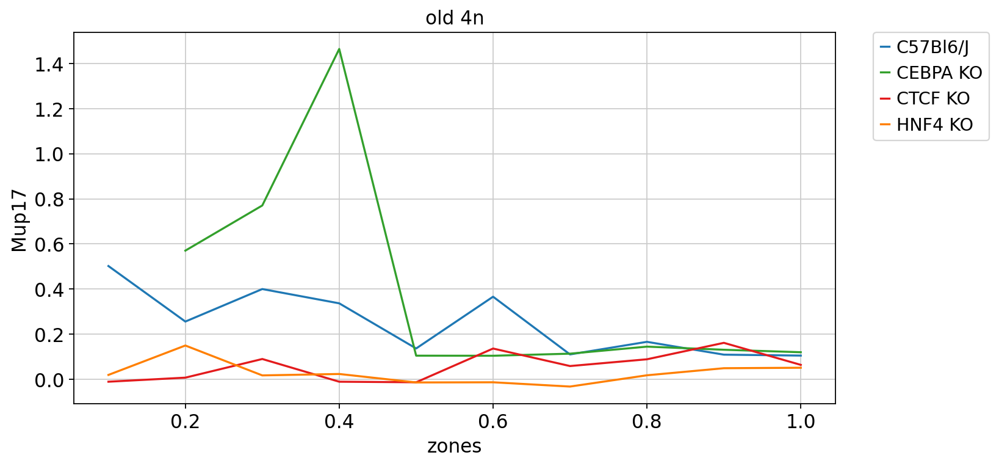

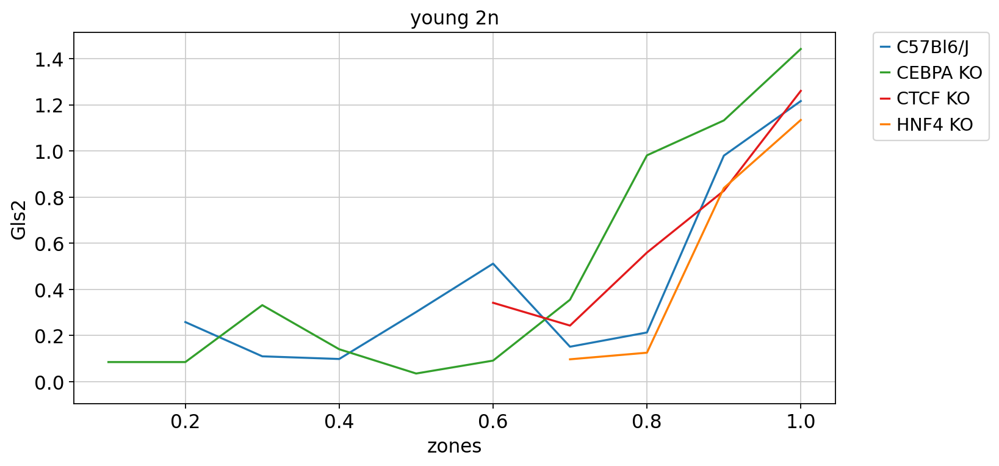

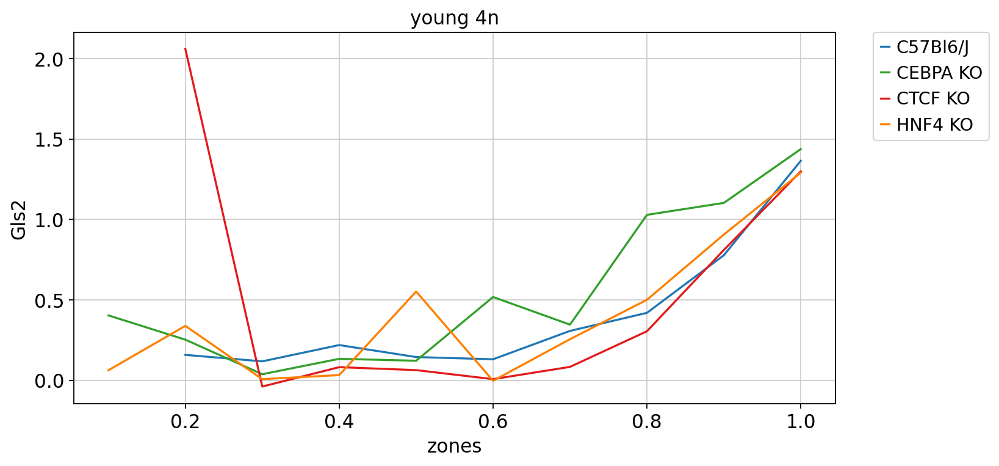

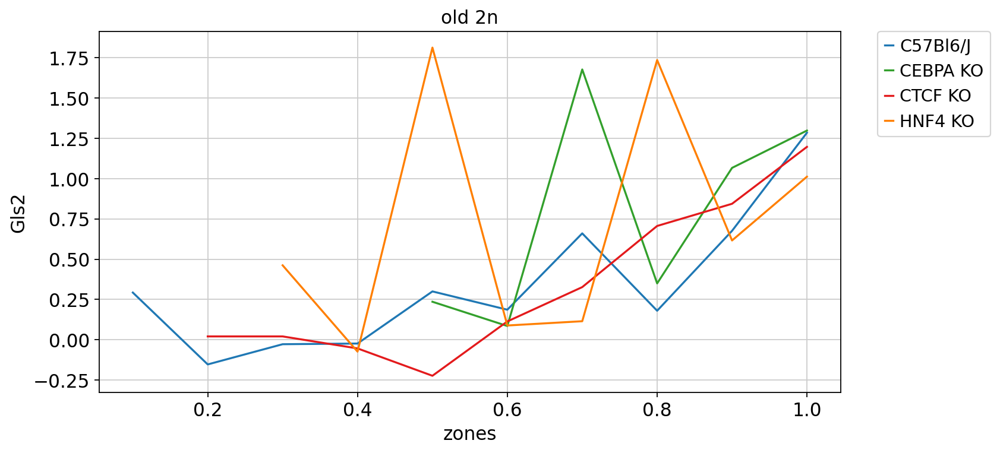

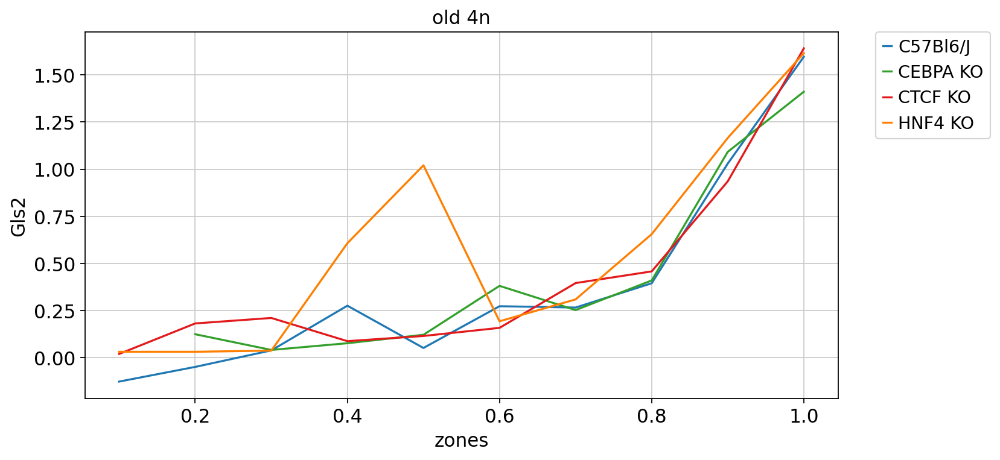

In [116]:
for gene in genes:
   # df = pd.DataFrame()
    #df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age_ploidy': []})
    for level in adata_hepzDPT.obs["age_ploidy"].cat.categories:
        
        df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age_ploidy': []})
        adata_sub2 = adata_hepzDPT[adata_hepzDPT.obs['age_ploidy']==level].copy()
        for level2 in adata_sub2.obs['strain'].cat.categories:
            df_tmp = pd.DataFrame()
            adata_sub = adata_sub2[adata_sub2.obs['strain']==level2].copy()
            df_tmp["dpt"] = adata_sub.obs["dpt_pseudotime"]
            df_tmp["strain"] = adata_sub.obs["strain"]

            df_tmp[gene] = np.array(adata_sub[:,adata_sub.var['gene_name']==gene].X)
            bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6,0.7, 0.8,0.9, 1]
            labels = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
            df_tmp['zones'] = pd.cut(df_tmp['dpt'], bins=bins, labels=labels)
            df2_tmp = df_tmp.groupby(df_tmp["zones"]).mean() 
            df2_tmp['zones'] = labels
            df2_tmp['age_ploidy'] = level2
            df2_tmp['strain'] =level2
            df2 = df2.append(df2_tmp, ignore_index=True)
   
        sns.set_palette(sns.color_palette(color_list[1:][::2])) #use every second value
        sns.lineplot(data=df2, x='zones', y=gene, hue='age_ploidy')
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        plt.title(level)
        plt.savefig('./figures/'+ today + '_zonation_DPT_thresholded_ploidy_' + 
                    level.replace('/','').replace(' ', '_') +
                    '_' + gene +'.pdf', bbox_inches='tight')
        plt.show()

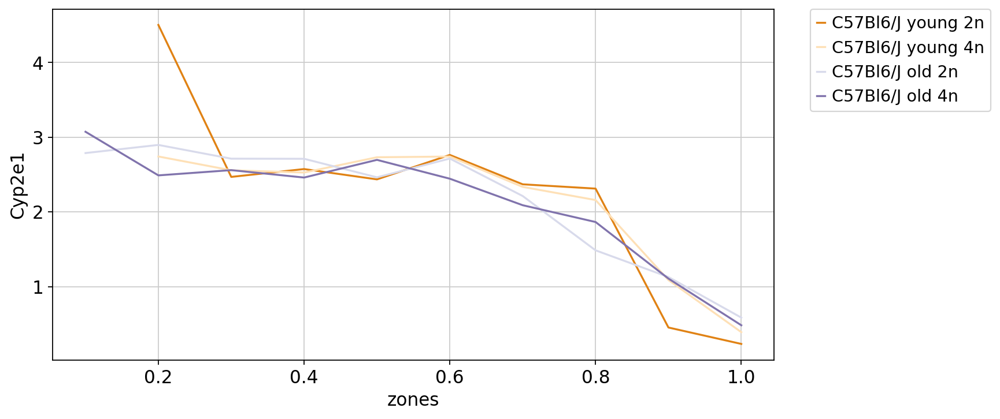

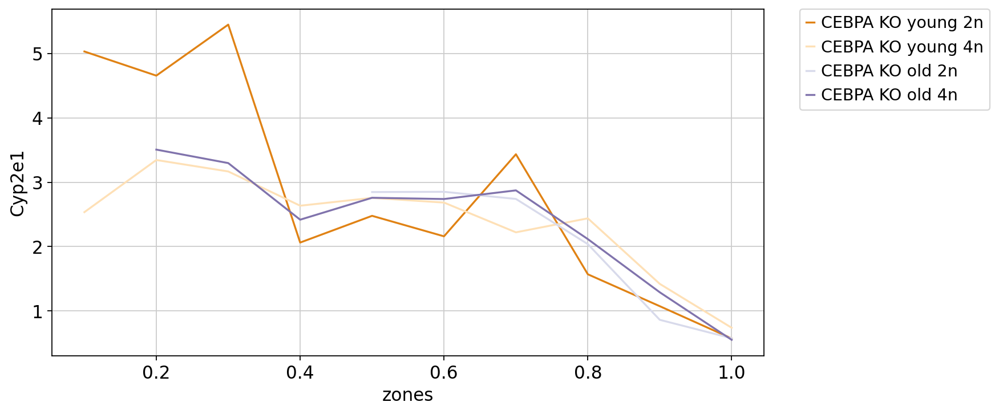

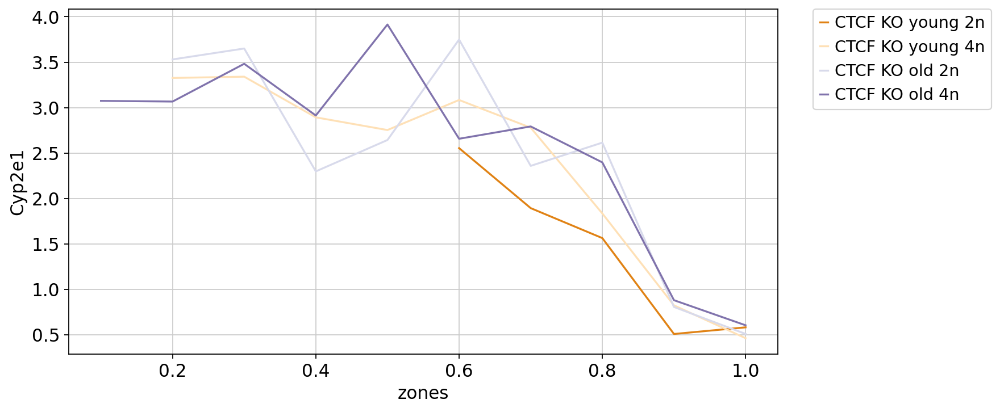

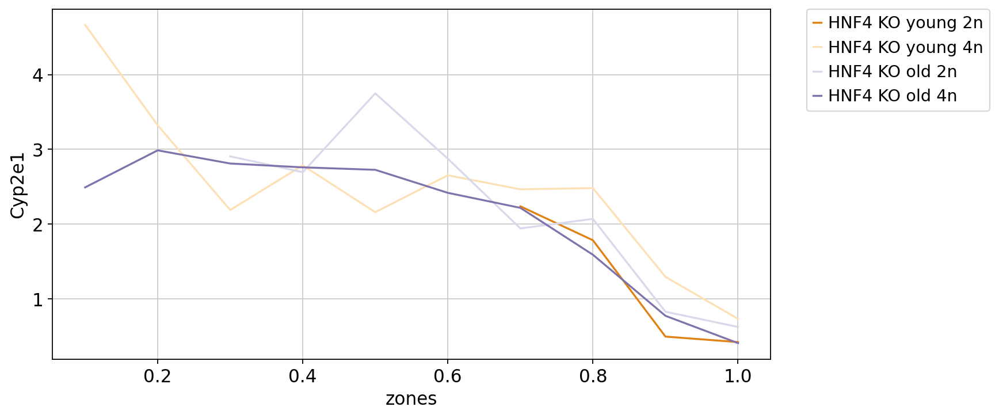

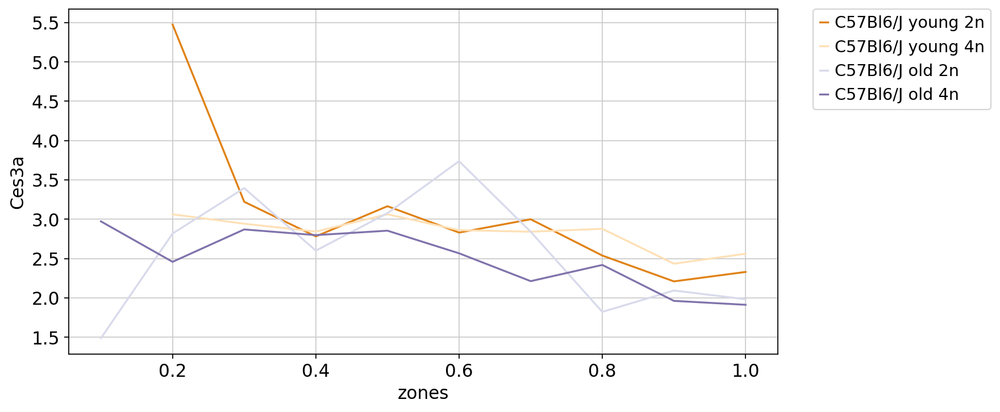

...

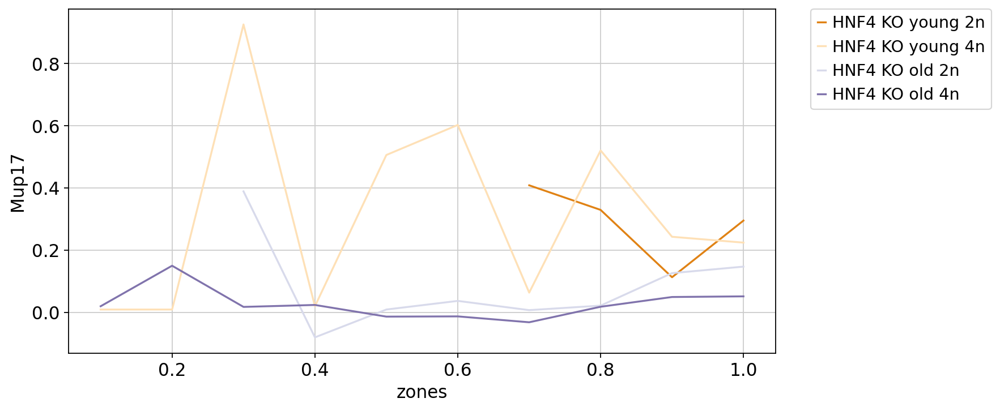

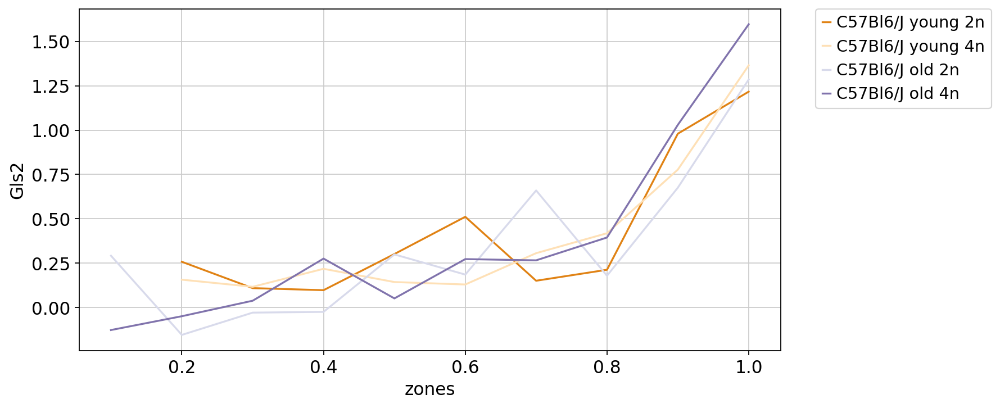

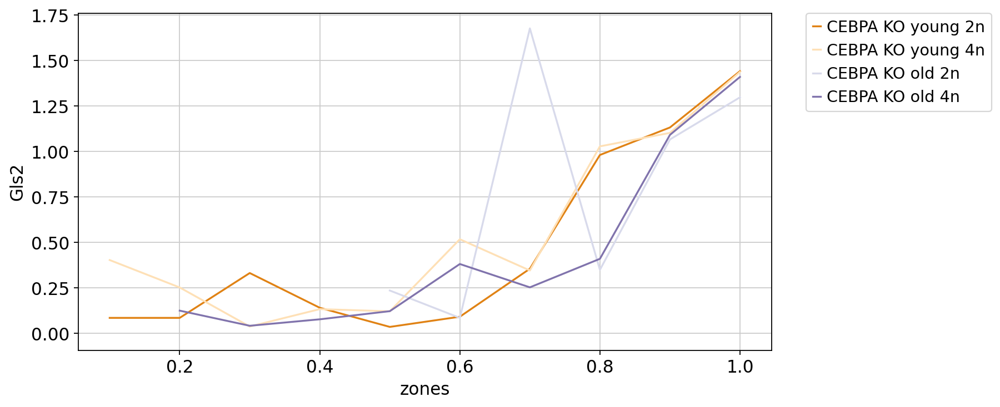

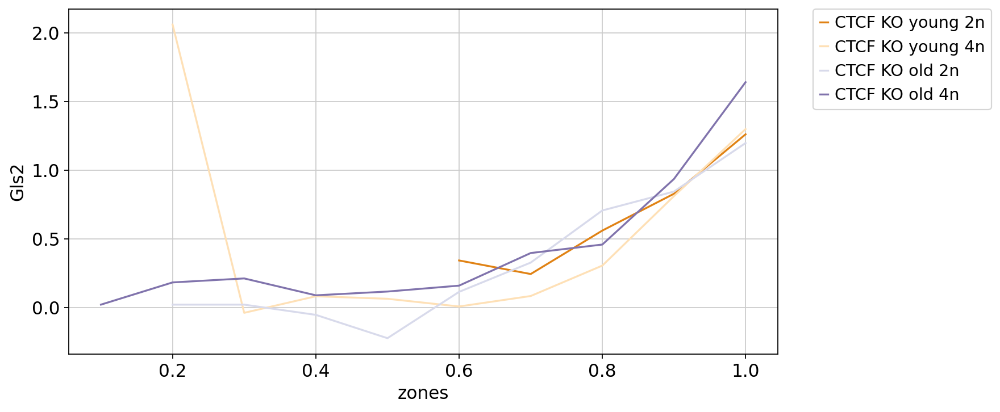

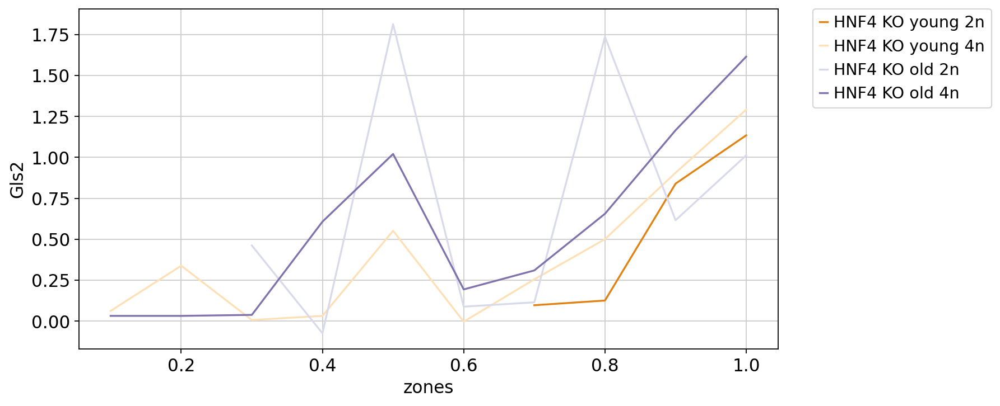

In [95]:
for gene in genes:
   # df = pd.DataFrame()
    df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age_ploidy': []})
    for level in adata_hepzDPT.obs["strain"].cat.categories:
        
        df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age_ploidy': []})
        adata_sub2 = adata_hepzDPT[adata_hepzDPT.obs['strain']==level].copy()
        for level2 in adata_sub2.obs['strain_age_ploidy'].cat.categories:
            df_tmp = pd.DataFrame()
            adata_sub = adata_sub2[adata_sub2.obs['strain_age_ploidy']==level2].copy()
            df_tmp["dpt"] = adata_sub.obs["dpt_pseudotime"]
            df_tmp["strain_age_ploidy"] = adata_sub.obs["strain_age_ploidy"]

            df_tmp[gene] = np.array(adata_sub[:,adata_sub.var['gene_name']==gene].X)
            bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6,0.7, 0.8,0.9, 1]
            labels = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
            df_tmp['zones'] = pd.cut(df_tmp['dpt'], bins=bins, labels=labels)
            df2_tmp = df_tmp.groupby(df_tmp["zones"]).mean() 
            df2_tmp['zones'] = labels
            df2_tmp['strain_age_ploidy'] = level2
            df2_tmp['strain'] =level
            df2 = df2.append(df2_tmp, ignore_index=True)
   
        sns.lineplot(data=df2, x='zones', y=gene, hue='strain_age_ploidy', palette='PuOr')
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        plt.savefig('./figures/'+ today + '_zonation_DPT_thresholded_ploidy_' + 
                    level.replace('/','').replace(' ', '_') +
                    '_' + gene +'.pdf', bbox_inches='tight')
        plt.show()

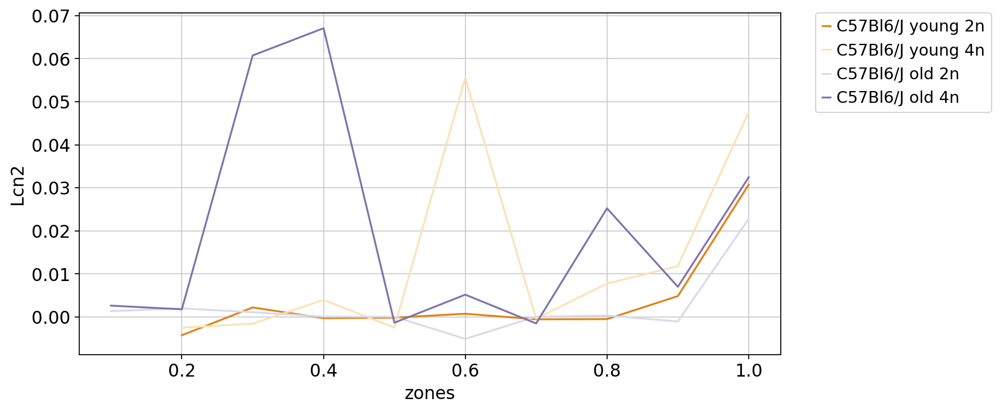

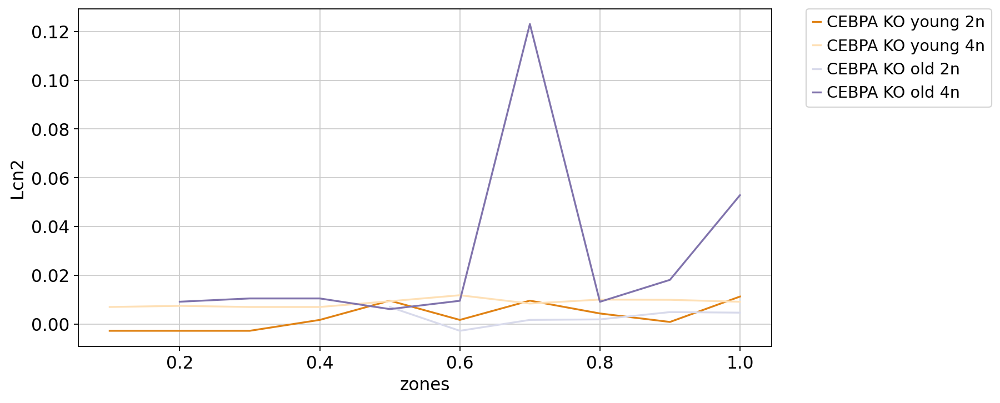

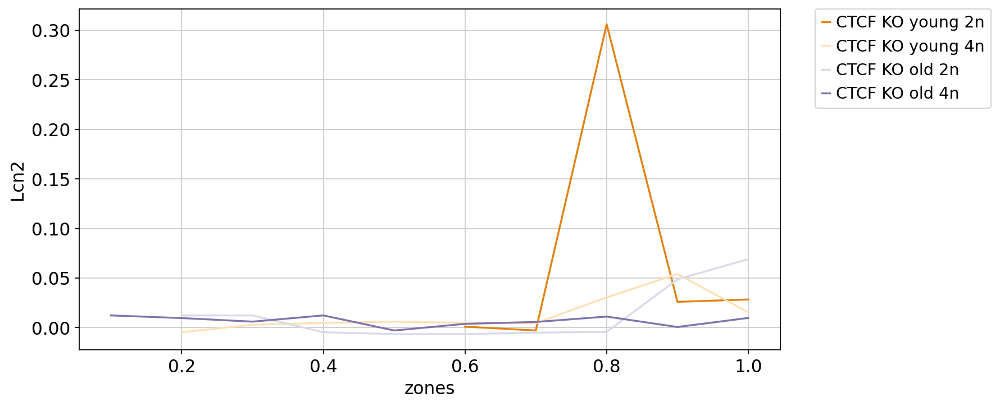

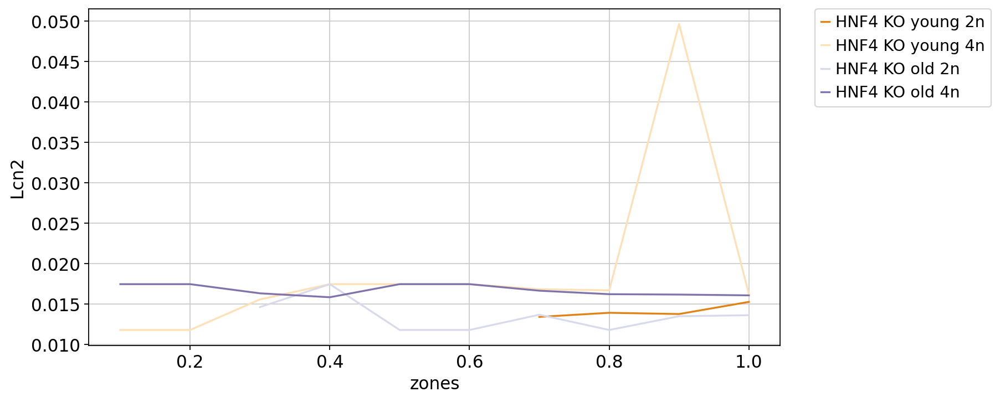

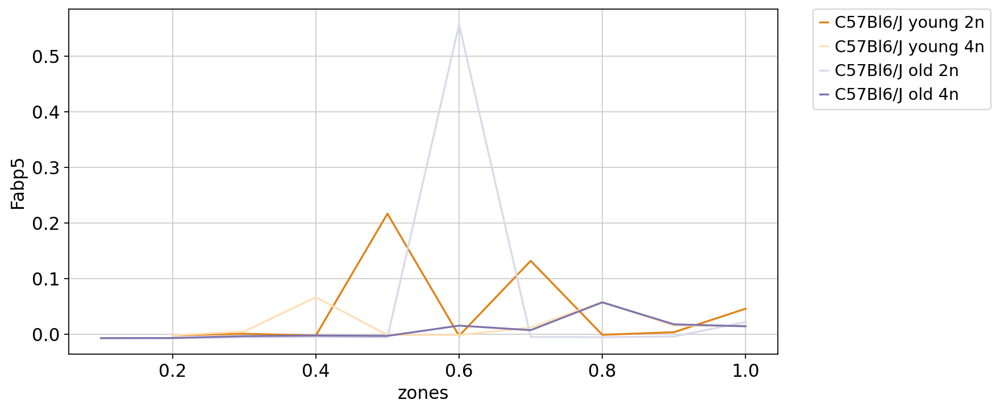

...

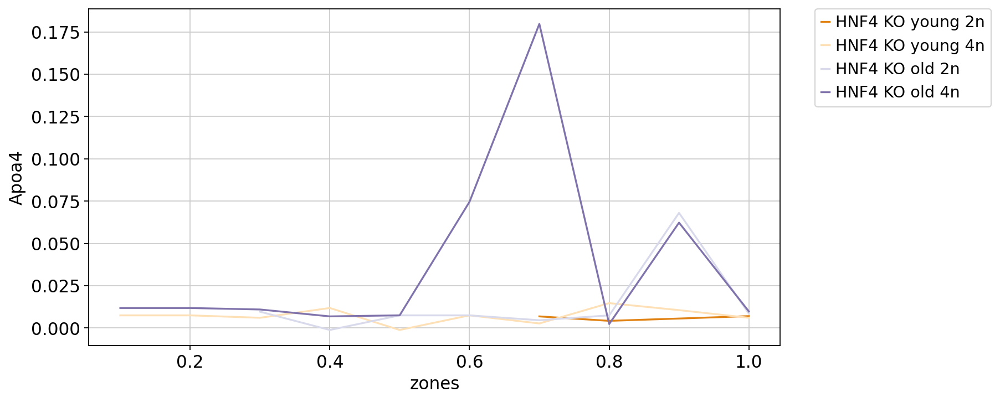

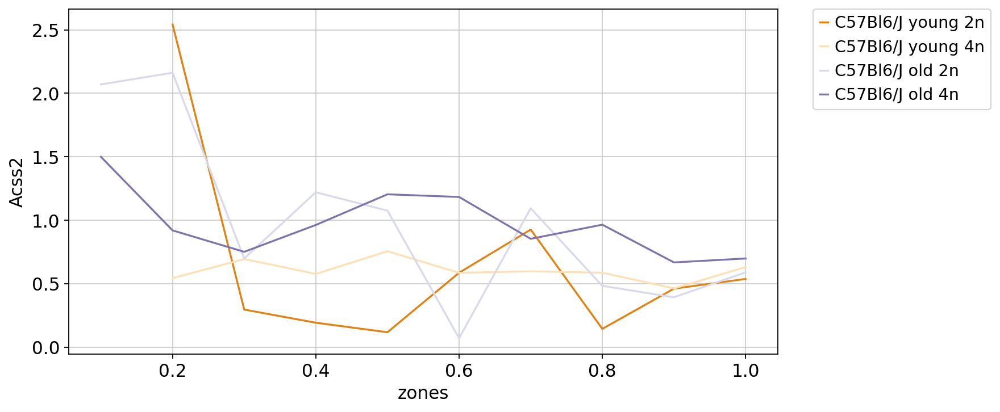

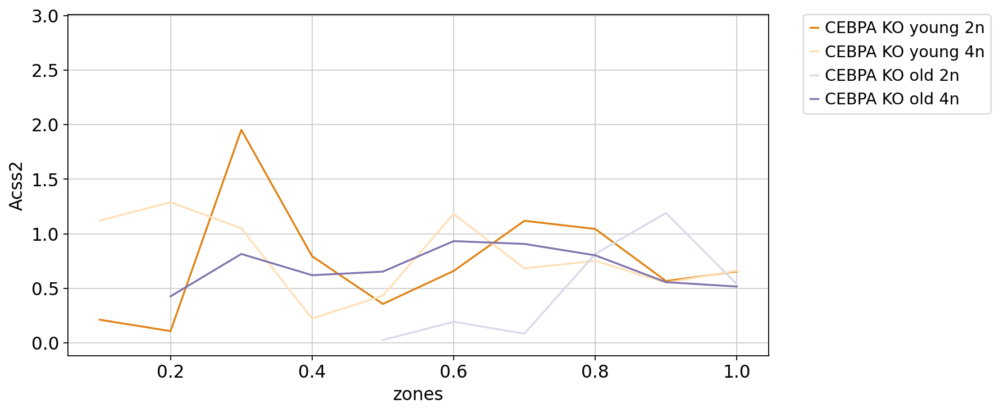

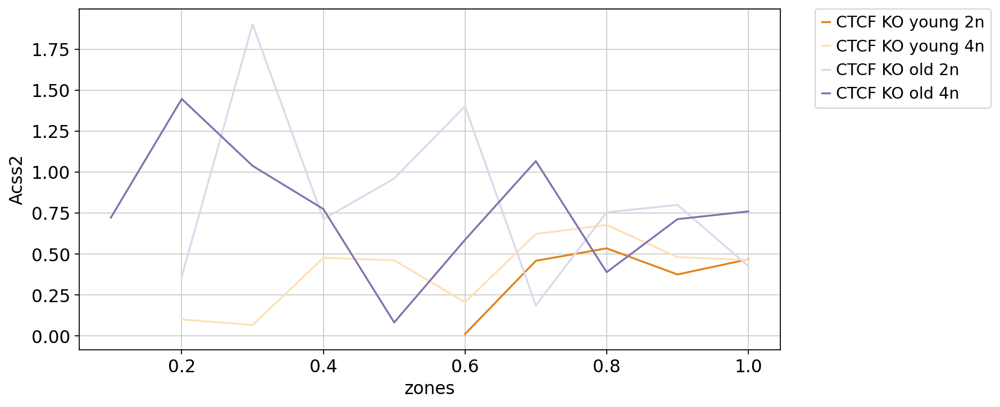

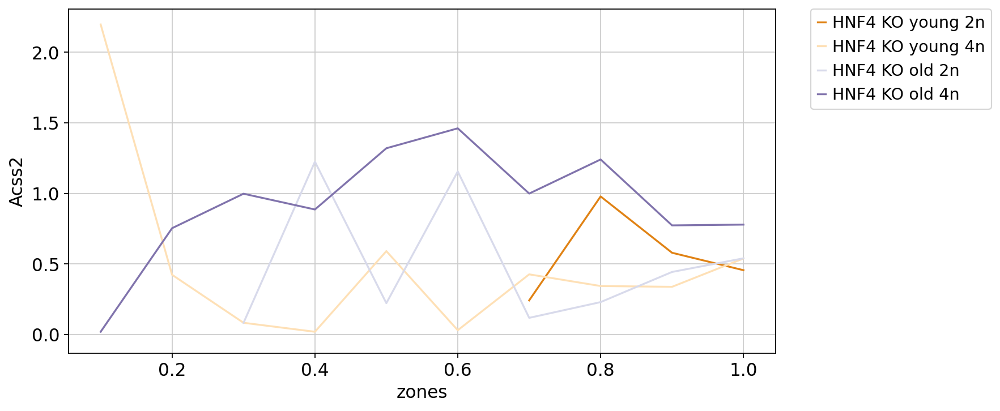

In [106]:
rcParams['figure.figsize']=(10,5)
for gene in fatty_acid_list:
    if gene not in adata_hepzDPT.var['gene_name'].values:
        continue
   # df = pd.DataFrame()
    df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age_ploidy': []})
    for level in adata_hepzDPT.obs["strain"].cat.categories:
        
        df2 = pd.DataFrame({'dpt':[],gene:[], 'zones': [],'strain_age_ploidy': []})
        adata_sub2 = adata_hepzDPT[adata_hepzDPT.obs['strain']==level].copy()
        for level2 in adata_sub2.obs['strain_age_ploidy'].cat.categories:
            df_tmp = pd.DataFrame()
            adata_sub = adata_sub2[adata_sub2.obs['strain_age_ploidy']==level2].copy()
            df_tmp["dpt"] = adata_sub.obs["dpt_pseudotime"]
            df_tmp["strain_age_ploidy"] = adata_sub.obs["strain_age_ploidy"]

            df_tmp[gene] = np.array(adata_sub[:,adata_sub.var['gene_name']==gene].X)
            bins = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6,0.7, 0.8,0.9, 1]
            labels = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
            df_tmp['zones'] = pd.cut(df_tmp['dpt'], bins=bins, labels=labels)
            df2_tmp = df_tmp.groupby(df_tmp["zones"]).mean() 
            df2_tmp['zones'] = labels
            df2_tmp['strain_age_ploidy'] = level2
            df2_tmp['strain'] =level
            df2 = df2.append(df2_tmp, ignore_index=True)
   
        sns.lineplot(data=df2, x='zones', y=gene, hue='strain_age_ploidy', palette='PuOr')
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
        plt.savefig('./figures/'+ today + '_zonation_DPT_thresholded_ploidy_' + 
                    level.replace('/','').replace(' ', '_') +
                    '_' + gene +'.pdf', bbox_inches='tight')
        plt.show()

### Diffusion map for wild type only 

Let us compute the diffusion map for the wild type only. 

In [86]:
adata_hepz_wt = adata_hepzDPT[adata_hepzDPT.obs['strain']=='C57Bl6/J'].copy()

In [87]:
adata_hepz_wt

AnnData object with n_obs × n_vars = 1768 × 1036
    obs: 'batch', 'exp.', 'libraryID', 'experiment', 'strain', 'age', 'sex', 'ploidy', 'ERCC.dilution', 'column', 'row', 'percentERCC', 'n_counts', 'age_grouped', 'n_counts_raw', 'n_counts_transcripts', 'n_counts_ERCC', 'n_genes', 'high_ERCC', 'low_ERCC', 'low_genes', 'high_genes', 'low_counts', 'high_counts', 'ERCC_size_factor', 'n_counts_TPM', 'RPK_factor', 'n_counts_TPM_norm', 'mean_transcript_count_TPM', 'cyclone_phases', 'score_G1', 'score_S', 'score_G2M', 'leiden_r1', 'leiden_r02', 'low_res_ct', 'clusters', 'score_B cells', 'score_Dendritic cell', 'score_Lymphocyte', 'score_Natural killer', 'score_Neutrophil', 'score_Kupffer and Macrophage', 'score_Cholangiocyte', 'score_Endothelial', 'score_Hepatocyte', 'score_Hepatoblast', 'leidenr02_02', 'cell_type', 'hblast_marker_sum', 'cell_type1', 'age_ploidy', 'strain_age_ploidy', 'strain_age', 'leiden', 'leiden_pcpp', 'zonation_age_strain_ploidy', 'dpt_pseudotime'
    var: 'gene_name'
    

Recompute visualisation.

In [88]:
sc.pp.pca(adata_hepz_wt)
sc.pp.neighbors(adata_hepz_wt)
sc.tl.tsne(adata_hepz_wt, perplexity=30, n_pcs=15)

In [89]:
sc.tl.diffmap(adata_hepz_wt)

In [97]:
sc.tl.leiden(adata_hepz_wt, resolution=0.5, key_added='leiden_wt')

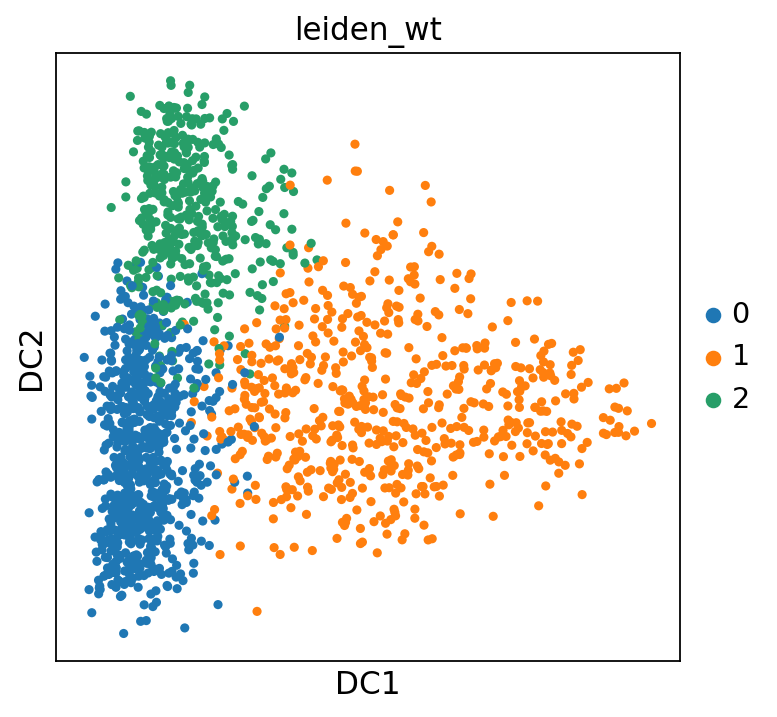

In [98]:
rcParams['figure.figsize']=(5,5)
sc.pl.diffmap(adata_hepz_wt, color='leiden_wt',
              save = today + '_leiden-wt_C57Bl6J_DPT_thresholded.pdf'
             )

In [102]:
pd.crosstab(adata_hepz_wt.obs['leiden'], adata_hepz_wt.obs['leiden_wt'], normalize=0)

leiden_wt,0,1,2
leiden,,,
0,0.908333,0.056944,0.034722
1,0.001795,0.971275,0.026930
2,0.169043,0.054990,0.775967


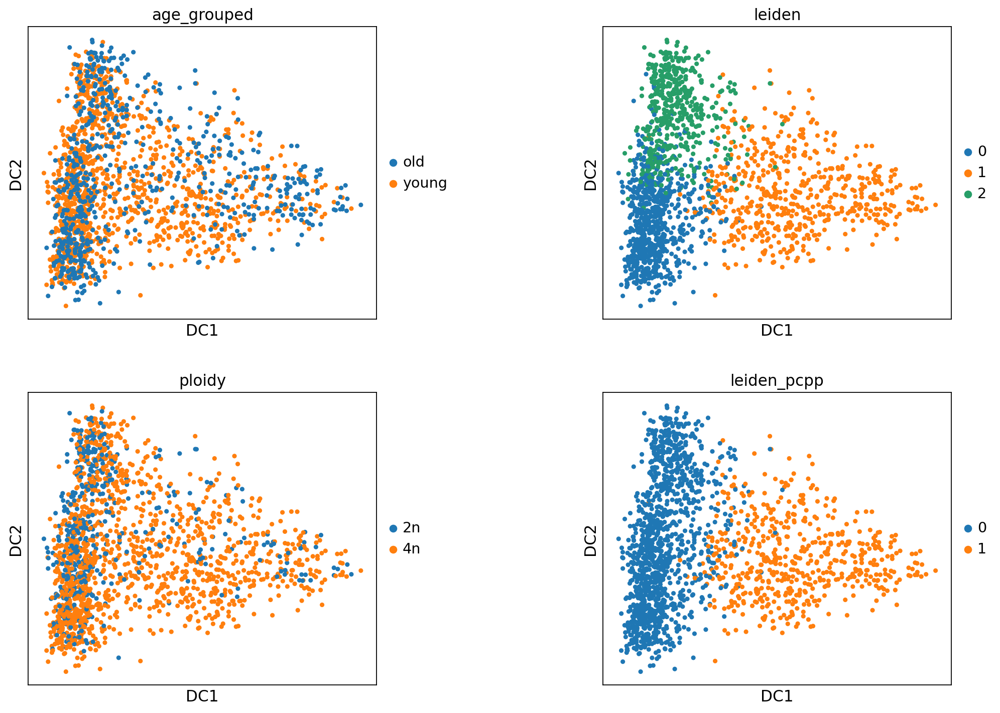

In [103]:
rcParams['figure.figsize']= (5,5)
sc.pl.diffmap(adata_hepz_wt, color=['age_grouped', 'leiden','ploidy', 'leiden_pcpp'],
              ncols=2, wspace=0.5, 
              save='_'+today+'_zonation_hepatocytes_C57Bl6J_overview_DC12_DPT_thresholded.pdf'
             )

### Cell type proportions

Here we compute the cell type proportions for the 2n and 4n hepatocytes in the periportal and pericentral zone. 

Please note that plate SNI-667 contains only 2n cells, all other plates are sorted 2n:4n in equal amounts. Therefore, we have to adapt the normalisation scheme to account for the increased number of 2n cells in SNI-667. Specifically, we normalise per `age group` (*i.e.* separately for young and old). The 2n cells in SNI-667 lead to an overpresentation of 2n cells each group. The plate SNI-667 contains only cells from the CEBPA KO, so the remaining strains will be normalised as usual. 

For the CEBPA KO, we have more 2n cells from SNI-667, therefore, we have to adapt the normalisation for 2n cells in the strain. 

In [110]:
zonation_df = adata_hepzDPT.obs[['age_grouped', 'strain', 'ploidy', 'leiden_pcpp']]

In [111]:
zonation_df['count'] = 1

<ipython-input-111-45f90e9ede86>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  zonation_df['count'] = 1


In [112]:
tmp = zonation_df.groupby(['age_grouped', 'strain', 'ploidy', 'leiden_pcpp']).sum()

In [115]:
tmp = tmp.reset_index()

In [108]:
tmp.to_csv(data_dir +today + '_zonation_counts+DPT_thresholded.csv')

In [116]:
tmp

,age_grouped,strain,ploidy,leiden_pcpp,count
0,old,C57Bl6/J,2n,0,118
1,old,C57Bl6/J,2n,1,31
2,old,C57Bl6/J,4n,0,320
3,old,C57Bl6/J,4n,1,169
4,old,CEBPA KO,2n,0,152
5,old,CEBPA KO,2n,1,9
6,old,CEBPA KO,4n,0,214
7,old,CEBPA KO,4n,1,71
8,old,CTCF KO,2n,0,75
9,old,CTCF KO,2n,1,20


In [118]:
tmp.loc[np.logical_and(tmp['ploidy']=='2n', 
                       tmp['strain']=='CEBPA KO')]['count'] = tmp.loc[np.logical_and(tmp['ploidy']=='2n', 
                                                                                          tmp['strain']=='CEBPA KO')]['count']*2/3

<ipython-input-118-30bd06f22ec2>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmp.loc[np.logical_and(tmp['ploidy']=='2n',


In [119]:
tmp2 = tmp.groupby(['age_grouped']).transform(lambda x: x *100/ x.sum())

In [120]:
tmp2[['ploidy','strain', 'age_grouped', 'leiden_pcpp']] = tmp[['ploidy','strain', 'age_grouped', 'leiden_pcpp']]

In [121]:
tmp2.to_csv(data_dir + today + '_zonation_proportions_DPT_thresholded.csv')